# Import relevant packages

In [1]:
# Manually add environment's bin dir to the path inside notebook to run tensorboard
import os
PATH = os.getenv('PATH')
%env PATH=/home/theghub/naureenk/.conda/envs/crev/bin:$PATH
    
# Magic command to load tensorboard extension
%load_ext tensorboard
# Mute TF 2.12 Bug Warnings (Before importing tensorflow)
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '2' 
import sys
# Appending the U-net package folder
sys.path.append("./src/")
import unet
#from unet import crevasse_data'
#from dataloader import DataLoader
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import losses, metrics
from tensorflow.keras.layers import Input, Conv2D, Dropout, MaxPooling2D, Activation, ReLU
from tensorflow.keras.layers import BatchNormalization, Conv2DTranspose, Concatenate
from tensorflow.keras.models import Model, Sequential
from IPython.display import Image, display
from tensorflow.keras.preprocessing.image import load_img
#keras.backend.set_image_data_format('channels_last')
import PIL
from PIL import ImageOps
print(f"Tensorflow ver. {tf.__version__}")

env: PATH=/home/theghub/naureenk/.conda/envs/crev/bin:/apps/jupyterlab70/r2/bin:/apps/share64/debian10/anaconda/anaconda-7/bin:/bin:/usr/bin:/usr/bin/X11:/sbin:/usr/sbin
Tensorflow ver. 2.12.0


## Working TF input pipeline for U-Net

In [2]:
IMG_SIZE = (512,512)
#function to read image and mask from file
def read_image(image_name):
    image = tf.io.read_file(image_name)
    image = tf.image.decode_png(image, channels=1)
    image = tf.image.resize(image, IMG_SIZE)
    image = tf.cast(image, tf.float32)/255.0
    return image
    
def read_mask(mask_name):    
    mask = tf.io.read_file(mask_name)
    mask = tf.image.decode_png(mask, channels=1)
    mask = tf.image.resize(mask, IMG_SIZE)
    mask = tf.cast(mask, tf.uint8)
    return mask

# data_augmentation = tf.keras.Sequential([
#   tf.keras.layers.experimental.preprocessing.RandomFlip("horizontal"),
#   tf.keras.layers.experimental.preprocessing.RandomRotation(0.25),
#   tf.keras.layers.experimental.preprocessing.RandomContrast(0.1)],
#   )

# Create TRAIN TF dataset of Images and Labels separately and then map the files to stream of images and labels
train_image_dataset = tf.data.Dataset.list_files("./gris/Images_HH_median/Train/*.png", shuffle=False)
train_image_dataset = train_image_dataset.map(read_image, num_parallel_calls=tf.data.AUTOTUNE)
train_label_dataset = tf.data.Dataset.list_files("./gris/Labels_512/Train/*.png", shuffle=False)
train_label_dataset = train_label_dataset.map(read_mask, num_parallel_calls=tf.data.AUTOTUNE)
# Combine both datasets
train_ds = tf.data.Dataset.zip((train_image_dataset,train_label_dataset))
# Add data augmentation
#train_ds = train_ds.map(lambda x, y: (data_augmentation(x, training=True), y), num_parallel_calls=tf.data.AUTOTUNE)

# Create VALIDATION TF dataset of Images and Labels separately and then map the files to stream of images and labels
valid_image_dataset = tf.data.Dataset.list_files("./gris/Images_HH_median/Valid/*.png", shuffle=False)
valid_image_dataset = valid_image_dataset.map(read_image, num_parallel_calls=tf.data.AUTOTUNE)
valid_label_dataset = tf.data.Dataset.list_files("./gris/Labels_512/Valid/*.png", shuffle=False)
valid_label_dataset = valid_label_dataset.map(read_mask, num_parallel_calls=tf.data.AUTOTUNE)
# Combine both datasets
valid_ds = tf.data.Dataset.zip((valid_image_dataset,valid_label_dataset))
#for element in train_ds:
#    print(element)


## Build unet model with parameters

In [3]:
#LEARNING_RATE = 0.005
unet_model = unet.build_model(nx = 512, ny = 512,
                              channels=1,
                              num_classes=3,
                              layer_depth=3,
                              filters_root=16,
                              pool_size=2,
                              dropout_rate=0.1,
                              padding="same",
                              activation="relu",
                              kernel_initializer='glorot_uniform',
                              kernel_regularizer=tf.keras.regularizers.L1L2(l1=0.0, l2=0.01)
)

unet.finalize_model(unet_model,
                    loss=losses.SparseCategoricalCrossentropy(from_logits=False),
                    optimizer=tf.keras.optimizers.experimental.SGD(learning_rate=0.05, momentum=0.1),
                    #optimizer=tf.keras.optimizers.Adam(learning_rate=0.001, epsilon=0.001),
                    metrics=[tf.keras.metrics.SparseCategoricalAccuracy(),
                            tf.keras.metrics.IoU(num_classes=3,target_class_ids=[1],ignore_class=0)],
                    dice_coefficient=True,
                    mean_iou=True,
                    auc=False,
                    learning_rate=None)
#unet_model.summary()

Model: "unet"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 inputs (InputLayer)            [(None, 512, 512, 1  0           []                               
                                )]                                                                
                                                                                                  
 conv_block (ConvBlock)         (None, 512, 512, 16  2480        ['inputs[0][0]']                 
                                )                                                                 
                                                                                                  
 max_pooling2d (MaxPooling2D)   (None, 256, 256, 16  0           ['conv_block[0][0]']             
                                )                                                              

In [4]:
# To suppress unnecessary warnings
from absl import logging
logging.set_verbosity(logging.ERROR)

#callbacks = [tf.keras.callbacks.EarlyStopping(patience=3, monitor='val_loss'),
             #tf.keras.callbacks.TensorBoard(log_dir='3class_unet_8/28')]
trainer = unet.Trainer(name="crevasse_data", tensorboard_images_callback=False)
trainer.fit(unet_model,
            train_dataset = train_ds,
            validation_dataset = valid_ds,
            epochs=400,
            batch_size=1)

1/1 [==============================] - 0s 458ms/step
Epoch 1/400
20/20 [==============================] - ETA: 0s - loss: 1.0135 - sparse_categorical_accuracy: 0.6815 - io_u: 0.0000e+00 - mean_iou: 0.2657 - dice_coefficient: 0.5756INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 13s 556ms/step - loss: 1.0135 - sparse_categorical_accuracy: 0.6815 - io_u: 0.0000e+00 - mean_iou: 0.2657 - dice_coefficient: 0.5756 - val_loss: 0.9279 - val_sparse_categorical_accuracy: 0.6922 - val_io_u: 0.0000e+00 - val_mean_iou: 0.2779 - val_dice_coefficient: 0.5952 - learning_rate: 0.0500
Epoch 2/400
20/20 [==============================] - ETA: 0s - loss: 0.8753 - sparse_categorical_accuracy: 0.7053 - io_u: 0.0000e+00 - mean_iou: 0.2760 - dice_coefficient: 0.5847INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 523ms/step - loss: 0.8753 - sparse_categorical_accuracy: 0.7053 - io_u: 0.0000e+00 - mean_iou: 0.2760 - dice_coefficient: 0.5847 - val_loss: 0.8499 - val_sparse_categorical_accuracy: 0.6922 - val_io_u: 0.0000e+00 - val_mean_iou: 0.2855 - val_dice_coefficient: 0.6022 - learning_rate: 0.0500
Epoch 3/400
20/20 [==============================] - ETA: 0s - loss: 0.8272 - sparse_categorical_accuracy: 0.7053 - io_u: 0.0000e+00 - mean_iou: 0.2807 - dice_coefficient: 0.5890INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 11s 547ms/step - loss: 0.8272 - sparse_categorical_accuracy: 0.7053 - io_u: 0.0000e+00 - mean_iou: 0.2807 - dice_coefficient: 0.5890 - val_loss: 0.8312 - val_sparse_categorical_accuracy: 0.6922 - val_io_u: 0.0000e+00 - val_mean_iou: 0.2877 - val_dice_coefficient: 0.6039 - learning_rate: 0.0500
Epoch 4/400
20/20 [==============================] - ETA: 0s - loss: 0.8135 - sparse_categorical_accuracy: 0.7053 - io_u: 0.0000e+00 - mean_iou: 0.2814 - dice_coefficient: 0.5893INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 11s 543ms/step - loss: 0.8135 - sparse_categorical_accuracy: 0.7053 - io_u: 0.0000e+00 - mean_iou: 0.2814 - dice_coefficient: 0.5893 - val_loss: 0.8190 - val_sparse_categorical_accuracy: 0.6922 - val_io_u: 0.0000e+00 - val_mean_iou: 0.2864 - val_dice_coefficient: 0.6016 - learning_rate: 0.0500
Epoch 5/400
20/20 [==============================] - ETA: 0s - loss: 0.7953 - sparse_categorical_accuracy: 0.7053 - io_u: 0.0000e+00 - mean_iou: 0.2793 - dice_coefficient: 0.5860INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 11s 544ms/step - loss: 0.7953 - sparse_categorical_accuracy: 0.7053 - io_u: 0.0000e+00 - mean_iou: 0.2793 - dice_coefficient: 0.5860 - val_loss: 0.7875 - val_sparse_categorical_accuracy: 0.6922 - val_io_u: 0.0000e+00 - val_mean_iou: 0.2814 - val_dice_coefficient: 0.5935 - learning_rate: 0.0500
Epoch 6/400
20/20 [==============================] - ETA: 0s - loss: 0.7579 - sparse_categorical_accuracy: 0.7054 - io_u: 0.0000e+00 - mean_iou: 0.2741 - dice_coefficient: 0.5775INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 11s 571ms/step - loss: 0.7579 - sparse_categorical_accuracy: 0.7054 - io_u: 0.0000e+00 - mean_iou: 0.2741 - dice_coefficient: 0.5775 - val_loss: 0.7231 - val_sparse_categorical_accuracy: 0.6922 - val_io_u: 0.0000e+00 - val_mean_iou: 0.2764 - val_dice_coefficient: 0.5830 - learning_rate: 0.0500
Epoch 7/400
20/20 [==============================] - ETA: 0s - loss: 0.7173 - sparse_categorical_accuracy: 0.7078 - io_u: 0.0000e+00 - mean_iou: 0.2685 - dice_coefficient: 0.5674INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 11s 530ms/step - loss: 0.7173 - sparse_categorical_accuracy: 0.7078 - io_u: 0.0000e+00 - mean_iou: 0.2685 - dice_coefficient: 0.5674 - val_loss: 0.6838 - val_sparse_categorical_accuracy: 0.6922 - val_io_u: 0.0000e+00 - val_mean_iou: 0.2766 - val_dice_coefficient: 0.5802 - learning_rate: 0.0500
Epoch 8/400
20/20 [==============================] - ETA: 0s - loss: 0.7003 - sparse_categorical_accuracy: 0.7122 - io_u: 0.0000e+00 - mean_iou: 0.2657 - dice_coefficient: 0.5618INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 11s 559ms/step - loss: 0.7003 - sparse_categorical_accuracy: 0.7122 - io_u: 0.0000e+00 - mean_iou: 0.2657 - dice_coefficient: 0.5618 - val_loss: 0.6672 - val_sparse_categorical_accuracy: 0.6924 - val_io_u: 0.0000e+00 - val_mean_iou: 0.2748 - val_dice_coefficient: 0.5757 - learning_rate: 0.0500
Epoch 9/400
20/20 [==============================] - ETA: 0s - loss: 0.6878 - sparse_categorical_accuracy: 0.7319 - io_u: 0.0000e+00 - mean_iou: 0.2658 - dice_coefficient: 0.5605INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 11s 577ms/step - loss: 0.6878 - sparse_categorical_accuracy: 0.7319 - io_u: 0.0000e+00 - mean_iou: 0.2658 - dice_coefficient: 0.5605 - val_loss: 0.6603 - val_sparse_categorical_accuracy: 0.7524 - val_io_u: 0.0000e+00 - val_mean_iou: 0.2791 - val_dice_coefficient: 0.5807 - learning_rate: 0.0500
Epoch 10/400
20/20 [==============================] - 8s 423ms/step - loss: 0.6715 - sparse_categorical_accuracy: 0.7504 - io_u: 0.0000e+00 - mean_iou: 0.2731 - dice_coefficient: 0.5693 - val_loss: 0.6657 - val_sparse_categorical_accuracy: 0.7607 - val_io_u: 0.0000e+00 - val_mean_iou: 0.2859 - val_dice_coefficient: 0.5898 - learning_rate: 0.0500
Epoch 11/400
20/20 [==============================] - ETA: 0s - loss: 0.6603 - sparse_categorical_accuracy: 0.7528 - io_u: 0.0000e+00 - mean_iou: 0.2796 - dice_coefficient: 0.5774INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 11s 536ms/step - loss: 0.6603 - sparse_categorical_accuracy: 0.7528 - io_u: 0.0000e+00 - mean_iou: 0.2796 - dice_coefficient: 0.5774 - val_loss: 0.6052 - val_sparse_categorical_accuracy: 0.7858 - val_io_u: 0.0000e+00 - val_mean_iou: 0.2898 - val_dice_coefficient: 0.5937 - learning_rate: 0.0500
Epoch 12/400
20/20 [==============================] - ETA: 0s - loss: 0.6463 - sparse_categorical_accuracy: 0.7570 - io_u: 0.0000e+00 - mean_iou: 0.2857 - dice_coefficient: 0.5850INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 11s 535ms/step - loss: 0.6463 - sparse_categorical_accuracy: 0.7570 - io_u: 0.0000e+00 - mean_iou: 0.2857 - dice_coefficient: 0.5850 - val_loss: 0.5751 - val_sparse_categorical_accuracy: 0.7974 - val_io_u: 0.0000e+00 - val_mean_iou: 0.2957 - val_dice_coefficient: 0.6012 - learning_rate: 0.0500
Epoch 13/400
20/20 [==============================] - ETA: 0s - loss: 0.6327 - sparse_categorical_accuracy: 0.7606 - io_u: 0.0000e+00 - mean_iou: 0.2912 - dice_coefficient: 0.5919INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 530ms/step - loss: 0.6327 - sparse_categorical_accuracy: 0.7606 - io_u: 0.0000e+00 - mean_iou: 0.2912 - dice_coefficient: 0.5919 - val_loss: 0.5616 - val_sparse_categorical_accuracy: 0.8014 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3007 - val_dice_coefficient: 0.6079 - learning_rate: 0.0500
Epoch 14/400
20/20 [==============================] - ETA: 0s - loss: 0.6223 - sparse_categorical_accuracy: 0.7642 - io_u: 0.0000e+00 - mean_iou: 0.2957 - dice_coefficient: 0.5974INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 11s 562ms/step - loss: 0.6223 - sparse_categorical_accuracy: 0.7642 - io_u: 0.0000e+00 - mean_iou: 0.2957 - dice_coefficient: 0.5974 - val_loss: 0.5534 - val_sparse_categorical_accuracy: 0.8034 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3051 - val_dice_coefficient: 0.6137 - learning_rate: 0.0500
Epoch 15/400
20/20 [==============================] - ETA: 0s - loss: 0.6145 - sparse_categorical_accuracy: 0.7674 - io_u: 0.0000e+00 - mean_iou: 0.2992 - dice_coefficient: 0.6018INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 505ms/step - loss: 0.6145 - sparse_categorical_accuracy: 0.7674 - io_u: 0.0000e+00 - mean_iou: 0.2992 - dice_coefficient: 0.6018 - val_loss: 0.5469 - val_sparse_categorical_accuracy: 0.8052 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3090 - val_dice_coefficient: 0.6188 - learning_rate: 0.0500
Epoch 16/400
20/20 [==============================] - ETA: 0s - loss: 0.6082 - sparse_categorical_accuracy: 0.7701 - io_u: 0.0000e+00 - mean_iou: 0.3024 - dice_coefficient: 0.6057INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 498ms/step - loss: 0.6082 - sparse_categorical_accuracy: 0.7701 - io_u: 0.0000e+00 - mean_iou: 0.3024 - dice_coefficient: 0.6057 - val_loss: 0.5417 - val_sparse_categorical_accuracy: 0.8068 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3126 - val_dice_coefficient: 0.6235 - learning_rate: 0.0500
Epoch 17/400
20/20 [==============================] - ETA: 0s - loss: 0.6030 - sparse_categorical_accuracy: 0.7726 - io_u: 0.0000e+00 - mean_iou: 0.3052 - dice_coefficient: 0.6091INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 500ms/step - loss: 0.6030 - sparse_categorical_accuracy: 0.7726 - io_u: 0.0000e+00 - mean_iou: 0.3052 - dice_coefficient: 0.6091 - val_loss: 0.5369 - val_sparse_categorical_accuracy: 0.8084 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3160 - val_dice_coefficient: 0.6279 - learning_rate: 0.0500
Epoch 18/400
20/20 [==============================] - ETA: 0s - loss: 0.5989 - sparse_categorical_accuracy: 0.7743 - io_u: 0.0000e+00 - mean_iou: 0.3077 - dice_coefficient: 0.6121INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 489ms/step - loss: 0.5989 - sparse_categorical_accuracy: 0.7743 - io_u: 0.0000e+00 - mean_iou: 0.3077 - dice_coefficient: 0.6121 - val_loss: 0.5326 - val_sparse_categorical_accuracy: 0.8101 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3195 - val_dice_coefficient: 0.6324 - learning_rate: 0.0500
Epoch 19/400
20/20 [==============================] - ETA: 0s - loss: 0.5953 - sparse_categorical_accuracy: 0.7760 - io_u: 0.0000e+00 - mean_iou: 0.3101 - dice_coefficient: 0.6151INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 11s 546ms/step - loss: 0.5953 - sparse_categorical_accuracy: 0.7760 - io_u: 0.0000e+00 - mean_iou: 0.3101 - dice_coefficient: 0.6151 - val_loss: 0.5299 - val_sparse_categorical_accuracy: 0.8111 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3226 - val_dice_coefficient: 0.6364 - learning_rate: 0.0500
Epoch 20/400
20/20 [==============================] - ETA: 0s - loss: 0.5926 - sparse_categorical_accuracy: 0.7771 - io_u: 0.0000e+00 - mean_iou: 0.3124 - dice_coefficient: 0.6179INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 11s 537ms/step - loss: 0.5926 - sparse_categorical_accuracy: 0.7771 - io_u: 0.0000e+00 - mean_iou: 0.3124 - dice_coefficient: 0.6179 - val_loss: 0.5273 - val_sparse_categorical_accuracy: 0.8120 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3258 - val_dice_coefficient: 0.6404 - learning_rate: 0.0500
Epoch 21/400
20/20 [==============================] - ETA: 0s - loss: 0.5902 - sparse_categorical_accuracy: 0.7780 - io_u: 0.0000e+00 - mean_iou: 0.3145 - dice_coefficient: 0.6204INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 524ms/step - loss: 0.5902 - sparse_categorical_accuracy: 0.7780 - io_u: 0.0000e+00 - mean_iou: 0.3145 - dice_coefficient: 0.6204 - val_loss: 0.5249 - val_sparse_categorical_accuracy: 0.8130 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3288 - val_dice_coefficient: 0.6441 - learning_rate: 0.0500
Epoch 22/400
20/20 [==============================] - ETA: 0s - loss: 0.5877 - sparse_categorical_accuracy: 0.7790 - io_u: 0.0000e+00 - mean_iou: 0.3166 - dice_coefficient: 0.6228INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 513ms/step - loss: 0.5877 - sparse_categorical_accuracy: 0.7790 - io_u: 0.0000e+00 - mean_iou: 0.3166 - dice_coefficient: 0.6228 - val_loss: 0.5230 - val_sparse_categorical_accuracy: 0.8139 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3318 - val_dice_coefficient: 0.6478 - learning_rate: 0.0500
Epoch 23/400
20/20 [==============================] - ETA: 0s - loss: 0.5857 - sparse_categorical_accuracy: 0.7800 - io_u: 0.0000e+00 - mean_iou: 0.3187 - dice_coefficient: 0.6252INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 501ms/step - loss: 0.5857 - sparse_categorical_accuracy: 0.7800 - io_u: 0.0000e+00 - mean_iou: 0.3187 - dice_coefficient: 0.6252 - val_loss: 0.5213 - val_sparse_categorical_accuracy: 0.8145 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3346 - val_dice_coefficient: 0.6512 - learning_rate: 0.0500
Epoch 24/400
20/20 [==============================] - ETA: 0s - loss: 0.5840 - sparse_categorical_accuracy: 0.7807 - io_u: 0.0000e+00 - mean_iou: 0.3206 - dice_coefficient: 0.6274INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 521ms/step - loss: 0.5840 - sparse_categorical_accuracy: 0.7807 - io_u: 0.0000e+00 - mean_iou: 0.3206 - dice_coefficient: 0.6274 - val_loss: 0.5199 - val_sparse_categorical_accuracy: 0.8148 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3373 - val_dice_coefficient: 0.6544 - learning_rate: 0.0500
Epoch 25/400
20/20 [==============================] - ETA: 0s - loss: 0.5819 - sparse_categorical_accuracy: 0.7812 - io_u: 0.0000e+00 - mean_iou: 0.3224 - dice_coefficient: 0.6295INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 11s 540ms/step - loss: 0.5819 - sparse_categorical_accuracy: 0.7812 - io_u: 0.0000e+00 - mean_iou: 0.3224 - dice_coefficient: 0.6295 - val_loss: 0.5185 - val_sparse_categorical_accuracy: 0.8153 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3398 - val_dice_coefficient: 0.6575 - learning_rate: 0.0500
Epoch 26/400
20/20 [==============================] - ETA: 0s - loss: 0.5806 - sparse_categorical_accuracy: 0.7819 - io_u: 0.0000e+00 - mean_iou: 0.3242 - dice_coefficient: 0.6315INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 11s 540ms/step - loss: 0.5806 - sparse_categorical_accuracy: 0.7819 - io_u: 0.0000e+00 - mean_iou: 0.3242 - dice_coefficient: 0.6315 - val_loss: 0.5173 - val_sparse_categorical_accuracy: 0.8157 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3423 - val_dice_coefficient: 0.6603 - learning_rate: 0.0500
Epoch 27/400
20/20 [==============================] - ETA: 0s - loss: 0.5790 - sparse_categorical_accuracy: 0.7826 - io_u: 0.0000e+00 - mean_iou: 0.3259 - dice_coefficient: 0.6334INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 505ms/step - loss: 0.5790 - sparse_categorical_accuracy: 0.7826 - io_u: 0.0000e+00 - mean_iou: 0.3259 - dice_coefficient: 0.6334 - val_loss: 0.5162 - val_sparse_categorical_accuracy: 0.8160 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3446 - val_dice_coefficient: 0.6631 - learning_rate: 0.0500
Epoch 28/400
20/20 [==============================] - ETA: 0s - loss: 0.5777 - sparse_categorical_accuracy: 0.7830 - io_u: 0.0000e+00 - mean_iou: 0.3274 - dice_coefficient: 0.6351INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 530ms/step - loss: 0.5777 - sparse_categorical_accuracy: 0.7830 - io_u: 0.0000e+00 - mean_iou: 0.3274 - dice_coefficient: 0.6351 - val_loss: 0.5153 - val_sparse_categorical_accuracy: 0.8163 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3467 - val_dice_coefficient: 0.6655 - learning_rate: 0.0500
Epoch 29/400
20/20 [==============================] - ETA: 0s - loss: 0.5765 - sparse_categorical_accuracy: 0.7835 - io_u: 0.0000e+00 - mean_iou: 0.3288 - dice_coefficient: 0.6367INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 11s 543ms/step - loss: 0.5765 - sparse_categorical_accuracy: 0.7835 - io_u: 0.0000e+00 - mean_iou: 0.3288 - dice_coefficient: 0.6367 - val_loss: 0.5144 - val_sparse_categorical_accuracy: 0.8164 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3486 - val_dice_coefficient: 0.6676 - learning_rate: 0.0500
Epoch 30/400
20/20 [==============================] - ETA: 0s - loss: 0.5750 - sparse_categorical_accuracy: 0.7840 - io_u: 0.0000e+00 - mean_iou: 0.3302 - dice_coefficient: 0.6381INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 11s 561ms/step - loss: 0.5750 - sparse_categorical_accuracy: 0.7840 - io_u: 0.0000e+00 - mean_iou: 0.3302 - dice_coefficient: 0.6381 - val_loss: 0.5135 - val_sparse_categorical_accuracy: 0.8166 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3503 - val_dice_coefficient: 0.6696 - learning_rate: 0.0500
Epoch 31/400
20/20 [==============================] - ETA: 0s - loss: 0.5739 - sparse_categorical_accuracy: 0.7845 - io_u: 0.0000e+00 - mean_iou: 0.3313 - dice_coefficient: 0.6394INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 493ms/step - loss: 0.5739 - sparse_categorical_accuracy: 0.7845 - io_u: 0.0000e+00 - mean_iou: 0.3313 - dice_coefficient: 0.6394 - val_loss: 0.5128 - val_sparse_categorical_accuracy: 0.8166 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3517 - val_dice_coefficient: 0.6712 - learning_rate: 0.0500
Epoch 32/400
20/20 [==============================] - ETA: 0s - loss: 0.5729 - sparse_categorical_accuracy: 0.7848 - io_u: 0.0000e+00 - mean_iou: 0.3324 - dice_coefficient: 0.6406INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 506ms/step - loss: 0.5729 - sparse_categorical_accuracy: 0.7848 - io_u: 0.0000e+00 - mean_iou: 0.3324 - dice_coefficient: 0.6406 - val_loss: 0.5120 - val_sparse_categorical_accuracy: 0.8167 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3531 - val_dice_coefficient: 0.6727 - learning_rate: 0.0500
Epoch 33/400
20/20 [==============================] - ETA: 0s - loss: 0.5719 - sparse_categorical_accuracy: 0.7852 - io_u: 0.0000e+00 - mean_iou: 0.3334 - dice_coefficient: 0.6417INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 506ms/step - loss: 0.5719 - sparse_categorical_accuracy: 0.7852 - io_u: 0.0000e+00 - mean_iou: 0.3334 - dice_coefficient: 0.6417 - val_loss: 0.5114 - val_sparse_categorical_accuracy: 0.8167 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3543 - val_dice_coefficient: 0.6741 - learning_rate: 0.0500
Epoch 34/400
20/20 [==============================] - ETA: 0s - loss: 0.5708 - sparse_categorical_accuracy: 0.7857 - io_u: 0.0000e+00 - mean_iou: 0.3343 - dice_coefficient: 0.6427INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 486ms/step - loss: 0.5708 - sparse_categorical_accuracy: 0.7857 - io_u: 0.0000e+00 - mean_iou: 0.3343 - dice_coefficient: 0.6427 - val_loss: 0.5108 - val_sparse_categorical_accuracy: 0.8167 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3553 - val_dice_coefficient: 0.6752 - learning_rate: 0.0500
Epoch 35/400
20/20 [==============================] - ETA: 0s - loss: 0.5700 - sparse_categorical_accuracy: 0.7861 - io_u: 0.0000e+00 - mean_iou: 0.3352 - dice_coefficient: 0.6436INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 489ms/step - loss: 0.5700 - sparse_categorical_accuracy: 0.7861 - io_u: 0.0000e+00 - mean_iou: 0.3352 - dice_coefficient: 0.6436 - val_loss: 0.5102 - val_sparse_categorical_accuracy: 0.8167 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3562 - val_dice_coefficient: 0.6762 - learning_rate: 0.0500
Epoch 36/400
20/20 [==============================] - ETA: 0s - loss: 0.5691 - sparse_categorical_accuracy: 0.7866 - io_u: 0.0000e+00 - mean_iou: 0.3358 - dice_coefficient: 0.6443INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 476ms/step - loss: 0.5691 - sparse_categorical_accuracy: 0.7866 - io_u: 0.0000e+00 - mean_iou: 0.3358 - dice_coefficient: 0.6443 - val_loss: 0.5097 - val_sparse_categorical_accuracy: 0.8167 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3571 - val_dice_coefficient: 0.6771 - learning_rate: 0.0500
Epoch 37/400
20/20 [==============================] - ETA: 0s - loss: 0.5684 - sparse_categorical_accuracy: 0.7864 - io_u: 0.0000e+00 - mean_iou: 0.3365 - dice_coefficient: 0.6450INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 498ms/step - loss: 0.5684 - sparse_categorical_accuracy: 0.7864 - io_u: 0.0000e+00 - mean_iou: 0.3365 - dice_coefficient: 0.6450 - val_loss: 0.5092 - val_sparse_categorical_accuracy: 0.8167 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3579 - val_dice_coefficient: 0.6780 - learning_rate: 0.0500
Epoch 38/400
20/20 [==============================] - ETA: 0s - loss: 0.5675 - sparse_categorical_accuracy: 0.7870 - io_u: 0.0000e+00 - mean_iou: 0.3370 - dice_coefficient: 0.6455INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 502ms/step - loss: 0.5675 - sparse_categorical_accuracy: 0.7870 - io_u: 0.0000e+00 - mean_iou: 0.3370 - dice_coefficient: 0.6455 - val_loss: 0.5087 - val_sparse_categorical_accuracy: 0.8166 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3586 - val_dice_coefficient: 0.6788 - learning_rate: 0.0500
Epoch 39/400
20/20 [==============================] - ETA: 0s - loss: 0.5665 - sparse_categorical_accuracy: 0.7874 - io_u: 0.0000e+00 - mean_iou: 0.3376 - dice_coefficient: 0.6461INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 503ms/step - loss: 0.5665 - sparse_categorical_accuracy: 0.7874 - io_u: 0.0000e+00 - mean_iou: 0.3376 - dice_coefficient: 0.6461 - val_loss: 0.5083 - val_sparse_categorical_accuracy: 0.8166 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3592 - val_dice_coefficient: 0.6793 - learning_rate: 0.0500
Epoch 40/400
20/20 [==============================] - ETA: 0s - loss: 0.5659 - sparse_categorical_accuracy: 0.7875 - io_u: 0.0000e+00 - mean_iou: 0.3381 - dice_coefficient: 0.6466INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 465ms/step - loss: 0.5659 - sparse_categorical_accuracy: 0.7875 - io_u: 0.0000e+00 - mean_iou: 0.3381 - dice_coefficient: 0.6466 - val_loss: 0.5078 - val_sparse_categorical_accuracy: 0.8166 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3598 - val_dice_coefficient: 0.6800 - learning_rate: 0.0500
Epoch 41/400
20/20 [==============================] - ETA: 0s - loss: 0.5651 - sparse_categorical_accuracy: 0.7879 - io_u: 0.0000e+00 - mean_iou: 0.3385 - dice_coefficient: 0.6471INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 479ms/step - loss: 0.5651 - sparse_categorical_accuracy: 0.7879 - io_u: 0.0000e+00 - mean_iou: 0.3385 - dice_coefficient: 0.6471 - val_loss: 0.5075 - val_sparse_categorical_accuracy: 0.8166 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3602 - val_dice_coefficient: 0.6805 - learning_rate: 0.0500
Epoch 42/400
20/20 [==============================] - ETA: 0s - loss: 0.5644 - sparse_categorical_accuracy: 0.7882 - io_u: 0.0000e+00 - mean_iou: 0.3389 - dice_coefficient: 0.6474INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 507ms/step - loss: 0.5644 - sparse_categorical_accuracy: 0.7882 - io_u: 0.0000e+00 - mean_iou: 0.3389 - dice_coefficient: 0.6474 - val_loss: 0.5071 - val_sparse_categorical_accuracy: 0.8165 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3607 - val_dice_coefficient: 0.6810 - learning_rate: 0.0500
Epoch 43/400
20/20 [==============================] - ETA: 0s - loss: 0.5637 - sparse_categorical_accuracy: 0.7884 - io_u: 0.0000e+00 - mean_iou: 0.3392 - dice_coefficient: 0.6477INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 503ms/step - loss: 0.5637 - sparse_categorical_accuracy: 0.7884 - io_u: 0.0000e+00 - mean_iou: 0.3392 - dice_coefficient: 0.6477 - val_loss: 0.5067 - val_sparse_categorical_accuracy: 0.8166 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3612 - val_dice_coefficient: 0.6814 - learning_rate: 0.0500
Epoch 44/400
20/20 [==============================] - ETA: 0s - loss: 0.5629 - sparse_categorical_accuracy: 0.7889 - io_u: 0.0000e+00 - mean_iou: 0.3396 - dice_coefficient: 0.6481INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 494ms/step - loss: 0.5629 - sparse_categorical_accuracy: 0.7889 - io_u: 0.0000e+00 - mean_iou: 0.3396 - dice_coefficient: 0.6481 - val_loss: 0.5063 - val_sparse_categorical_accuracy: 0.8165 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3616 - val_dice_coefficient: 0.6818 - learning_rate: 0.0500
Epoch 45/400
20/20 [==============================] - ETA: 0s - loss: 0.5623 - sparse_categorical_accuracy: 0.7891 - io_u: 0.0000e+00 - mean_iou: 0.3399 - dice_coefficient: 0.6483INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 488ms/step - loss: 0.5623 - sparse_categorical_accuracy: 0.7891 - io_u: 0.0000e+00 - mean_iou: 0.3399 - dice_coefficient: 0.6483 - val_loss: 0.5059 - val_sparse_categorical_accuracy: 0.8167 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3618 - val_dice_coefficient: 0.6820 - learning_rate: 0.0500
Epoch 46/400
20/20 [==============================] - ETA: 0s - loss: 0.5616 - sparse_categorical_accuracy: 0.7893 - io_u: 0.0000e+00 - mean_iou: 0.3401 - dice_coefficient: 0.6486INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 485ms/step - loss: 0.5616 - sparse_categorical_accuracy: 0.7893 - io_u: 0.0000e+00 - mean_iou: 0.3401 - dice_coefficient: 0.6486 - val_loss: 0.5055 - val_sparse_categorical_accuracy: 0.8167 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3621 - val_dice_coefficient: 0.6824 - learning_rate: 0.0500
Epoch 47/400
20/20 [==============================] - ETA: 0s - loss: 0.5611 - sparse_categorical_accuracy: 0.7895 - io_u: 0.0000e+00 - mean_iou: 0.3403 - dice_coefficient: 0.6488INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 475ms/step - loss: 0.5611 - sparse_categorical_accuracy: 0.7895 - io_u: 0.0000e+00 - mean_iou: 0.3403 - dice_coefficient: 0.6488 - val_loss: 0.5052 - val_sparse_categorical_accuracy: 0.8168 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3623 - val_dice_coefficient: 0.6826 - learning_rate: 0.0500
Epoch 48/400
20/20 [==============================] - ETA: 0s - loss: 0.5603 - sparse_categorical_accuracy: 0.7898 - io_u: 0.0000e+00 - mean_iou: 0.3406 - dice_coefficient: 0.6490INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 505ms/step - loss: 0.5603 - sparse_categorical_accuracy: 0.7898 - io_u: 0.0000e+00 - mean_iou: 0.3406 - dice_coefficient: 0.6490 - val_loss: 0.5049 - val_sparse_categorical_accuracy: 0.8167 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3627 - val_dice_coefficient: 0.6829 - learning_rate: 0.0500
Epoch 49/400
20/20 [==============================] - ETA: 0s - loss: 0.5596 - sparse_categorical_accuracy: 0.7903 - io_u: 0.0000e+00 - mean_iou: 0.3409 - dice_coefficient: 0.6493INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 468ms/step - loss: 0.5596 - sparse_categorical_accuracy: 0.7903 - io_u: 0.0000e+00 - mean_iou: 0.3409 - dice_coefficient: 0.6493 - val_loss: 0.5045 - val_sparse_categorical_accuracy: 0.8168 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3628 - val_dice_coefficient: 0.6830 - learning_rate: 0.0500
Epoch 50/400
20/20 [==============================] - ETA: 0s - loss: 0.5590 - sparse_categorical_accuracy: 0.7905 - io_u: 0.0000e+00 - mean_iou: 0.3410 - dice_coefficient: 0.6494INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 492ms/step - loss: 0.5590 - sparse_categorical_accuracy: 0.7905 - io_u: 0.0000e+00 - mean_iou: 0.3410 - dice_coefficient: 0.6494 - val_loss: 0.5042 - val_sparse_categorical_accuracy: 0.8169 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3630 - val_dice_coefficient: 0.6832 - learning_rate: 0.0500
Epoch 51/400
20/20 [==============================] - ETA: 0s - loss: 0.5584 - sparse_categorical_accuracy: 0.7906 - io_u: 0.0000e+00 - mean_iou: 0.3412 - dice_coefficient: 0.6496INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 491ms/step - loss: 0.5584 - sparse_categorical_accuracy: 0.7906 - io_u: 0.0000e+00 - mean_iou: 0.3412 - dice_coefficient: 0.6496 - val_loss: 0.5038 - val_sparse_categorical_accuracy: 0.8169 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3632 - val_dice_coefficient: 0.6833 - learning_rate: 0.0500
Epoch 52/400
20/20 [==============================] - ETA: 0s - loss: 0.5580 - sparse_categorical_accuracy: 0.7907 - io_u: 0.0000e+00 - mean_iou: 0.3413 - dice_coefficient: 0.6497INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 491ms/step - loss: 0.5580 - sparse_categorical_accuracy: 0.7907 - io_u: 0.0000e+00 - mean_iou: 0.3413 - dice_coefficient: 0.6497 - val_loss: 0.5036 - val_sparse_categorical_accuracy: 0.8170 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3633 - val_dice_coefficient: 0.6834 - learning_rate: 0.0500
Epoch 53/400
20/20 [==============================] - ETA: 0s - loss: 0.5571 - sparse_categorical_accuracy: 0.7912 - io_u: 0.0000e+00 - mean_iou: 0.3416 - dice_coefficient: 0.6499INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 471ms/step - loss: 0.5571 - sparse_categorical_accuracy: 0.7912 - io_u: 0.0000e+00 - mean_iou: 0.3416 - dice_coefficient: 0.6499 - val_loss: 0.5032 - val_sparse_categorical_accuracy: 0.8171 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3634 - val_dice_coefficient: 0.6835 - learning_rate: 0.0500
Epoch 54/400
20/20 [==============================] - ETA: 0s - loss: 0.5570 - sparse_categorical_accuracy: 0.7911 - io_u: 0.0000e+00 - mean_iou: 0.3416 - dice_coefficient: 0.6499INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 477ms/step - loss: 0.5570 - sparse_categorical_accuracy: 0.7911 - io_u: 0.0000e+00 - mean_iou: 0.3416 - dice_coefficient: 0.6499 - val_loss: 0.5030 - val_sparse_categorical_accuracy: 0.8172 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3635 - val_dice_coefficient: 0.6836 - learning_rate: 0.0500
Epoch 55/400
20/20 [==============================] - ETA: 0s - loss: 0.5563 - sparse_categorical_accuracy: 0.7914 - io_u: 0.0000e+00 - mean_iou: 0.3418 - dice_coefficient: 0.6501INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 506ms/step - loss: 0.5563 - sparse_categorical_accuracy: 0.7914 - io_u: 0.0000e+00 - mean_iou: 0.3418 - dice_coefficient: 0.6501 - val_loss: 0.5026 - val_sparse_categorical_accuracy: 0.8172 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3636 - val_dice_coefficient: 0.6837 - learning_rate: 0.0500
Epoch 56/400
20/20 [==============================] - ETA: 0s - loss: 0.5558 - sparse_categorical_accuracy: 0.7917 - io_u: 0.0000e+00 - mean_iou: 0.3419 - dice_coefficient: 0.6501INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 505ms/step - loss: 0.5558 - sparse_categorical_accuracy: 0.7917 - io_u: 0.0000e+00 - mean_iou: 0.3419 - dice_coefficient: 0.6501 - val_loss: 0.5024 - val_sparse_categorical_accuracy: 0.8173 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3637 - val_dice_coefficient: 0.6837 - learning_rate: 0.0500
Epoch 57/400
20/20 [==============================] - ETA: 0s - loss: 0.5553 - sparse_categorical_accuracy: 0.7919 - io_u: 0.0000e+00 - mean_iou: 0.3420 - dice_coefficient: 0.6502INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 499ms/step - loss: 0.5553 - sparse_categorical_accuracy: 0.7919 - io_u: 0.0000e+00 - mean_iou: 0.3420 - dice_coefficient: 0.6502 - val_loss: 0.5021 - val_sparse_categorical_accuracy: 0.8174 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3637 - val_dice_coefficient: 0.6837 - learning_rate: 0.0500
Epoch 58/400
20/20 [==============================] - ETA: 0s - loss: 0.5547 - sparse_categorical_accuracy: 0.7922 - io_u: 0.0000e+00 - mean_iou: 0.3421 - dice_coefficient: 0.6503INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 481ms/step - loss: 0.5547 - sparse_categorical_accuracy: 0.7922 - io_u: 0.0000e+00 - mean_iou: 0.3421 - dice_coefficient: 0.6503 - val_loss: 0.5018 - val_sparse_categorical_accuracy: 0.8175 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3639 - val_dice_coefficient: 0.6838 - learning_rate: 0.0500
Epoch 59/400
20/20 [==============================] - ETA: 0s - loss: 0.5543 - sparse_categorical_accuracy: 0.7923 - io_u: 0.0000e+00 - mean_iou: 0.3421 - dice_coefficient: 0.6504INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 493ms/step - loss: 0.5543 - sparse_categorical_accuracy: 0.7923 - io_u: 0.0000e+00 - mean_iou: 0.3421 - dice_coefficient: 0.6504 - val_loss: 0.5015 - val_sparse_categorical_accuracy: 0.8177 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3638 - val_dice_coefficient: 0.6838 - learning_rate: 0.0500
Epoch 60/400
20/20 [==============================] - ETA: 0s - loss: 0.5536 - sparse_categorical_accuracy: 0.7926 - io_u: 0.0000e+00 - mean_iou: 0.3423 - dice_coefficient: 0.6505INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 502ms/step - loss: 0.5536 - sparse_categorical_accuracy: 0.7926 - io_u: 0.0000e+00 - mean_iou: 0.3423 - dice_coefficient: 0.6505 - val_loss: 0.5013 - val_sparse_categorical_accuracy: 0.8177 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3639 - val_dice_coefficient: 0.6838 - learning_rate: 0.0500
Epoch 61/400
20/20 [==============================] - ETA: 0s - loss: 0.5529 - sparse_categorical_accuracy: 0.7930 - io_u: 0.0000e+00 - mean_iou: 0.3424 - dice_coefficient: 0.6506INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 522ms/step - loss: 0.5529 - sparse_categorical_accuracy: 0.7930 - io_u: 0.0000e+00 - mean_iou: 0.3424 - dice_coefficient: 0.6506 - val_loss: 0.5010 - val_sparse_categorical_accuracy: 0.8178 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3639 - val_dice_coefficient: 0.6838 - learning_rate: 0.0500
Epoch 62/400
20/20 [==============================] - ETA: 0s - loss: 0.5526 - sparse_categorical_accuracy: 0.7931 - io_u: 0.0000e+00 - mean_iou: 0.3424 - dice_coefficient: 0.6505INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 511ms/step - loss: 0.5526 - sparse_categorical_accuracy: 0.7931 - io_u: 0.0000e+00 - mean_iou: 0.3424 - dice_coefficient: 0.6505 - val_loss: 0.5007 - val_sparse_categorical_accuracy: 0.8179 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3638 - val_dice_coefficient: 0.6837 - learning_rate: 0.0500
Epoch 63/400
20/20 [==============================] - ETA: 0s - loss: 0.5522 - sparse_categorical_accuracy: 0.7932 - io_u: 0.0000e+00 - mean_iou: 0.3424 - dice_coefficient: 0.6505INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 481ms/step - loss: 0.5522 - sparse_categorical_accuracy: 0.7932 - io_u: 0.0000e+00 - mean_iou: 0.3424 - dice_coefficient: 0.6505 - val_loss: 0.5004 - val_sparse_categorical_accuracy: 0.8180 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3638 - val_dice_coefficient: 0.6837 - learning_rate: 0.0500
Epoch 64/400
20/20 [==============================] - ETA: 0s - loss: 0.5515 - sparse_categorical_accuracy: 0.7935 - io_u: 0.0000e+00 - mean_iou: 0.3425 - dice_coefficient: 0.6506INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 510ms/step - loss: 0.5515 - sparse_categorical_accuracy: 0.7935 - io_u: 0.0000e+00 - mean_iou: 0.3425 - dice_coefficient: 0.6506 - val_loss: 0.5002 - val_sparse_categorical_accuracy: 0.8181 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3638 - val_dice_coefficient: 0.6836 - learning_rate: 0.0500
Epoch 65/400
20/20 [==============================] - ETA: 0s - loss: 0.5511 - sparse_categorical_accuracy: 0.7937 - io_u: 0.0000e+00 - mean_iou: 0.3425 - dice_coefficient: 0.6506INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 525ms/step - loss: 0.5511 - sparse_categorical_accuracy: 0.7937 - io_u: 0.0000e+00 - mean_iou: 0.3425 - dice_coefficient: 0.6506 - val_loss: 0.5000 - val_sparse_categorical_accuracy: 0.8182 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3638 - val_dice_coefficient: 0.6836 - learning_rate: 0.0500
Epoch 66/400
20/20 [==============================] - ETA: 0s - loss: 0.5506 - sparse_categorical_accuracy: 0.7937 - io_u: 0.0000e+00 - mean_iou: 0.3425 - dice_coefficient: 0.6506INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 491ms/step - loss: 0.5506 - sparse_categorical_accuracy: 0.7937 - io_u: 0.0000e+00 - mean_iou: 0.3425 - dice_coefficient: 0.6506 - val_loss: 0.4997 - val_sparse_categorical_accuracy: 0.8183 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3638 - val_dice_coefficient: 0.6836 - learning_rate: 0.0500
Epoch 67/400
20/20 [==============================] - ETA: 0s - loss: 0.5500 - sparse_categorical_accuracy: 0.7941 - io_u: 0.0000e+00 - mean_iou: 0.3427 - dice_coefficient: 0.6507INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 516ms/step - loss: 0.5500 - sparse_categorical_accuracy: 0.7941 - io_u: 0.0000e+00 - mean_iou: 0.3427 - dice_coefficient: 0.6507 - val_loss: 0.4995 - val_sparse_categorical_accuracy: 0.8184 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3637 - val_dice_coefficient: 0.6835 - learning_rate: 0.0500
Epoch 68/400
20/20 [==============================] - ETA: 0s - loss: 0.5499 - sparse_categorical_accuracy: 0.7944 - io_u: 0.0000e+00 - mean_iou: 0.3427 - dice_coefficient: 0.6507INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 502ms/step - loss: 0.5499 - sparse_categorical_accuracy: 0.7944 - io_u: 0.0000e+00 - mean_iou: 0.3427 - dice_coefficient: 0.6507 - val_loss: 0.4992 - val_sparse_categorical_accuracy: 0.8185 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3637 - val_dice_coefficient: 0.6835 - learning_rate: 0.0500
Epoch 69/400
20/20 [==============================] - ETA: 0s - loss: 0.5493 - sparse_categorical_accuracy: 0.7944 - io_u: 0.0000e+00 - mean_iou: 0.3427 - dice_coefficient: 0.6508INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 509ms/step - loss: 0.5493 - sparse_categorical_accuracy: 0.7944 - io_u: 0.0000e+00 - mean_iou: 0.3427 - dice_coefficient: 0.6508 - val_loss: 0.4991 - val_sparse_categorical_accuracy: 0.8186 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3637 - val_dice_coefficient: 0.6834 - learning_rate: 0.0500
Epoch 70/400
20/20 [==============================] - ETA: 0s - loss: 0.5489 - sparse_categorical_accuracy: 0.7947 - io_u: 0.0000e+00 - mean_iou: 0.3427 - dice_coefficient: 0.6507INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 489ms/step - loss: 0.5489 - sparse_categorical_accuracy: 0.7947 - io_u: 0.0000e+00 - mean_iou: 0.3427 - dice_coefficient: 0.6507 - val_loss: 0.4988 - val_sparse_categorical_accuracy: 0.8187 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3637 - val_dice_coefficient: 0.6834 - learning_rate: 0.0500
Epoch 71/400
20/20 [==============================] - ETA: 0s - loss: 0.5482 - sparse_categorical_accuracy: 0.7949 - io_u: 0.0000e+00 - mean_iou: 0.3428 - dice_coefficient: 0.6508INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 473ms/step - loss: 0.5482 - sparse_categorical_accuracy: 0.7949 - io_u: 0.0000e+00 - mean_iou: 0.3428 - dice_coefficient: 0.6508 - val_loss: 0.4986 - val_sparse_categorical_accuracy: 0.8188 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3637 - val_dice_coefficient: 0.6834 - learning_rate: 0.0500
Epoch 72/400
20/20 [==============================] - ETA: 0s - loss: 0.5480 - sparse_categorical_accuracy: 0.7951 - io_u: 0.0000e+00 - mean_iou: 0.3428 - dice_coefficient: 0.6508INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 472ms/step - loss: 0.5480 - sparse_categorical_accuracy: 0.7951 - io_u: 0.0000e+00 - mean_iou: 0.3428 - dice_coefficient: 0.6508 - val_loss: 0.4984 - val_sparse_categorical_accuracy: 0.8189 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3636 - val_dice_coefficient: 0.6832 - learning_rate: 0.0500
Epoch 73/400
20/20 [==============================] - ETA: 0s - loss: 0.5476 - sparse_categorical_accuracy: 0.7953 - io_u: 0.0000e+00 - mean_iou: 0.3428 - dice_coefficient: 0.6507INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 493ms/step - loss: 0.5476 - sparse_categorical_accuracy: 0.7953 - io_u: 0.0000e+00 - mean_iou: 0.3428 - dice_coefficient: 0.6507 - val_loss: 0.4982 - val_sparse_categorical_accuracy: 0.8190 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3636 - val_dice_coefficient: 0.6832 - learning_rate: 0.0500
Epoch 74/400
20/20 [==============================] - ETA: 0s - loss: 0.5469 - sparse_categorical_accuracy: 0.7954 - io_u: 0.0000e+00 - mean_iou: 0.3429 - dice_coefficient: 0.6508INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 484ms/step - loss: 0.5469 - sparse_categorical_accuracy: 0.7954 - io_u: 0.0000e+00 - mean_iou: 0.3429 - dice_coefficient: 0.6508 - val_loss: 0.4980 - val_sparse_categorical_accuracy: 0.8191 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3635 - val_dice_coefficient: 0.6831 - learning_rate: 0.0500
Epoch 75/400
20/20 [==============================] - ETA: 0s - loss: 0.5466 - sparse_categorical_accuracy: 0.7956 - io_u: 0.0000e+00 - mean_iou: 0.3429 - dice_coefficient: 0.6508INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 484ms/step - loss: 0.5466 - sparse_categorical_accuracy: 0.7956 - io_u: 0.0000e+00 - mean_iou: 0.3429 - dice_coefficient: 0.6508 - val_loss: 0.4978 - val_sparse_categorical_accuracy: 0.8192 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3635 - val_dice_coefficient: 0.6831 - learning_rate: 0.0500
Epoch 76/400
20/20 [==============================] - ETA: 0s - loss: 0.5464 - sparse_categorical_accuracy: 0.7957 - io_u: 0.0000e+00 - mean_iou: 0.3428 - dice_coefficient: 0.6507INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 474ms/step - loss: 0.5464 - sparse_categorical_accuracy: 0.7957 - io_u: 0.0000e+00 - mean_iou: 0.3428 - dice_coefficient: 0.6507 - val_loss: 0.4976 - val_sparse_categorical_accuracy: 0.8193 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3634 - val_dice_coefficient: 0.6830 - learning_rate: 0.0500
Epoch 77/400
20/20 [==============================] - ETA: 0s - loss: 0.5460 - sparse_categorical_accuracy: 0.7958 - io_u: 0.0000e+00 - mean_iou: 0.3428 - dice_coefficient: 0.6507INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 464ms/step - loss: 0.5460 - sparse_categorical_accuracy: 0.7958 - io_u: 0.0000e+00 - mean_iou: 0.3428 - dice_coefficient: 0.6507 - val_loss: 0.4975 - val_sparse_categorical_accuracy: 0.8194 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3634 - val_dice_coefficient: 0.6829 - learning_rate: 0.0500
Epoch 78/400
20/20 [==============================] - ETA: 0s - loss: 0.5453 - sparse_categorical_accuracy: 0.7960 - io_u: 0.0000e+00 - mean_iou: 0.3429 - dice_coefficient: 0.6507INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 498ms/step - loss: 0.5453 - sparse_categorical_accuracy: 0.7960 - io_u: 0.0000e+00 - mean_iou: 0.3429 - dice_coefficient: 0.6507 - val_loss: 0.4972 - val_sparse_categorical_accuracy: 0.8194 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3634 - val_dice_coefficient: 0.6829 - learning_rate: 0.0500
Epoch 79/400
20/20 [==============================] - ETA: 0s - loss: 0.5451 - sparse_categorical_accuracy: 0.7962 - io_u: 0.0000e+00 - mean_iou: 0.3429 - dice_coefficient: 0.6507INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 477ms/step - loss: 0.5451 - sparse_categorical_accuracy: 0.7962 - io_u: 0.0000e+00 - mean_iou: 0.3429 - dice_coefficient: 0.6507 - val_loss: 0.4971 - val_sparse_categorical_accuracy: 0.8195 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3633 - val_dice_coefficient: 0.6828 - learning_rate: 0.0500
Epoch 80/400
20/20 [==============================] - ETA: 0s - loss: 0.5444 - sparse_categorical_accuracy: 0.7965 - io_u: 0.0000e+00 - mean_iou: 0.3429 - dice_coefficient: 0.6507INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 483ms/step - loss: 0.5444 - sparse_categorical_accuracy: 0.7965 - io_u: 0.0000e+00 - mean_iou: 0.3429 - dice_coefficient: 0.6507 - val_loss: 0.4969 - val_sparse_categorical_accuracy: 0.8196 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3632 - val_dice_coefficient: 0.6826 - learning_rate: 0.0500
Epoch 81/400
20/20 [==============================] - ETA: 0s - loss: 0.5439 - sparse_categorical_accuracy: 0.7967 - io_u: 0.0000e+00 - mean_iou: 0.3429 - dice_coefficient: 0.6507INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 469ms/step - loss: 0.5439 - sparse_categorical_accuracy: 0.7967 - io_u: 0.0000e+00 - mean_iou: 0.3429 - dice_coefficient: 0.6507 - val_loss: 0.4967 - val_sparse_categorical_accuracy: 0.8196 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3631 - val_dice_coefficient: 0.6826 - learning_rate: 0.0500
Epoch 82/400
20/20 [==============================] - ETA: 0s - loss: 0.5438 - sparse_categorical_accuracy: 0.7967 - io_u: 0.0000e+00 - mean_iou: 0.3429 - dice_coefficient: 0.6506INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 462ms/step - loss: 0.5438 - sparse_categorical_accuracy: 0.7967 - io_u: 0.0000e+00 - mean_iou: 0.3429 - dice_coefficient: 0.6506 - val_loss: 0.4965 - val_sparse_categorical_accuracy: 0.8197 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3632 - val_dice_coefficient: 0.6826 - learning_rate: 0.0500
Epoch 83/400
20/20 [==============================] - ETA: 0s - loss: 0.5433 - sparse_categorical_accuracy: 0.7971 - io_u: 0.0000e+00 - mean_iou: 0.3429 - dice_coefficient: 0.6507INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 461ms/step - loss: 0.5433 - sparse_categorical_accuracy: 0.7971 - io_u: 0.0000e+00 - mean_iou: 0.3429 - dice_coefficient: 0.6507 - val_loss: 0.4964 - val_sparse_categorical_accuracy: 0.8198 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3631 - val_dice_coefficient: 0.6825 - learning_rate: 0.0500
Epoch 84/400
20/20 [==============================] - ETA: 0s - loss: 0.5430 - sparse_categorical_accuracy: 0.7971 - io_u: 0.0000e+00 - mean_iou: 0.3429 - dice_coefficient: 0.6506INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 453ms/step - loss: 0.5430 - sparse_categorical_accuracy: 0.7971 - io_u: 0.0000e+00 - mean_iou: 0.3429 - dice_coefficient: 0.6506 - val_loss: 0.4962 - val_sparse_categorical_accuracy: 0.8199 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3630 - val_dice_coefficient: 0.6824 - learning_rate: 0.0500
Epoch 85/400
20/20 [==============================] - ETA: 0s - loss: 0.5428 - sparse_categorical_accuracy: 0.7974 - io_u: 0.0000e+00 - mean_iou: 0.3429 - dice_coefficient: 0.6507INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 452ms/step - loss: 0.5428 - sparse_categorical_accuracy: 0.7974 - io_u: 0.0000e+00 - mean_iou: 0.3429 - dice_coefficient: 0.6507 - val_loss: 0.4962 - val_sparse_categorical_accuracy: 0.8200 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3629 - val_dice_coefficient: 0.6823 - learning_rate: 0.0500
Epoch 86/400
20/20 [==============================] - ETA: 0s - loss: 0.5422 - sparse_categorical_accuracy: 0.7974 - io_u: 0.0000e+00 - mean_iou: 0.3429 - dice_coefficient: 0.6506INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 512ms/step - loss: 0.5422 - sparse_categorical_accuracy: 0.7974 - io_u: 0.0000e+00 - mean_iou: 0.3429 - dice_coefficient: 0.6506 - val_loss: 0.4959 - val_sparse_categorical_accuracy: 0.8200 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3629 - val_dice_coefficient: 0.6822 - learning_rate: 0.0500
Epoch 87/400
20/20 [==============================] - ETA: 0s - loss: 0.5419 - sparse_categorical_accuracy: 0.7975 - io_u: 0.0000e+00 - mean_iou: 0.3430 - dice_coefficient: 0.6506INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 478ms/step - loss: 0.5419 - sparse_categorical_accuracy: 0.7975 - io_u: 0.0000e+00 - mean_iou: 0.3430 - dice_coefficient: 0.6506 - val_loss: 0.4958 - val_sparse_categorical_accuracy: 0.8201 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3629 - val_dice_coefficient: 0.6822 - learning_rate: 0.0500
Epoch 88/400
20/20 [==============================] - ETA: 0s - loss: 0.5417 - sparse_categorical_accuracy: 0.7976 - io_u: 0.0000e+00 - mean_iou: 0.3429 - dice_coefficient: 0.6506INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 473ms/step - loss: 0.5417 - sparse_categorical_accuracy: 0.7976 - io_u: 0.0000e+00 - mean_iou: 0.3429 - dice_coefficient: 0.6506 - val_loss: 0.4957 - val_sparse_categorical_accuracy: 0.8202 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3628 - val_dice_coefficient: 0.6822 - learning_rate: 0.0500
Epoch 89/400
20/20 [==============================] - ETA: 0s - loss: 0.5412 - sparse_categorical_accuracy: 0.7978 - io_u: 0.0000e+00 - mean_iou: 0.3429 - dice_coefficient: 0.6506INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 475ms/step - loss: 0.5412 - sparse_categorical_accuracy: 0.7978 - io_u: 0.0000e+00 - mean_iou: 0.3429 - dice_coefficient: 0.6506 - val_loss: 0.4955 - val_sparse_categorical_accuracy: 0.8203 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3628 - val_dice_coefficient: 0.6821 - learning_rate: 0.0500
Epoch 90/400
20/20 [==============================] - ETA: 0s - loss: 0.5408 - sparse_categorical_accuracy: 0.7980 - io_u: 0.0000e+00 - mean_iou: 0.3429 - dice_coefficient: 0.6506INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 470ms/step - loss: 0.5408 - sparse_categorical_accuracy: 0.7980 - io_u: 0.0000e+00 - mean_iou: 0.3429 - dice_coefficient: 0.6506 - val_loss: 0.4953 - val_sparse_categorical_accuracy: 0.8203 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3627 - val_dice_coefficient: 0.6820 - learning_rate: 0.0500
Epoch 91/400
20/20 [==============================] - ETA: 0s - loss: 0.5408 - sparse_categorical_accuracy: 0.7979 - io_u: 0.0000e+00 - mean_iou: 0.3429 - dice_coefficient: 0.6506INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 487ms/step - loss: 0.5408 - sparse_categorical_accuracy: 0.7979 - io_u: 0.0000e+00 - mean_iou: 0.3429 - dice_coefficient: 0.6506 - val_loss: 0.4952 - val_sparse_categorical_accuracy: 0.8204 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3627 - val_dice_coefficient: 0.6820 - learning_rate: 0.0500
Epoch 92/400
20/20 [==============================] - ETA: 0s - loss: 0.5404 - sparse_categorical_accuracy: 0.7982 - io_u: 0.0000e+00 - mean_iou: 0.3429 - dice_coefficient: 0.6505INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 506ms/step - loss: 0.5404 - sparse_categorical_accuracy: 0.7982 - io_u: 0.0000e+00 - mean_iou: 0.3429 - dice_coefficient: 0.6505 - val_loss: 0.4951 - val_sparse_categorical_accuracy: 0.8204 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3627 - val_dice_coefficient: 0.6819 - learning_rate: 0.0500
Epoch 93/400
20/20 [==============================] - ETA: 0s - loss: 0.5401 - sparse_categorical_accuracy: 0.7983 - io_u: 0.0000e+00 - mean_iou: 0.3430 - dice_coefficient: 0.6506INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 492ms/step - loss: 0.5401 - sparse_categorical_accuracy: 0.7983 - io_u: 0.0000e+00 - mean_iou: 0.3430 - dice_coefficient: 0.6506 - val_loss: 0.4949 - val_sparse_categorical_accuracy: 0.8205 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3627 - val_dice_coefficient: 0.6819 - learning_rate: 0.0500
Epoch 94/400
20/20 [==============================] - ETA: 0s - loss: 0.5398 - sparse_categorical_accuracy: 0.7984 - io_u: 0.0000e+00 - mean_iou: 0.3429 - dice_coefficient: 0.6505INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 476ms/step - loss: 0.5398 - sparse_categorical_accuracy: 0.7984 - io_u: 0.0000e+00 - mean_iou: 0.3429 - dice_coefficient: 0.6505 - val_loss: 0.4948 - val_sparse_categorical_accuracy: 0.8205 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3626 - val_dice_coefficient: 0.6818 - learning_rate: 0.0500
Epoch 95/400
20/20 [==============================] - ETA: 0s - loss: 0.5396 - sparse_categorical_accuracy: 0.7984 - io_u: 0.0000e+00 - mean_iou: 0.3429 - dice_coefficient: 0.6505INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 482ms/step - loss: 0.5396 - sparse_categorical_accuracy: 0.7984 - io_u: 0.0000e+00 - mean_iou: 0.3429 - dice_coefficient: 0.6505 - val_loss: 0.4947 - val_sparse_categorical_accuracy: 0.8206 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3626 - val_dice_coefficient: 0.6818 - learning_rate: 0.0500
Epoch 96/400
20/20 [==============================] - ETA: 0s - loss: 0.5392 - sparse_categorical_accuracy: 0.7985 - io_u: 0.0000e+00 - mean_iou: 0.3429 - dice_coefficient: 0.6505INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 485ms/step - loss: 0.5392 - sparse_categorical_accuracy: 0.7985 - io_u: 0.0000e+00 - mean_iou: 0.3429 - dice_coefficient: 0.6505 - val_loss: 0.4946 - val_sparse_categorical_accuracy: 0.8207 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3624 - val_dice_coefficient: 0.6816 - learning_rate: 0.0500
Epoch 97/400
20/20 [==============================] - ETA: 0s - loss: 0.5388 - sparse_categorical_accuracy: 0.7988 - io_u: 0.0000e+00 - mean_iou: 0.3429 - dice_coefficient: 0.6505INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 475ms/step - loss: 0.5388 - sparse_categorical_accuracy: 0.7988 - io_u: 0.0000e+00 - mean_iou: 0.3429 - dice_coefficient: 0.6505 - val_loss: 0.4944 - val_sparse_categorical_accuracy: 0.8207 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3624 - val_dice_coefficient: 0.6816 - learning_rate: 0.0500
Epoch 98/400
20/20 [==============================] - ETA: 0s - loss: 0.5386 - sparse_categorical_accuracy: 0.7989 - io_u: 0.0000e+00 - mean_iou: 0.3429 - dice_coefficient: 0.6505INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 454ms/step - loss: 0.5386 - sparse_categorical_accuracy: 0.7989 - io_u: 0.0000e+00 - mean_iou: 0.3429 - dice_coefficient: 0.6505 - val_loss: 0.4943 - val_sparse_categorical_accuracy: 0.8208 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3624 - val_dice_coefficient: 0.6816 - learning_rate: 0.0500
Epoch 99/400
20/20 [==============================] - ETA: 0s - loss: 0.5382 - sparse_categorical_accuracy: 0.7990 - io_u: 0.0000e+00 - mean_iou: 0.3429 - dice_coefficient: 0.6505INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 467ms/step - loss: 0.5382 - sparse_categorical_accuracy: 0.7990 - io_u: 0.0000e+00 - mean_iou: 0.3429 - dice_coefficient: 0.6505 - val_loss: 0.4942 - val_sparse_categorical_accuracy: 0.8208 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3624 - val_dice_coefficient: 0.6815 - learning_rate: 0.0500
Epoch 100/400
20/20 [==============================] - ETA: 0s - loss: 0.5379 - sparse_categorical_accuracy: 0.7992 - io_u: 0.0000e+00 - mean_iou: 0.3430 - dice_coefficient: 0.6505INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 476ms/step - loss: 0.5379 - sparse_categorical_accuracy: 0.7992 - io_u: 0.0000e+00 - mean_iou: 0.3430 - dice_coefficient: 0.6505 - val_loss: 0.4940 - val_sparse_categorical_accuracy: 0.8209 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3623 - val_dice_coefficient: 0.6815 - learning_rate: 0.0500
Epoch 101/400
20/20 [==============================] - ETA: 0s - loss: 0.5378 - sparse_categorical_accuracy: 0.7991 - io_u: 0.0000e+00 - mean_iou: 0.3430 - dice_coefficient: 0.6505INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 461ms/step - loss: 0.5378 - sparse_categorical_accuracy: 0.7991 - io_u: 0.0000e+00 - mean_iou: 0.3430 - dice_coefficient: 0.6505 - val_loss: 0.4939 - val_sparse_categorical_accuracy: 0.8210 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3623 - val_dice_coefficient: 0.6815 - learning_rate: 0.0500
Epoch 102/400
20/20 [==============================] - ETA: 0s - loss: 0.5372 - sparse_categorical_accuracy: 0.7994 - io_u: 0.0000e+00 - mean_iou: 0.3430 - dice_coefficient: 0.6506INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 449ms/step - loss: 0.5372 - sparse_categorical_accuracy: 0.7994 - io_u: 0.0000e+00 - mean_iou: 0.3430 - dice_coefficient: 0.6506 - val_loss: 0.4938 - val_sparse_categorical_accuracy: 0.8210 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3623 - val_dice_coefficient: 0.6814 - learning_rate: 0.0500
Epoch 103/400
20/20 [==============================] - ETA: 0s - loss: 0.5372 - sparse_categorical_accuracy: 0.7996 - io_u: 0.0000e+00 - mean_iou: 0.3430 - dice_coefficient: 0.6506INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 480ms/step - loss: 0.5372 - sparse_categorical_accuracy: 0.7996 - io_u: 0.0000e+00 - mean_iou: 0.3430 - dice_coefficient: 0.6506 - val_loss: 0.4937 - val_sparse_categorical_accuracy: 0.8211 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3623 - val_dice_coefficient: 0.6814 - learning_rate: 0.0500
Epoch 104/400
20/20 [==============================] - ETA: 0s - loss: 0.5369 - sparse_categorical_accuracy: 0.7996 - io_u: 0.0000e+00 - mean_iou: 0.3430 - dice_coefficient: 0.6505INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 466ms/step - loss: 0.5369 - sparse_categorical_accuracy: 0.7996 - io_u: 0.0000e+00 - mean_iou: 0.3430 - dice_coefficient: 0.6505 - val_loss: 0.4936 - val_sparse_categorical_accuracy: 0.8211 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3623 - val_dice_coefficient: 0.6814 - learning_rate: 0.0500
Epoch 105/400
20/20 [==============================] - ETA: 0s - loss: 0.5370 - sparse_categorical_accuracy: 0.7994 - io_u: 0.0000e+00 - mean_iou: 0.3430 - dice_coefficient: 0.6505INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 502ms/step - loss: 0.5370 - sparse_categorical_accuracy: 0.7994 - io_u: 0.0000e+00 - mean_iou: 0.3430 - dice_coefficient: 0.6505 - val_loss: 0.4935 - val_sparse_categorical_accuracy: 0.8212 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3622 - val_dice_coefficient: 0.6813 - learning_rate: 0.0500
Epoch 106/400
20/20 [==============================] - ETA: 0s - loss: 0.5365 - sparse_categorical_accuracy: 0.7998 - io_u: 0.0000e+00 - mean_iou: 0.3430 - dice_coefficient: 0.6505INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 496ms/step - loss: 0.5365 - sparse_categorical_accuracy: 0.7998 - io_u: 0.0000e+00 - mean_iou: 0.3430 - dice_coefficient: 0.6505 - val_loss: 0.4934 - val_sparse_categorical_accuracy: 0.8212 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3622 - val_dice_coefficient: 0.6812 - learning_rate: 0.0500
Epoch 107/400
20/20 [==============================] - ETA: 0s - loss: 0.5362 - sparse_categorical_accuracy: 0.8000 - io_u: 0.0000e+00 - mean_iou: 0.3430 - dice_coefficient: 0.6505INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 501ms/step - loss: 0.5362 - sparse_categorical_accuracy: 0.8000 - io_u: 0.0000e+00 - mean_iou: 0.3430 - dice_coefficient: 0.6505 - val_loss: 0.4932 - val_sparse_categorical_accuracy: 0.8213 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3621 - val_dice_coefficient: 0.6812 - learning_rate: 0.0500
Epoch 108/400
20/20 [==============================] - ETA: 0s - loss: 0.5358 - sparse_categorical_accuracy: 0.8000 - io_u: 0.0000e+00 - mean_iou: 0.3430 - dice_coefficient: 0.6505INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 465ms/step - loss: 0.5358 - sparse_categorical_accuracy: 0.8000 - io_u: 0.0000e+00 - mean_iou: 0.3430 - dice_coefficient: 0.6505 - val_loss: 0.4931 - val_sparse_categorical_accuracy: 0.8214 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3622 - val_dice_coefficient: 0.6813 - learning_rate: 0.0500
Epoch 109/400
20/20 [==============================] - ETA: 0s - loss: 0.5358 - sparse_categorical_accuracy: 0.8000 - io_u: 0.0000e+00 - mean_iou: 0.3430 - dice_coefficient: 0.6505INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 474ms/step - loss: 0.5358 - sparse_categorical_accuracy: 0.8000 - io_u: 0.0000e+00 - mean_iou: 0.3430 - dice_coefficient: 0.6505 - val_loss: 0.4929 - val_sparse_categorical_accuracy: 0.8214 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3622 - val_dice_coefficient: 0.6812 - learning_rate: 0.0500
Epoch 110/400
20/20 [==============================] - 7s 322ms/step - loss: 0.5359 - sparse_categorical_accuracy: 0.7999 - io_u: 0.0000e+00 - mean_iou: 0.3429 - dice_coefficient: 0.6504 - val_loss: 0.4929 - val_sparse_categorical_accuracy: 0.8215 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3621 - val_dice_coefficient: 0.6811 - learning_rate: 0.0500
Epoch 111/400
20/20 [==============================] - ETA: 0s - loss: 0.5354 - sparse_categorical_accuracy: 0.8002 - io_u: 0.0000e+00 - mean_iou: 0.3430 - dice_coefficient: 0.6505INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 453ms/step - loss: 0.5354 - sparse_categorical_accuracy: 0.8002 - io_u: 0.0000e+00 - mean_iou: 0.3430 - dice_coefficient: 0.6505 - val_loss: 0.4928 - val_sparse_categorical_accuracy: 0.8215 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3621 - val_dice_coefficient: 0.6811 - learning_rate: 0.0500
Epoch 112/400
20/20 [==============================] - ETA: 0s - loss: 0.5350 - sparse_categorical_accuracy: 0.8004 - io_u: 0.0000e+00 - mean_iou: 0.3430 - dice_coefficient: 0.6505INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 485ms/step - loss: 0.5350 - sparse_categorical_accuracy: 0.8004 - io_u: 0.0000e+00 - mean_iou: 0.3430 - dice_coefficient: 0.6505 - val_loss: 0.4926 - val_sparse_categorical_accuracy: 0.8216 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3620 - val_dice_coefficient: 0.6810 - learning_rate: 0.0500
Epoch 113/400
20/20 [==============================] - ETA: 0s - loss: 0.5350 - sparse_categorical_accuracy: 0.8005 - io_u: 0.0000e+00 - mean_iou: 0.3430 - dice_coefficient: 0.6504INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 451ms/step - loss: 0.5350 - sparse_categorical_accuracy: 0.8005 - io_u: 0.0000e+00 - mean_iou: 0.3430 - dice_coefficient: 0.6504 - val_loss: 0.4925 - val_sparse_categorical_accuracy: 0.8217 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3621 - val_dice_coefficient: 0.6810 - learning_rate: 0.0500
Epoch 114/400
20/20 [==============================] - ETA: 0s - loss: 0.5346 - sparse_categorical_accuracy: 0.8004 - io_u: 0.0000e+00 - mean_iou: 0.3430 - dice_coefficient: 0.6505INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 446ms/step - loss: 0.5346 - sparse_categorical_accuracy: 0.8004 - io_u: 0.0000e+00 - mean_iou: 0.3430 - dice_coefficient: 0.6505 - val_loss: 0.4923 - val_sparse_categorical_accuracy: 0.8217 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3620 - val_dice_coefficient: 0.6810 - learning_rate: 0.0500
Epoch 115/400
20/20 [==============================] - ETA: 0s - loss: 0.5347 - sparse_categorical_accuracy: 0.8005 - io_u: 0.0000e+00 - mean_iou: 0.3430 - dice_coefficient: 0.6505INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 445ms/step - loss: 0.5347 - sparse_categorical_accuracy: 0.8005 - io_u: 0.0000e+00 - mean_iou: 0.3430 - dice_coefficient: 0.6505 - val_loss: 0.4922 - val_sparse_categorical_accuracy: 0.8218 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3620 - val_dice_coefficient: 0.6810 - learning_rate: 0.0500
Epoch 116/400
20/20 [==============================] - ETA: 0s - loss: 0.5343 - sparse_categorical_accuracy: 0.8006 - io_u: 0.0000e+00 - mean_iou: 0.3430 - dice_coefficient: 0.6505INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 455ms/step - loss: 0.5343 - sparse_categorical_accuracy: 0.8006 - io_u: 0.0000e+00 - mean_iou: 0.3430 - dice_coefficient: 0.6505 - val_loss: 0.4922 - val_sparse_categorical_accuracy: 0.8218 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3619 - val_dice_coefficient: 0.6809 - learning_rate: 0.0500
Epoch 117/400
20/20 [==============================] - ETA: 0s - loss: 0.5341 - sparse_categorical_accuracy: 0.8006 - io_u: 0.0000e+00 - mean_iou: 0.3431 - dice_coefficient: 0.6505INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 460ms/step - loss: 0.5341 - sparse_categorical_accuracy: 0.8006 - io_u: 0.0000e+00 - mean_iou: 0.3431 - dice_coefficient: 0.6505 - val_loss: 0.4920 - val_sparse_categorical_accuracy: 0.8219 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3620 - val_dice_coefficient: 0.6810 - learning_rate: 0.0500
Epoch 118/400
20/20 [==============================] - ETA: 0s - loss: 0.5343 - sparse_categorical_accuracy: 0.8007 - io_u: 0.0000e+00 - mean_iou: 0.3431 - dice_coefficient: 0.6506INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 442ms/step - loss: 0.5343 - sparse_categorical_accuracy: 0.8007 - io_u: 0.0000e+00 - mean_iou: 0.3431 - dice_coefficient: 0.6506 - val_loss: 0.4920 - val_sparse_categorical_accuracy: 0.8219 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3621 - val_dice_coefficient: 0.6810 - learning_rate: 0.0500
Epoch 119/400
20/20 [==============================] - ETA: 0s - loss: 0.5338 - sparse_categorical_accuracy: 0.8008 - io_u: 0.0000e+00 - mean_iou: 0.3432 - dice_coefficient: 0.6506INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 450ms/step - loss: 0.5338 - sparse_categorical_accuracy: 0.8008 - io_u: 0.0000e+00 - mean_iou: 0.3432 - dice_coefficient: 0.6506 - val_loss: 0.4918 - val_sparse_categorical_accuracy: 0.8220 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3622 - val_dice_coefficient: 0.6812 - learning_rate: 0.0500
Epoch 120/400
20/20 [==============================] - ETA: 0s - loss: 0.5337 - sparse_categorical_accuracy: 0.8009 - io_u: 0.0000e+00 - mean_iou: 0.3432 - dice_coefficient: 0.6507INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 501ms/step - loss: 0.5337 - sparse_categorical_accuracy: 0.8009 - io_u: 0.0000e+00 - mean_iou: 0.3432 - dice_coefficient: 0.6507 - val_loss: 0.4917 - val_sparse_categorical_accuracy: 0.8221 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3621 - val_dice_coefficient: 0.6811 - learning_rate: 0.0500
Epoch 121/400
20/20 [==============================] - ETA: 0s - loss: 0.5334 - sparse_categorical_accuracy: 0.8011 - io_u: 0.0000e+00 - mean_iou: 0.3432 - dice_coefficient: 0.6506INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 443ms/step - loss: 0.5334 - sparse_categorical_accuracy: 0.8011 - io_u: 0.0000e+00 - mean_iou: 0.3432 - dice_coefficient: 0.6506 - val_loss: 0.4915 - val_sparse_categorical_accuracy: 0.8221 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3622 - val_dice_coefficient: 0.6812 - learning_rate: 0.0500
Epoch 122/400
20/20 [==============================] - ETA: 0s - loss: 0.5333 - sparse_categorical_accuracy: 0.8010 - io_u: 0.0000e+00 - mean_iou: 0.3432 - dice_coefficient: 0.6507INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 452ms/step - loss: 0.5333 - sparse_categorical_accuracy: 0.8010 - io_u: 0.0000e+00 - mean_iou: 0.3432 - dice_coefficient: 0.6507 - val_loss: 0.4914 - val_sparse_categorical_accuracy: 0.8222 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3621 - val_dice_coefficient: 0.6810 - learning_rate: 0.0500
Epoch 123/400
20/20 [==============================] - ETA: 0s - loss: 0.5332 - sparse_categorical_accuracy: 0.8011 - io_u: 0.0000e+00 - mean_iou: 0.3431 - dice_coefficient: 0.6506INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 451ms/step - loss: 0.5332 - sparse_categorical_accuracy: 0.8011 - io_u: 0.0000e+00 - mean_iou: 0.3431 - dice_coefficient: 0.6506 - val_loss: 0.4913 - val_sparse_categorical_accuracy: 0.8222 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3621 - val_dice_coefficient: 0.6811 - learning_rate: 0.0500
Epoch 124/400
20/20 [==============================] - ETA: 0s - loss: 0.5330 - sparse_categorical_accuracy: 0.8011 - io_u: 0.0000e+00 - mean_iou: 0.3432 - dice_coefficient: 0.6506INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 457ms/step - loss: 0.5330 - sparse_categorical_accuracy: 0.8011 - io_u: 0.0000e+00 - mean_iou: 0.3432 - dice_coefficient: 0.6506 - val_loss: 0.4912 - val_sparse_categorical_accuracy: 0.8222 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3621 - val_dice_coefficient: 0.6810 - learning_rate: 0.0500
Epoch 125/400
20/20 [==============================] - ETA: 0s - loss: 0.5328 - sparse_categorical_accuracy: 0.8013 - io_u: 0.0000e+00 - mean_iou: 0.3432 - dice_coefficient: 0.6506INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 457ms/step - loss: 0.5328 - sparse_categorical_accuracy: 0.8013 - io_u: 0.0000e+00 - mean_iou: 0.3432 - dice_coefficient: 0.6506 - val_loss: 0.4911 - val_sparse_categorical_accuracy: 0.8223 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3622 - val_dice_coefficient: 0.6811 - learning_rate: 0.0500
Epoch 126/400
20/20 [==============================] - ETA: 0s - loss: 0.5327 - sparse_categorical_accuracy: 0.8012 - io_u: 0.0000e+00 - mean_iou: 0.3432 - dice_coefficient: 0.6507INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 472ms/step - loss: 0.5327 - sparse_categorical_accuracy: 0.8012 - io_u: 0.0000e+00 - mean_iou: 0.3432 - dice_coefficient: 0.6507 - val_loss: 0.4910 - val_sparse_categorical_accuracy: 0.8224 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3622 - val_dice_coefficient: 0.6812 - learning_rate: 0.0500
Epoch 127/400
20/20 [==============================] - ETA: 0s - loss: 0.5326 - sparse_categorical_accuracy: 0.8014 - io_u: 0.0000e+00 - mean_iou: 0.3433 - dice_coefficient: 0.6507INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 454ms/step - loss: 0.5326 - sparse_categorical_accuracy: 0.8014 - io_u: 0.0000e+00 - mean_iou: 0.3433 - dice_coefficient: 0.6507 - val_loss: 0.4909 - val_sparse_categorical_accuracy: 0.8224 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3622 - val_dice_coefficient: 0.6812 - learning_rate: 0.0500
Epoch 128/400
20/20 [==============================] - ETA: 0s - loss: 0.5324 - sparse_categorical_accuracy: 0.8014 - io_u: 0.0000e+00 - mean_iou: 0.3433 - dice_coefficient: 0.6507INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 490ms/step - loss: 0.5324 - sparse_categorical_accuracy: 0.8014 - io_u: 0.0000e+00 - mean_iou: 0.3433 - dice_coefficient: 0.6507 - val_loss: 0.4907 - val_sparse_categorical_accuracy: 0.8224 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3622 - val_dice_coefficient: 0.6812 - learning_rate: 0.0500
Epoch 129/400
20/20 [==============================] - ETA: 0s - loss: 0.5321 - sparse_categorical_accuracy: 0.8016 - io_u: 0.0000e+00 - mean_iou: 0.3433 - dice_coefficient: 0.6508INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 454ms/step - loss: 0.5321 - sparse_categorical_accuracy: 0.8016 - io_u: 0.0000e+00 - mean_iou: 0.3433 - dice_coefficient: 0.6508 - val_loss: 0.4906 - val_sparse_categorical_accuracy: 0.8225 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3622 - val_dice_coefficient: 0.6812 - learning_rate: 0.0500
Epoch 130/400
20/20 [==============================] - ETA: 0s - loss: 0.5319 - sparse_categorical_accuracy: 0.8016 - io_u: 0.0000e+00 - mean_iou: 0.3434 - dice_coefficient: 0.6508INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 460ms/step - loss: 0.5319 - sparse_categorical_accuracy: 0.8016 - io_u: 0.0000e+00 - mean_iou: 0.3434 - dice_coefficient: 0.6508 - val_loss: 0.4905 - val_sparse_categorical_accuracy: 0.8225 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3623 - val_dice_coefficient: 0.6813 - learning_rate: 0.0500
Epoch 131/400
20/20 [==============================] - ETA: 0s - loss: 0.5318 - sparse_categorical_accuracy: 0.8017 - io_u: 0.0000e+00 - mean_iou: 0.3434 - dice_coefficient: 0.6509INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 463ms/step - loss: 0.5318 - sparse_categorical_accuracy: 0.8017 - io_u: 0.0000e+00 - mean_iou: 0.3434 - dice_coefficient: 0.6509 - val_loss: 0.4903 - val_sparse_categorical_accuracy: 0.8226 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3623 - val_dice_coefficient: 0.6813 - learning_rate: 0.0500
Epoch 132/400
20/20 [==============================] - ETA: 0s - loss: 0.5315 - sparse_categorical_accuracy: 0.8018 - io_u: 0.0000e+00 - mean_iou: 0.3434 - dice_coefficient: 0.6509INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 470ms/step - loss: 0.5315 - sparse_categorical_accuracy: 0.8018 - io_u: 0.0000e+00 - mean_iou: 0.3434 - dice_coefficient: 0.6509 - val_loss: 0.4902 - val_sparse_categorical_accuracy: 0.8226 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3623 - val_dice_coefficient: 0.6813 - learning_rate: 0.0500
Epoch 133/400
20/20 [==============================] - ETA: 0s - loss: 0.5315 - sparse_categorical_accuracy: 0.8017 - io_u: 0.0000e+00 - mean_iou: 0.3435 - dice_coefficient: 0.6509INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 481ms/step - loss: 0.5315 - sparse_categorical_accuracy: 0.8017 - io_u: 0.0000e+00 - mean_iou: 0.3435 - dice_coefficient: 0.6509 - val_loss: 0.4901 - val_sparse_categorical_accuracy: 0.8227 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3625 - val_dice_coefficient: 0.6815 - learning_rate: 0.0500
Epoch 134/400
20/20 [==============================] - ETA: 0s - loss: 0.5314 - sparse_categorical_accuracy: 0.8018 - io_u: 0.0000e+00 - mean_iou: 0.3434 - dice_coefficient: 0.6509INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 484ms/step - loss: 0.5314 - sparse_categorical_accuracy: 0.8018 - io_u: 0.0000e+00 - mean_iou: 0.3434 - dice_coefficient: 0.6509 - val_loss: 0.4900 - val_sparse_categorical_accuracy: 0.8227 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3624 - val_dice_coefficient: 0.6814 - learning_rate: 0.0500
Epoch 135/400
20/20 [==============================] - ETA: 0s - loss: 0.5313 - sparse_categorical_accuracy: 0.8019 - io_u: 0.0000e+00 - mean_iou: 0.3435 - dice_coefficient: 0.6510INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 446ms/step - loss: 0.5313 - sparse_categorical_accuracy: 0.8019 - io_u: 0.0000e+00 - mean_iou: 0.3435 - dice_coefficient: 0.6510 - val_loss: 0.4899 - val_sparse_categorical_accuracy: 0.8227 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3624 - val_dice_coefficient: 0.6814 - learning_rate: 0.0500
Epoch 136/400
20/20 [==============================] - ETA: 0s - loss: 0.5311 - sparse_categorical_accuracy: 0.8021 - io_u: 0.0000e+00 - mean_iou: 0.3436 - dice_coefficient: 0.6511INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 490ms/step - loss: 0.5311 - sparse_categorical_accuracy: 0.8021 - io_u: 0.0000e+00 - mean_iou: 0.3436 - dice_coefficient: 0.6511 - val_loss: 0.4897 - val_sparse_categorical_accuracy: 0.8228 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3625 - val_dice_coefficient: 0.6815 - learning_rate: 0.0500
Epoch 137/400
20/20 [==============================] - ETA: 0s - loss: 0.5309 - sparse_categorical_accuracy: 0.8021 - io_u: 0.0000e+00 - mean_iou: 0.3436 - dice_coefficient: 0.6510INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 480ms/step - loss: 0.5309 - sparse_categorical_accuracy: 0.8021 - io_u: 0.0000e+00 - mean_iou: 0.3436 - dice_coefficient: 0.6510 - val_loss: 0.4896 - val_sparse_categorical_accuracy: 0.8228 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3625 - val_dice_coefficient: 0.6815 - learning_rate: 0.0500
Epoch 138/400
20/20 [==============================] - ETA: 0s - loss: 0.5306 - sparse_categorical_accuracy: 0.8022 - io_u: 0.0000e+00 - mean_iou: 0.3436 - dice_coefficient: 0.6511INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 474ms/step - loss: 0.5306 - sparse_categorical_accuracy: 0.8022 - io_u: 0.0000e+00 - mean_iou: 0.3436 - dice_coefficient: 0.6511 - val_loss: 0.4895 - val_sparse_categorical_accuracy: 0.8229 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3625 - val_dice_coefficient: 0.6815 - learning_rate: 0.0500
Epoch 139/400
20/20 [==============================] - ETA: 0s - loss: 0.5305 - sparse_categorical_accuracy: 0.8023 - io_u: 0.0000e+00 - mean_iou: 0.3436 - dice_coefficient: 0.6511INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 493ms/step - loss: 0.5305 - sparse_categorical_accuracy: 0.8023 - io_u: 0.0000e+00 - mean_iou: 0.3436 - dice_coefficient: 0.6511 - val_loss: 0.4894 - val_sparse_categorical_accuracy: 0.8230 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3626 - val_dice_coefficient: 0.6816 - learning_rate: 0.0500
Epoch 140/400
20/20 [==============================] - ETA: 0s - loss: 0.5304 - sparse_categorical_accuracy: 0.8022 - io_u: 0.0000e+00 - mean_iou: 0.3436 - dice_coefficient: 0.6511INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 492ms/step - loss: 0.5304 - sparse_categorical_accuracy: 0.8022 - io_u: 0.0000e+00 - mean_iou: 0.3436 - dice_coefficient: 0.6511 - val_loss: 0.4892 - val_sparse_categorical_accuracy: 0.8230 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3625 - val_dice_coefficient: 0.6815 - learning_rate: 0.0500
Epoch 141/400
20/20 [==============================] - ETA: 0s - loss: 0.5301 - sparse_categorical_accuracy: 0.8024 - io_u: 0.0000e+00 - mean_iou: 0.3436 - dice_coefficient: 0.6511INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 483ms/step - loss: 0.5301 - sparse_categorical_accuracy: 0.8024 - io_u: 0.0000e+00 - mean_iou: 0.3436 - dice_coefficient: 0.6511 - val_loss: 0.4890 - val_sparse_categorical_accuracy: 0.8230 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3627 - val_dice_coefficient: 0.6817 - learning_rate: 0.0500
Epoch 142/400
20/20 [==============================] - ETA: 0s - loss: 0.5299 - sparse_categorical_accuracy: 0.8024 - io_u: 0.0000e+00 - mean_iou: 0.3437 - dice_coefficient: 0.6511INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 464ms/step - loss: 0.5299 - sparse_categorical_accuracy: 0.8024 - io_u: 0.0000e+00 - mean_iou: 0.3437 - dice_coefficient: 0.6511 - val_loss: 0.4889 - val_sparse_categorical_accuracy: 0.8231 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3627 - val_dice_coefficient: 0.6817 - learning_rate: 0.0500
Epoch 143/400
20/20 [==============================] - 7s 338ms/step - loss: 0.5302 - sparse_categorical_accuracy: 0.8024 - io_u: 0.0000e+00 - mean_iou: 0.3436 - dice_coefficient: 0.6511 - val_loss: 0.4889 - val_sparse_categorical_accuracy: 0.8231 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3626 - val_dice_coefficient: 0.6816 - learning_rate: 0.0500
Epoch 144/400
20/20 [==============================] - ETA: 0s - loss: 0.5297 - sparse_categorical_accuracy: 0.8026 - io_u: 0.0000e+00 - mean_iou: 0.3437 - dice_coefficient: 0.6512INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 460ms/step - loss: 0.5297 - sparse_categorical_accuracy: 0.8026 - io_u: 0.0000e+00 - mean_iou: 0.3437 - dice_coefficient: 0.6512 - val_loss: 0.4887 - val_sparse_categorical_accuracy: 0.8231 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3628 - val_dice_coefficient: 0.6818 - learning_rate: 0.0500
Epoch 145/400
20/20 [==============================] - ETA: 0s - loss: 0.5295 - sparse_categorical_accuracy: 0.8026 - io_u: 0.0000e+00 - mean_iou: 0.3437 - dice_coefficient: 0.6512INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 478ms/step - loss: 0.5295 - sparse_categorical_accuracy: 0.8026 - io_u: 0.0000e+00 - mean_iou: 0.3437 - dice_coefficient: 0.6512 - val_loss: 0.4886 - val_sparse_categorical_accuracy: 0.8232 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3627 - val_dice_coefficient: 0.6817 - learning_rate: 0.0500
Epoch 146/400
20/20 [==============================] - ETA: 0s - loss: 0.5295 - sparse_categorical_accuracy: 0.8027 - io_u: 0.0000e+00 - mean_iou: 0.3438 - dice_coefficient: 0.6513INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 455ms/step - loss: 0.5295 - sparse_categorical_accuracy: 0.8027 - io_u: 0.0000e+00 - mean_iou: 0.3438 - dice_coefficient: 0.6513 - val_loss: 0.4885 - val_sparse_categorical_accuracy: 0.8232 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3628 - val_dice_coefficient: 0.6818 - learning_rate: 0.0500
Epoch 147/400
20/20 [==============================] - ETA: 0s - loss: 0.5294 - sparse_categorical_accuracy: 0.8026 - io_u: 0.0000e+00 - mean_iou: 0.3438 - dice_coefficient: 0.6513INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 495ms/step - loss: 0.5294 - sparse_categorical_accuracy: 0.8026 - io_u: 0.0000e+00 - mean_iou: 0.3438 - dice_coefficient: 0.6513 - val_loss: 0.4883 - val_sparse_categorical_accuracy: 0.8232 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3629 - val_dice_coefficient: 0.6819 - learning_rate: 0.0500
Epoch 148/400
20/20 [==============================] - ETA: 0s - loss: 0.5294 - sparse_categorical_accuracy: 0.8026 - io_u: 0.0000e+00 - mean_iou: 0.3438 - dice_coefficient: 0.6513INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 475ms/step - loss: 0.5294 - sparse_categorical_accuracy: 0.8026 - io_u: 0.0000e+00 - mean_iou: 0.3438 - dice_coefficient: 0.6513 - val_loss: 0.4882 - val_sparse_categorical_accuracy: 0.8233 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3629 - val_dice_coefficient: 0.6819 - learning_rate: 0.0500
Epoch 149/400
20/20 [==============================] - ETA: 0s - loss: 0.5293 - sparse_categorical_accuracy: 0.8029 - io_u: 0.0000e+00 - mean_iou: 0.3438 - dice_coefficient: 0.6513INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 466ms/step - loss: 0.5293 - sparse_categorical_accuracy: 0.8029 - io_u: 0.0000e+00 - mean_iou: 0.3438 - dice_coefficient: 0.6513 - val_loss: 0.4881 - val_sparse_categorical_accuracy: 0.8233 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3630 - val_dice_coefficient: 0.6821 - learning_rate: 0.0500
Epoch 150/400
20/20 [==============================] - ETA: 0s - loss: 0.5290 - sparse_categorical_accuracy: 0.8030 - io_u: 0.0000e+00 - mean_iou: 0.3439 - dice_coefficient: 0.6514INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 478ms/step - loss: 0.5290 - sparse_categorical_accuracy: 0.8030 - io_u: 0.0000e+00 - mean_iou: 0.3439 - dice_coefficient: 0.6514 - val_loss: 0.4879 - val_sparse_categorical_accuracy: 0.8233 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3631 - val_dice_coefficient: 0.6821 - learning_rate: 0.0500
Epoch 151/400
20/20 [==============================] - ETA: 0s - loss: 0.5286 - sparse_categorical_accuracy: 0.8030 - io_u: 0.0000e+00 - mean_iou: 0.3440 - dice_coefficient: 0.6515INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 483ms/step - loss: 0.5286 - sparse_categorical_accuracy: 0.8030 - io_u: 0.0000e+00 - mean_iou: 0.3440 - dice_coefficient: 0.6515 - val_loss: 0.4877 - val_sparse_categorical_accuracy: 0.8233 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3632 - val_dice_coefficient: 0.6822 - learning_rate: 0.0500
Epoch 152/400
20/20 [==============================] - ETA: 0s - loss: 0.5287 - sparse_categorical_accuracy: 0.8030 - io_u: 0.0000e+00 - mean_iou: 0.3440 - dice_coefficient: 0.6515INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 474ms/step - loss: 0.5287 - sparse_categorical_accuracy: 0.8030 - io_u: 0.0000e+00 - mean_iou: 0.3440 - dice_coefficient: 0.6515 - val_loss: 0.4876 - val_sparse_categorical_accuracy: 0.8234 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3631 - val_dice_coefficient: 0.6822 - learning_rate: 0.0500
Epoch 153/400
20/20 [==============================] - ETA: 0s - loss: 0.5287 - sparse_categorical_accuracy: 0.8030 - io_u: 0.0000e+00 - mean_iou: 0.3440 - dice_coefficient: 0.6515INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 473ms/step - loss: 0.5287 - sparse_categorical_accuracy: 0.8030 - io_u: 0.0000e+00 - mean_iou: 0.3440 - dice_coefficient: 0.6515 - val_loss: 0.4875 - val_sparse_categorical_accuracy: 0.8234 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3632 - val_dice_coefficient: 0.6823 - learning_rate: 0.0500
Epoch 154/400
20/20 [==============================] - ETA: 0s - loss: 0.5287 - sparse_categorical_accuracy: 0.8028 - io_u: 0.0000e+00 - mean_iou: 0.3440 - dice_coefficient: 0.6515INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 477ms/step - loss: 0.5287 - sparse_categorical_accuracy: 0.8028 - io_u: 0.0000e+00 - mean_iou: 0.3440 - dice_coefficient: 0.6515 - val_loss: 0.4873 - val_sparse_categorical_accuracy: 0.8234 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3632 - val_dice_coefficient: 0.6823 - learning_rate: 0.0500
Epoch 155/400
20/20 [==============================] - ETA: 0s - loss: 0.5282 - sparse_categorical_accuracy: 0.8031 - io_u: 0.0000e+00 - mean_iou: 0.3441 - dice_coefficient: 0.6516INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 474ms/step - loss: 0.5282 - sparse_categorical_accuracy: 0.8031 - io_u: 0.0000e+00 - mean_iou: 0.3441 - dice_coefficient: 0.6516 - val_loss: 0.4872 - val_sparse_categorical_accuracy: 0.8235 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3634 - val_dice_coefficient: 0.6825 - learning_rate: 0.0500
Epoch 156/400
20/20 [==============================] - ETA: 0s - loss: 0.5285 - sparse_categorical_accuracy: 0.8030 - io_u: 0.0000e+00 - mean_iou: 0.3441 - dice_coefficient: 0.6516INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 452ms/step - loss: 0.5285 - sparse_categorical_accuracy: 0.8030 - io_u: 0.0000e+00 - mean_iou: 0.3441 - dice_coefficient: 0.6516 - val_loss: 0.4870 - val_sparse_categorical_accuracy: 0.8235 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3633 - val_dice_coefficient: 0.6824 - learning_rate: 0.0500
Epoch 157/400
20/20 [==============================] - ETA: 0s - loss: 0.5280 - sparse_categorical_accuracy: 0.8032 - io_u: 0.0000e+00 - mean_iou: 0.3441 - dice_coefficient: 0.6516INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 477ms/step - loss: 0.5280 - sparse_categorical_accuracy: 0.8032 - io_u: 0.0000e+00 - mean_iou: 0.3441 - dice_coefficient: 0.6516 - val_loss: 0.4868 - val_sparse_categorical_accuracy: 0.8236 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3634 - val_dice_coefficient: 0.6825 - learning_rate: 0.0500
Epoch 158/400
20/20 [==============================] - ETA: 0s - loss: 0.5280 - sparse_categorical_accuracy: 0.8031 - io_u: 0.0000e+00 - mean_iou: 0.3442 - dice_coefficient: 0.6517INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 451ms/step - loss: 0.5280 - sparse_categorical_accuracy: 0.8031 - io_u: 0.0000e+00 - mean_iou: 0.3442 - dice_coefficient: 0.6517 - val_loss: 0.4867 - val_sparse_categorical_accuracy: 0.8236 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3635 - val_dice_coefficient: 0.6826 - learning_rate: 0.0500
Epoch 159/400
20/20 [==============================] - ETA: 0s - loss: 0.5279 - sparse_categorical_accuracy: 0.8032 - io_u: 0.0000e+00 - mean_iou: 0.3442 - dice_coefficient: 0.6517INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 462ms/step - loss: 0.5279 - sparse_categorical_accuracy: 0.8032 - io_u: 0.0000e+00 - mean_iou: 0.3442 - dice_coefficient: 0.6517 - val_loss: 0.4866 - val_sparse_categorical_accuracy: 0.8236 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3635 - val_dice_coefficient: 0.6826 - learning_rate: 0.0500
Epoch 160/400
20/20 [==============================] - ETA: 0s - loss: 0.5275 - sparse_categorical_accuracy: 0.8033 - io_u: 0.0000e+00 - mean_iou: 0.3443 - dice_coefficient: 0.6518INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 446ms/step - loss: 0.5275 - sparse_categorical_accuracy: 0.8033 - io_u: 0.0000e+00 - mean_iou: 0.3443 - dice_coefficient: 0.6518 - val_loss: 0.4864 - val_sparse_categorical_accuracy: 0.8237 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3635 - val_dice_coefficient: 0.6827 - learning_rate: 0.0500
Epoch 161/400
20/20 [==============================] - ETA: 0s - loss: 0.5276 - sparse_categorical_accuracy: 0.8035 - io_u: 0.0000e+00 - mean_iou: 0.3443 - dice_coefficient: 0.6518INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 483ms/step - loss: 0.5276 - sparse_categorical_accuracy: 0.8035 - io_u: 0.0000e+00 - mean_iou: 0.3443 - dice_coefficient: 0.6518 - val_loss: 0.4863 - val_sparse_categorical_accuracy: 0.8237 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3636 - val_dice_coefficient: 0.6828 - learning_rate: 0.0500
Epoch 162/400
20/20 [==============================] - ETA: 0s - loss: 0.5273 - sparse_categorical_accuracy: 0.8036 - io_u: 0.0000e+00 - mean_iou: 0.3444 - dice_coefficient: 0.6519INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 480ms/step - loss: 0.5273 - sparse_categorical_accuracy: 0.8036 - io_u: 0.0000e+00 - mean_iou: 0.3444 - dice_coefficient: 0.6519 - val_loss: 0.4861 - val_sparse_categorical_accuracy: 0.8237 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3638 - val_dice_coefficient: 0.6830 - learning_rate: 0.0500
Epoch 163/400
20/20 [==============================] - ETA: 0s - loss: 0.5274 - sparse_categorical_accuracy: 0.8033 - io_u: 0.0000e+00 - mean_iou: 0.3443 - dice_coefficient: 0.6519INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 460ms/step - loss: 0.5274 - sparse_categorical_accuracy: 0.8033 - io_u: 0.0000e+00 - mean_iou: 0.3443 - dice_coefficient: 0.6519 - val_loss: 0.4859 - val_sparse_categorical_accuracy: 0.8237 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3636 - val_dice_coefficient: 0.6828 - learning_rate: 0.0500
Epoch 164/400
20/20 [==============================] - ETA: 0s - loss: 0.5271 - sparse_categorical_accuracy: 0.8037 - io_u: 0.0000e+00 - mean_iou: 0.3444 - dice_coefficient: 0.6519INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 449ms/step - loss: 0.5271 - sparse_categorical_accuracy: 0.8037 - io_u: 0.0000e+00 - mean_iou: 0.3444 - dice_coefficient: 0.6519 - val_loss: 0.4858 - val_sparse_categorical_accuracy: 0.8238 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3637 - val_dice_coefficient: 0.6829 - learning_rate: 0.0500
Epoch 165/400
20/20 [==============================] - ETA: 0s - loss: 0.5270 - sparse_categorical_accuracy: 0.8035 - io_u: 0.0000e+00 - mean_iou: 0.3445 - dice_coefficient: 0.6520INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 446ms/step - loss: 0.5270 - sparse_categorical_accuracy: 0.8035 - io_u: 0.0000e+00 - mean_iou: 0.3445 - dice_coefficient: 0.6520 - val_loss: 0.4856 - val_sparse_categorical_accuracy: 0.8238 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3638 - val_dice_coefficient: 0.6830 - learning_rate: 0.0500
Epoch 166/400
20/20 [==============================] - ETA: 0s - loss: 0.5270 - sparse_categorical_accuracy: 0.8036 - io_u: 0.0000e+00 - mean_iou: 0.3445 - dice_coefficient: 0.6520INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 471ms/step - loss: 0.5270 - sparse_categorical_accuracy: 0.8036 - io_u: 0.0000e+00 - mean_iou: 0.3445 - dice_coefficient: 0.6520 - val_loss: 0.4854 - val_sparse_categorical_accuracy: 0.8238 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3638 - val_dice_coefficient: 0.6830 - learning_rate: 0.0500
Epoch 167/400
20/20 [==============================] - ETA: 0s - loss: 0.5268 - sparse_categorical_accuracy: 0.8037 - io_u: 0.0000e+00 - mean_iou: 0.3445 - dice_coefficient: 0.6520INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 453ms/step - loss: 0.5268 - sparse_categorical_accuracy: 0.8037 - io_u: 0.0000e+00 - mean_iou: 0.3445 - dice_coefficient: 0.6520 - val_loss: 0.4853 - val_sparse_categorical_accuracy: 0.8239 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3639 - val_dice_coefficient: 0.6831 - learning_rate: 0.0500
Epoch 168/400
20/20 [==============================] - ETA: 0s - loss: 0.5267 - sparse_categorical_accuracy: 0.8037 - io_u: 0.0000e+00 - mean_iou: 0.3445 - dice_coefficient: 0.6521INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 447ms/step - loss: 0.5267 - sparse_categorical_accuracy: 0.8037 - io_u: 0.0000e+00 - mean_iou: 0.3445 - dice_coefficient: 0.6521 - val_loss: 0.4851 - val_sparse_categorical_accuracy: 0.8239 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3640 - val_dice_coefficient: 0.6832 - learning_rate: 0.0500
Epoch 169/400
20/20 [==============================] - ETA: 0s - loss: 0.5265 - sparse_categorical_accuracy: 0.8036 - io_u: 0.0000e+00 - mean_iou: 0.3446 - dice_coefficient: 0.6522INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 447ms/step - loss: 0.5265 - sparse_categorical_accuracy: 0.8036 - io_u: 0.0000e+00 - mean_iou: 0.3446 - dice_coefficient: 0.6522 - val_loss: 0.4849 - val_sparse_categorical_accuracy: 0.8239 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3640 - val_dice_coefficient: 0.6833 - learning_rate: 0.0500
Epoch 170/400
20/20 [==============================] - ETA: 0s - loss: 0.5265 - sparse_categorical_accuracy: 0.8036 - io_u: 0.0000e+00 - mean_iou: 0.3446 - dice_coefficient: 0.6522INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 454ms/step - loss: 0.5265 - sparse_categorical_accuracy: 0.8036 - io_u: 0.0000e+00 - mean_iou: 0.3446 - dice_coefficient: 0.6522 - val_loss: 0.4848 - val_sparse_categorical_accuracy: 0.8240 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3640 - val_dice_coefficient: 0.6832 - learning_rate: 0.0500
Epoch 171/400
20/20 [==============================] - ETA: 0s - loss: 0.5261 - sparse_categorical_accuracy: 0.8039 - io_u: 0.0000e+00 - mean_iou: 0.3447 - dice_coefficient: 0.6523INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 447ms/step - loss: 0.5261 - sparse_categorical_accuracy: 0.8039 - io_u: 0.0000e+00 - mean_iou: 0.3447 - dice_coefficient: 0.6523 - val_loss: 0.4845 - val_sparse_categorical_accuracy: 0.8240 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3642 - val_dice_coefficient: 0.6834 - learning_rate: 0.0500
Epoch 172/400
20/20 [==============================] - ETA: 0s - loss: 0.5259 - sparse_categorical_accuracy: 0.8037 - io_u: 0.0000e+00 - mean_iou: 0.3448 - dice_coefficient: 0.6523INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 453ms/step - loss: 0.5259 - sparse_categorical_accuracy: 0.8037 - io_u: 0.0000e+00 - mean_iou: 0.3448 - dice_coefficient: 0.6523 - val_loss: 0.4844 - val_sparse_categorical_accuracy: 0.8240 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3642 - val_dice_coefficient: 0.6834 - learning_rate: 0.0500
Epoch 173/400
20/20 [==============================] - ETA: 0s - loss: 0.5259 - sparse_categorical_accuracy: 0.8037 - io_u: 0.0000e+00 - mean_iou: 0.3449 - dice_coefficient: 0.6524INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 444ms/step - loss: 0.5259 - sparse_categorical_accuracy: 0.8037 - io_u: 0.0000e+00 - mean_iou: 0.3449 - dice_coefficient: 0.6524 - val_loss: 0.4842 - val_sparse_categorical_accuracy: 0.8240 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3643 - val_dice_coefficient: 0.6835 - learning_rate: 0.0500
Epoch 174/400
20/20 [==============================] - ETA: 0s - loss: 0.5256 - sparse_categorical_accuracy: 0.8040 - io_u: 0.0000e+00 - mean_iou: 0.3449 - dice_coefficient: 0.6524INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 464ms/step - loss: 0.5256 - sparse_categorical_accuracy: 0.8040 - io_u: 0.0000e+00 - mean_iou: 0.3449 - dice_coefficient: 0.6524 - val_loss: 0.4839 - val_sparse_categorical_accuracy: 0.8241 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3643 - val_dice_coefficient: 0.6836 - learning_rate: 0.0500
Epoch 175/400
20/20 [==============================] - ETA: 0s - loss: 0.5256 - sparse_categorical_accuracy: 0.8040 - io_u: 8.2924e-07 - mean_iou: 0.3450 - dice_coefficient: 0.6526INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 477ms/step - loss: 0.5256 - sparse_categorical_accuracy: 0.8040 - io_u: 8.2924e-07 - mean_iou: 0.3450 - dice_coefficient: 0.6526 - val_loss: 0.4837 - val_sparse_categorical_accuracy: 0.8241 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3644 - val_dice_coefficient: 0.6836 - learning_rate: 0.0500
Epoch 176/400
20/20 [==============================] - ETA: 0s - loss: 0.5256 - sparse_categorical_accuracy: 0.8040 - io_u: 0.0000e+00 - mean_iou: 0.3450 - dice_coefficient: 0.6526INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 470ms/step - loss: 0.5256 - sparse_categorical_accuracy: 0.8040 - io_u: 0.0000e+00 - mean_iou: 0.3450 - dice_coefficient: 0.6526 - val_loss: 0.4836 - val_sparse_categorical_accuracy: 0.8241 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3645 - val_dice_coefficient: 0.6837 - learning_rate: 0.0500
Epoch 177/400
20/20 [==============================] - ETA: 0s - loss: 0.5254 - sparse_categorical_accuracy: 0.8041 - io_u: 0.0000e+00 - mean_iou: 0.3450 - dice_coefficient: 0.6526INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 467ms/step - loss: 0.5254 - sparse_categorical_accuracy: 0.8041 - io_u: 0.0000e+00 - mean_iou: 0.3450 - dice_coefficient: 0.6526 - val_loss: 0.4835 - val_sparse_categorical_accuracy: 0.8241 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3645 - val_dice_coefficient: 0.6837 - learning_rate: 0.0500
Epoch 178/400
20/20 [==============================] - ETA: 0s - loss: 0.5253 - sparse_categorical_accuracy: 0.8041 - io_u: 0.0000e+00 - mean_iou: 0.3450 - dice_coefficient: 0.6526INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 481ms/step - loss: 0.5253 - sparse_categorical_accuracy: 0.8041 - io_u: 0.0000e+00 - mean_iou: 0.3450 - dice_coefficient: 0.6526 - val_loss: 0.4833 - val_sparse_categorical_accuracy: 0.8242 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3645 - val_dice_coefficient: 0.6838 - learning_rate: 0.0500
Epoch 179/400
20/20 [==============================] - ETA: 0s - loss: 0.5252 - sparse_categorical_accuracy: 0.8042 - io_u: 0.0000e+00 - mean_iou: 0.3451 - dice_coefficient: 0.6527INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 479ms/step - loss: 0.5252 - sparse_categorical_accuracy: 0.8042 - io_u: 0.0000e+00 - mean_iou: 0.3451 - dice_coefficient: 0.6527 - val_loss: 0.4830 - val_sparse_categorical_accuracy: 0.8242 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3646 - val_dice_coefficient: 0.6839 - learning_rate: 0.0500
Epoch 180/400
20/20 [==============================] - ETA: 0s - loss: 0.5250 - sparse_categorical_accuracy: 0.8041 - io_u: 0.0000e+00 - mean_iou: 0.3452 - dice_coefficient: 0.6528INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 486ms/step - loss: 0.5250 - sparse_categorical_accuracy: 0.8041 - io_u: 0.0000e+00 - mean_iou: 0.3452 - dice_coefficient: 0.6528 - val_loss: 0.4828 - val_sparse_categorical_accuracy: 0.8243 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3647 - val_dice_coefficient: 0.6840 - learning_rate: 0.0500
Epoch 181/400
20/20 [==============================] - ETA: 0s - loss: 0.5247 - sparse_categorical_accuracy: 0.8042 - io_u: 8.2924e-07 - mean_iou: 0.3453 - dice_coefficient: 0.6529INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 471ms/step - loss: 0.5247 - sparse_categorical_accuracy: 0.8042 - io_u: 8.2924e-07 - mean_iou: 0.3453 - dice_coefficient: 0.6529 - val_loss: 0.4826 - val_sparse_categorical_accuracy: 0.8243 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3648 - val_dice_coefficient: 0.6841 - learning_rate: 0.0500
Epoch 182/400
20/20 [==============================] - ETA: 0s - loss: 0.5248 - sparse_categorical_accuracy: 0.8043 - io_u: 0.0000e+00 - mean_iou: 0.3453 - dice_coefficient: 0.6529INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 466ms/step - loss: 0.5248 - sparse_categorical_accuracy: 0.8043 - io_u: 0.0000e+00 - mean_iou: 0.3453 - dice_coefficient: 0.6529 - val_loss: 0.4824 - val_sparse_categorical_accuracy: 0.8243 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3647 - val_dice_coefficient: 0.6840 - learning_rate: 0.0500
Epoch 183/400
20/20 [==============================] - ETA: 0s - loss: 0.5247 - sparse_categorical_accuracy: 0.8042 - io_u: 0.0000e+00 - mean_iou: 0.3453 - dice_coefficient: 0.6530INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 490ms/step - loss: 0.5247 - sparse_categorical_accuracy: 0.8042 - io_u: 0.0000e+00 - mean_iou: 0.3453 - dice_coefficient: 0.6530 - val_loss: 0.4822 - val_sparse_categorical_accuracy: 0.8243 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3650 - val_dice_coefficient: 0.6843 - learning_rate: 0.0500
Epoch 184/400
20/20 [==============================] - ETA: 0s - loss: 0.5245 - sparse_categorical_accuracy: 0.8043 - io_u: 0.0000e+00 - mean_iou: 0.3454 - dice_coefficient: 0.6530INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 460ms/step - loss: 0.5245 - sparse_categorical_accuracy: 0.8043 - io_u: 0.0000e+00 - mean_iou: 0.3454 - dice_coefficient: 0.6530 - val_loss: 0.4820 - val_sparse_categorical_accuracy: 0.8243 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3648 - val_dice_coefficient: 0.6842 - learning_rate: 0.0500
Epoch 185/400
20/20 [==============================] - ETA: 0s - loss: 0.5241 - sparse_categorical_accuracy: 0.8044 - io_u: 8.2924e-07 - mean_iou: 0.3455 - dice_coefficient: 0.6531INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 471ms/step - loss: 0.5241 - sparse_categorical_accuracy: 0.8044 - io_u: 8.2924e-07 - mean_iou: 0.3455 - dice_coefficient: 0.6531 - val_loss: 0.4817 - val_sparse_categorical_accuracy: 0.8244 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3650 - val_dice_coefficient: 0.6844 - learning_rate: 0.0500
Epoch 186/400
20/20 [==============================] - ETA: 0s - loss: 0.5243 - sparse_categorical_accuracy: 0.8044 - io_u: 0.0000e+00 - mean_iou: 0.3456 - dice_coefficient: 0.6532INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 442ms/step - loss: 0.5243 - sparse_categorical_accuracy: 0.8044 - io_u: 0.0000e+00 - mean_iou: 0.3456 - dice_coefficient: 0.6532 - val_loss: 0.4816 - val_sparse_categorical_accuracy: 0.8244 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3651 - val_dice_coefficient: 0.6844 - learning_rate: 0.0500
Epoch 187/400
20/20 [==============================] - ETA: 0s - loss: 0.5242 - sparse_categorical_accuracy: 0.8041 - io_u: 0.0000e+00 - mean_iou: 0.3456 - dice_coefficient: 0.6532INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 451ms/step - loss: 0.5242 - sparse_categorical_accuracy: 0.8041 - io_u: 0.0000e+00 - mean_iou: 0.3456 - dice_coefficient: 0.6532 - val_loss: 0.4815 - val_sparse_categorical_accuracy: 0.8244 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3651 - val_dice_coefficient: 0.6844 - learning_rate: 0.0500
Epoch 188/400
20/20 [==============================] - ETA: 0s - loss: 0.5240 - sparse_categorical_accuracy: 0.8043 - io_u: 0.0000e+00 - mean_iou: 0.3457 - dice_coefficient: 0.6533INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 470ms/step - loss: 0.5240 - sparse_categorical_accuracy: 0.8043 - io_u: 0.0000e+00 - mean_iou: 0.3457 - dice_coefficient: 0.6533 - val_loss: 0.4812 - val_sparse_categorical_accuracy: 0.8244 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3652 - val_dice_coefficient: 0.6845 - learning_rate: 0.0500
Epoch 189/400
20/20 [==============================] - ETA: 0s - loss: 0.5237 - sparse_categorical_accuracy: 0.8045 - io_u: 0.0000e+00 - mean_iou: 0.3458 - dice_coefficient: 0.6534INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 482ms/step - loss: 0.5237 - sparse_categorical_accuracy: 0.8045 - io_u: 0.0000e+00 - mean_iou: 0.3458 - dice_coefficient: 0.6534 - val_loss: 0.4810 - val_sparse_categorical_accuracy: 0.8245 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3652 - val_dice_coefficient: 0.6845 - learning_rate: 0.0500
Epoch 190/400
20/20 [==============================] - ETA: 0s - loss: 0.5236 - sparse_categorical_accuracy: 0.8045 - io_u: 8.2924e-07 - mean_iou: 0.3458 - dice_coefficient: 0.6534INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 491ms/step - loss: 0.5236 - sparse_categorical_accuracy: 0.8045 - io_u: 8.2924e-07 - mean_iou: 0.3458 - dice_coefficient: 0.6534 - val_loss: 0.4808 - val_sparse_categorical_accuracy: 0.8245 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3652 - val_dice_coefficient: 0.6846 - learning_rate: 0.0500
Epoch 191/400
20/20 [==============================] - ETA: 0s - loss: 0.5234 - sparse_categorical_accuracy: 0.8046 - io_u: 0.0000e+00 - mean_iou: 0.3459 - dice_coefficient: 0.6535INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 481ms/step - loss: 0.5234 - sparse_categorical_accuracy: 0.8046 - io_u: 0.0000e+00 - mean_iou: 0.3459 - dice_coefficient: 0.6535 - val_loss: 0.4806 - val_sparse_categorical_accuracy: 0.8245 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3653 - val_dice_coefficient: 0.6847 - learning_rate: 0.0500
Epoch 192/400
20/20 [==============================] - ETA: 0s - loss: 0.5233 - sparse_categorical_accuracy: 0.8045 - io_u: 0.0000e+00 - mean_iou: 0.3460 - dice_coefficient: 0.6536INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 457ms/step - loss: 0.5233 - sparse_categorical_accuracy: 0.8045 - io_u: 0.0000e+00 - mean_iou: 0.3460 - dice_coefficient: 0.6536 - val_loss: 0.4805 - val_sparse_categorical_accuracy: 0.8245 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3653 - val_dice_coefficient: 0.6847 - learning_rate: 0.0500
Epoch 193/400
20/20 [==============================] - ETA: 0s - loss: 0.5233 - sparse_categorical_accuracy: 0.8045 - io_u: 0.0000e+00 - mean_iou: 0.3460 - dice_coefficient: 0.6536INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 462ms/step - loss: 0.5233 - sparse_categorical_accuracy: 0.8045 - io_u: 0.0000e+00 - mean_iou: 0.3460 - dice_coefficient: 0.6536 - val_loss: 0.4802 - val_sparse_categorical_accuracy: 0.8246 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3654 - val_dice_coefficient: 0.6848 - learning_rate: 0.0500
Epoch 194/400
20/20 [==============================] - ETA: 0s - loss: 0.5231 - sparse_categorical_accuracy: 0.8047 - io_u: 1.6585e-06 - mean_iou: 0.3461 - dice_coefficient: 0.6537INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 462ms/step - loss: 0.5231 - sparse_categorical_accuracy: 0.8047 - io_u: 1.6585e-06 - mean_iou: 0.3461 - dice_coefficient: 0.6537 - val_loss: 0.4801 - val_sparse_categorical_accuracy: 0.8247 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3654 - val_dice_coefficient: 0.6848 - learning_rate: 0.0500
Epoch 195/400
20/20 [==============================] - ETA: 0s - loss: 0.5231 - sparse_categorical_accuracy: 0.8047 - io_u: 0.0000e+00 - mean_iou: 0.3460 - dice_coefficient: 0.6537INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 463ms/step - loss: 0.5231 - sparse_categorical_accuracy: 0.8047 - io_u: 0.0000e+00 - mean_iou: 0.3460 - dice_coefficient: 0.6537 - val_loss: 0.4799 - val_sparse_categorical_accuracy: 0.8247 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3655 - val_dice_coefficient: 0.6849 - learning_rate: 0.0500
Epoch 196/400
20/20 [==============================] - ETA: 0s - loss: 0.5231 - sparse_categorical_accuracy: 0.8046 - io_u: 0.0000e+00 - mean_iou: 0.3462 - dice_coefficient: 0.6538INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 469ms/step - loss: 0.5231 - sparse_categorical_accuracy: 0.8046 - io_u: 0.0000e+00 - mean_iou: 0.3462 - dice_coefficient: 0.6538 - val_loss: 0.4798 - val_sparse_categorical_accuracy: 0.8247 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3657 - val_dice_coefficient: 0.6851 - learning_rate: 0.0500
Epoch 197/400
20/20 [==============================] - ETA: 0s - loss: 0.5230 - sparse_categorical_accuracy: 0.8047 - io_u: 0.0000e+00 - mean_iou: 0.3463 - dice_coefficient: 0.6539INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 467ms/step - loss: 0.5230 - sparse_categorical_accuracy: 0.8047 - io_u: 0.0000e+00 - mean_iou: 0.3463 - dice_coefficient: 0.6539 - val_loss: 0.4796 - val_sparse_categorical_accuracy: 0.8248 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3656 - val_dice_coefficient: 0.6850 - learning_rate: 0.0500
Epoch 198/400
20/20 [==============================] - ETA: 0s - loss: 0.5224 - sparse_categorical_accuracy: 0.8050 - io_u: 1.6585e-06 - mean_iou: 0.3463 - dice_coefficient: 0.6540INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 448ms/step - loss: 0.5224 - sparse_categorical_accuracy: 0.8050 - io_u: 1.6585e-06 - mean_iou: 0.3463 - dice_coefficient: 0.6540 - val_loss: 0.4793 - val_sparse_categorical_accuracy: 0.8248 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3656 - val_dice_coefficient: 0.6850 - learning_rate: 0.0500
Epoch 199/400
20/20 [==============================] - ETA: 0s - loss: 0.5226 - sparse_categorical_accuracy: 0.8047 - io_u: 1.6585e-06 - mean_iou: 0.3463 - dice_coefficient: 0.6540INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 479ms/step - loss: 0.5226 - sparse_categorical_accuracy: 0.8047 - io_u: 1.6585e-06 - mean_iou: 0.3463 - dice_coefficient: 0.6540 - val_loss: 0.4792 - val_sparse_categorical_accuracy: 0.8248 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3658 - val_dice_coefficient: 0.6852 - learning_rate: 0.0500
Epoch 200/400
20/20 [==============================] - ETA: 0s - loss: 0.5225 - sparse_categorical_accuracy: 0.8047 - io_u: 2.4877e-06 - mean_iou: 0.3464 - dice_coefficient: 0.6540INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 433ms/step - loss: 0.5225 - sparse_categorical_accuracy: 0.8047 - io_u: 2.4877e-06 - mean_iou: 0.3464 - dice_coefficient: 0.6540 - val_loss: 0.4790 - val_sparse_categorical_accuracy: 0.8248 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3658 - val_dice_coefficient: 0.6852 - learning_rate: 0.0500
Epoch 201/400
20/20 [==============================] - ETA: 0s - loss: 0.5221 - sparse_categorical_accuracy: 0.8050 - io_u: 8.2924e-07 - mean_iou: 0.3465 - dice_coefficient: 0.6541INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 440ms/step - loss: 0.5221 - sparse_categorical_accuracy: 0.8050 - io_u: 8.2924e-07 - mean_iou: 0.3465 - dice_coefficient: 0.6541 - val_loss: 0.4789 - val_sparse_categorical_accuracy: 0.8249 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3657 - val_dice_coefficient: 0.6851 - learning_rate: 0.0500
Epoch 202/400
20/20 [==============================] - ETA: 0s - loss: 0.5224 - sparse_categorical_accuracy: 0.8048 - io_u: 4.1462e-06 - mean_iou: 0.3464 - dice_coefficient: 0.6541INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 463ms/step - loss: 0.5224 - sparse_categorical_accuracy: 0.8048 - io_u: 4.1462e-06 - mean_iou: 0.3464 - dice_coefficient: 0.6541 - val_loss: 0.4788 - val_sparse_categorical_accuracy: 0.8249 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3658 - val_dice_coefficient: 0.6853 - learning_rate: 0.0500
Epoch 203/400
20/20 [==============================] - ETA: 0s - loss: 0.5218 - sparse_categorical_accuracy: 0.8050 - io_u: 2.4877e-06 - mean_iou: 0.3467 - dice_coefficient: 0.6543INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 472ms/step - loss: 0.5218 - sparse_categorical_accuracy: 0.8050 - io_u: 2.4877e-06 - mean_iou: 0.3467 - dice_coefficient: 0.6543 - val_loss: 0.4786 - val_sparse_categorical_accuracy: 0.8250 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3659 - val_dice_coefficient: 0.6853 - learning_rate: 0.0500
Epoch 204/400
20/20 [==============================] - ETA: 0s - loss: 0.5218 - sparse_categorical_accuracy: 0.8051 - io_u: 6.6339e-06 - mean_iou: 0.3467 - dice_coefficient: 0.6544INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 492ms/step - loss: 0.5218 - sparse_categorical_accuracy: 0.8051 - io_u: 6.6339e-06 - mean_iou: 0.3467 - dice_coefficient: 0.6544 - val_loss: 0.4785 - val_sparse_categorical_accuracy: 0.8250 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3659 - val_dice_coefficient: 0.6854 - learning_rate: 0.0500
Epoch 205/400
20/20 [==============================] - ETA: 0s - loss: 0.5218 - sparse_categorical_accuracy: 0.8050 - io_u: 4.9754e-06 - mean_iou: 0.3467 - dice_coefficient: 0.6543INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 467ms/step - loss: 0.5218 - sparse_categorical_accuracy: 0.8050 - io_u: 4.9754e-06 - mean_iou: 0.3467 - dice_coefficient: 0.6543 - val_loss: 0.4783 - val_sparse_categorical_accuracy: 0.8250 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3661 - val_dice_coefficient: 0.6855 - learning_rate: 0.0500
Epoch 206/400
20/20 [==============================] - ETA: 0s - loss: 0.5219 - sparse_categorical_accuracy: 0.8051 - io_u: 3.3170e-06 - mean_iou: 0.3467 - dice_coefficient: 0.6544INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 460ms/step - loss: 0.5219 - sparse_categorical_accuracy: 0.8051 - io_u: 3.3170e-06 - mean_iou: 0.3467 - dice_coefficient: 0.6544 - val_loss: 0.4782 - val_sparse_categorical_accuracy: 0.8251 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3659 - val_dice_coefficient: 0.6854 - learning_rate: 0.0500
Epoch 207/400
20/20 [==============================] - ETA: 0s - loss: 0.5217 - sparse_categorical_accuracy: 0.8054 - io_u: 1.6585e-06 - mean_iou: 0.3467 - dice_coefficient: 0.6544INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 478ms/step - loss: 0.5217 - sparse_categorical_accuracy: 0.8054 - io_u: 1.6585e-06 - mean_iou: 0.3467 - dice_coefficient: 0.6544 - val_loss: 0.4780 - val_sparse_categorical_accuracy: 0.8251 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3660 - val_dice_coefficient: 0.6854 - learning_rate: 0.0500
Epoch 208/400
20/20 [==============================] - ETA: 0s - loss: 0.5215 - sparse_categorical_accuracy: 0.8053 - io_u: 8.2924e-07 - mean_iou: 0.3468 - dice_coefficient: 0.6544INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 448ms/step - loss: 0.5215 - sparse_categorical_accuracy: 0.8053 - io_u: 8.2924e-07 - mean_iou: 0.3468 - dice_coefficient: 0.6544 - val_loss: 0.4779 - val_sparse_categorical_accuracy: 0.8251 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3661 - val_dice_coefficient: 0.6855 - learning_rate: 0.0500
Epoch 209/400
20/20 [==============================] - ETA: 0s - loss: 0.5213 - sparse_categorical_accuracy: 0.8052 - io_u: 8.2924e-07 - mean_iou: 0.3469 - dice_coefficient: 0.6545INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 471ms/step - loss: 0.5213 - sparse_categorical_accuracy: 0.8052 - io_u: 8.2924e-07 - mean_iou: 0.3469 - dice_coefficient: 0.6545 - val_loss: 0.4778 - val_sparse_categorical_accuracy: 0.8252 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3661 - val_dice_coefficient: 0.6856 - learning_rate: 0.0500
Epoch 210/400
20/20 [==============================] - ETA: 0s - loss: 0.5214 - sparse_categorical_accuracy: 0.8052 - io_u: 0.0000e+00 - mean_iou: 0.3469 - dice_coefficient: 0.6546INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 494ms/step - loss: 0.5214 - sparse_categorical_accuracy: 0.8052 - io_u: 0.0000e+00 - mean_iou: 0.3469 - dice_coefficient: 0.6546 - val_loss: 0.4776 - val_sparse_categorical_accuracy: 0.8252 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3663 - val_dice_coefficient: 0.6857 - learning_rate: 0.0500
Epoch 211/400
20/20 [==============================] - ETA: 0s - loss: 0.5213 - sparse_categorical_accuracy: 0.8053 - io_u: 4.1462e-06 - mean_iou: 0.3469 - dice_coefficient: 0.6546INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 464ms/step - loss: 0.5213 - sparse_categorical_accuracy: 0.8053 - io_u: 4.1462e-06 - mean_iou: 0.3469 - dice_coefficient: 0.6546 - val_loss: 0.4775 - val_sparse_categorical_accuracy: 0.8253 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3662 - val_dice_coefficient: 0.6856 - learning_rate: 0.0500
Epoch 212/400
20/20 [==============================] - ETA: 0s - loss: 0.5212 - sparse_categorical_accuracy: 0.8054 - io_u: 3.3170e-06 - mean_iou: 0.3469 - dice_coefficient: 0.6546INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 470ms/step - loss: 0.5212 - sparse_categorical_accuracy: 0.8054 - io_u: 3.3170e-06 - mean_iou: 0.3469 - dice_coefficient: 0.6546 - val_loss: 0.4774 - val_sparse_categorical_accuracy: 0.8253 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3661 - val_dice_coefficient: 0.6856 - learning_rate: 0.0500
Epoch 213/400
20/20 [==============================] - ETA: 0s - loss: 0.5210 - sparse_categorical_accuracy: 0.8053 - io_u: 2.4877e-06 - mean_iou: 0.3470 - dice_coefficient: 0.6546INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 449ms/step - loss: 0.5210 - sparse_categorical_accuracy: 0.8053 - io_u: 2.4877e-06 - mean_iou: 0.3470 - dice_coefficient: 0.6546 - val_loss: 0.4772 - val_sparse_categorical_accuracy: 0.8254 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3663 - val_dice_coefficient: 0.6858 - learning_rate: 0.0500
Epoch 214/400
20/20 [==============================] - ETA: 0s - loss: 0.5210 - sparse_categorical_accuracy: 0.8054 - io_u: 2.4877e-06 - mean_iou: 0.3470 - dice_coefficient: 0.6547INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 457ms/step - loss: 0.5210 - sparse_categorical_accuracy: 0.8054 - io_u: 2.4877e-06 - mean_iou: 0.3470 - dice_coefficient: 0.6547 - val_loss: 0.4771 - val_sparse_categorical_accuracy: 0.8254 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3664 - val_dice_coefficient: 0.6858 - learning_rate: 0.0500
Epoch 215/400
20/20 [==============================] - ETA: 0s - loss: 0.5208 - sparse_categorical_accuracy: 0.8057 - io_u: 1.6585e-06 - mean_iou: 0.3471 - dice_coefficient: 0.6548INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 464ms/step - loss: 0.5208 - sparse_categorical_accuracy: 0.8057 - io_u: 1.6585e-06 - mean_iou: 0.3471 - dice_coefficient: 0.6548 - val_loss: 0.4770 - val_sparse_categorical_accuracy: 0.8254 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3663 - val_dice_coefficient: 0.6858 - learning_rate: 0.0500
Epoch 216/400
20/20 [==============================] - ETA: 0s - loss: 0.5209 - sparse_categorical_accuracy: 0.8054 - io_u: 1.4097e-05 - mean_iou: 0.3471 - dice_coefficient: 0.6548INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 457ms/step - loss: 0.5209 - sparse_categorical_accuracy: 0.8054 - io_u: 1.4097e-05 - mean_iou: 0.3471 - dice_coefficient: 0.6548 - val_loss: 0.4769 - val_sparse_categorical_accuracy: 0.8255 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3663 - val_dice_coefficient: 0.6858 - learning_rate: 0.0500
Epoch 217/400
20/20 [==============================] - ETA: 0s - loss: 0.5209 - sparse_categorical_accuracy: 0.8054 - io_u: 2.4877e-06 - mean_iou: 0.3471 - dice_coefficient: 0.6548INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 481ms/step - loss: 0.5209 - sparse_categorical_accuracy: 0.8054 - io_u: 2.4877e-06 - mean_iou: 0.3471 - dice_coefficient: 0.6548 - val_loss: 0.4768 - val_sparse_categorical_accuracy: 0.8255 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3665 - val_dice_coefficient: 0.6860 - learning_rate: 0.0500
Epoch 218/400
20/20 [==============================] - ETA: 0s - loss: 0.5204 - sparse_categorical_accuracy: 0.8057 - io_u: 5.8047e-06 - mean_iou: 0.3472 - dice_coefficient: 0.6549INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 8s 419ms/step - loss: 0.5204 - sparse_categorical_accuracy: 0.8057 - io_u: 5.8047e-06 - mean_iou: 0.3472 - dice_coefficient: 0.6549 - val_loss: 0.4766 - val_sparse_categorical_accuracy: 0.8255 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3667 - val_dice_coefficient: 0.6862 - learning_rate: 0.0500
Epoch 219/400
20/20 [==============================] - ETA: 0s - loss: 0.5203 - sparse_categorical_accuracy: 0.8057 - io_u: 4.9754e-06 - mean_iou: 0.3472 - dice_coefficient: 0.6549INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 452ms/step - loss: 0.5203 - sparse_categorical_accuracy: 0.8057 - io_u: 4.9754e-06 - mean_iou: 0.3472 - dice_coefficient: 0.6549 - val_loss: 0.4765 - val_sparse_categorical_accuracy: 0.8256 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3664 - val_dice_coefficient: 0.6859 - learning_rate: 0.0500
Epoch 220/400
20/20 [==============================] - ETA: 0s - loss: 0.5203 - sparse_categorical_accuracy: 0.8056 - io_u: 5.8046e-06 - mean_iou: 0.3471 - dice_coefficient: 0.6548INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 463ms/step - loss: 0.5203 - sparse_categorical_accuracy: 0.8056 - io_u: 5.8046e-06 - mean_iou: 0.3471 - dice_coefficient: 0.6548 - val_loss: 0.4764 - val_sparse_categorical_accuracy: 0.8256 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3665 - val_dice_coefficient: 0.6860 - learning_rate: 0.0500
Epoch 221/400
20/20 [==============================] - ETA: 0s - loss: 0.5205 - sparse_categorical_accuracy: 0.8056 - io_u: 8.2924e-06 - mean_iou: 0.3471 - dice_coefficient: 0.6548INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 498ms/step - loss: 0.5205 - sparse_categorical_accuracy: 0.8056 - io_u: 8.2924e-06 - mean_iou: 0.3471 - dice_coefficient: 0.6548 - val_loss: 0.4764 - val_sparse_categorical_accuracy: 0.8256 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3665 - val_dice_coefficient: 0.6860 - learning_rate: 0.0500
Epoch 222/400
20/20 [==============================] - ETA: 0s - loss: 0.5201 - sparse_categorical_accuracy: 0.8057 - io_u: 1.2439e-05 - mean_iou: 0.3472 - dice_coefficient: 0.6549INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 446ms/step - loss: 0.5201 - sparse_categorical_accuracy: 0.8057 - io_u: 1.2439e-05 - mean_iou: 0.3472 - dice_coefficient: 0.6549 - val_loss: 0.4762 - val_sparse_categorical_accuracy: 0.8257 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3664 - val_dice_coefficient: 0.6859 - learning_rate: 0.0500
Epoch 223/400
20/20 [==============================] - ETA: 0s - loss: 0.5202 - sparse_categorical_accuracy: 0.8058 - io_u: 9.1216e-06 - mean_iou: 0.3472 - dice_coefficient: 0.6549INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 491ms/step - loss: 0.5202 - sparse_categorical_accuracy: 0.8058 - io_u: 9.1216e-06 - mean_iou: 0.3472 - dice_coefficient: 0.6549 - val_loss: 0.4761 - val_sparse_categorical_accuracy: 0.8257 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3664 - val_dice_coefficient: 0.6859 - learning_rate: 0.0500
Epoch 224/400
20/20 [==============================] - ETA: 0s - loss: 0.5198 - sparse_categorical_accuracy: 0.8058 - io_u: 1.5756e-05 - mean_iou: 0.3473 - dice_coefficient: 0.6550INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 457ms/step - loss: 0.5198 - sparse_categorical_accuracy: 0.8058 - io_u: 1.5756e-05 - mean_iou: 0.3473 - dice_coefficient: 0.6550 - val_loss: 0.4759 - val_sparse_categorical_accuracy: 0.8257 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3666 - val_dice_coefficient: 0.6860 - learning_rate: 0.0500
Epoch 225/400
20/20 [==============================] - ETA: 0s - loss: 0.5199 - sparse_categorical_accuracy: 0.8057 - io_u: 7.4632e-06 - mean_iou: 0.3472 - dice_coefficient: 0.6549INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 446ms/step - loss: 0.5199 - sparse_categorical_accuracy: 0.8057 - io_u: 7.4632e-06 - mean_iou: 0.3472 - dice_coefficient: 0.6549 - val_loss: 0.4759 - val_sparse_categorical_accuracy: 0.8258 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3665 - val_dice_coefficient: 0.6860 - learning_rate: 0.0500
Epoch 226/400
20/20 [==============================] - ETA: 0s - loss: 0.5200 - sparse_categorical_accuracy: 0.8059 - io_u: 1.4097e-05 - mean_iou: 0.3473 - dice_coefficient: 0.6550INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 446ms/step - loss: 0.5200 - sparse_categorical_accuracy: 0.8059 - io_u: 1.4097e-05 - mean_iou: 0.3473 - dice_coefficient: 0.6550 - val_loss: 0.4758 - val_sparse_categorical_accuracy: 0.8258 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3665 - val_dice_coefficient: 0.6860 - learning_rate: 0.0500
Epoch 227/400
20/20 [==============================] - ETA: 0s - loss: 0.5197 - sparse_categorical_accuracy: 0.8058 - io_u: 9.1216e-06 - mean_iou: 0.3473 - dice_coefficient: 0.6549INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 466ms/step - loss: 0.5197 - sparse_categorical_accuracy: 0.8058 - io_u: 9.1216e-06 - mean_iou: 0.3473 - dice_coefficient: 0.6549 - val_loss: 0.4757 - val_sparse_categorical_accuracy: 0.8258 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3665 - val_dice_coefficient: 0.6860 - learning_rate: 0.0500
Epoch 228/400
20/20 [==============================] - ETA: 0s - loss: 0.5198 - sparse_categorical_accuracy: 0.8060 - io_u: 1.2439e-05 - mean_iou: 0.3473 - dice_coefficient: 0.6550INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 466ms/step - loss: 0.5198 - sparse_categorical_accuracy: 0.8060 - io_u: 1.2439e-05 - mean_iou: 0.3473 - dice_coefficient: 0.6550 - val_loss: 0.4757 - val_sparse_categorical_accuracy: 0.8258 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3666 - val_dice_coefficient: 0.6861 - learning_rate: 0.0500
Epoch 229/400
20/20 [==============================] - ETA: 0s - loss: 0.5193 - sparse_categorical_accuracy: 0.8061 - io_u: 1.0780e-05 - mean_iou: 0.3475 - dice_coefficient: 0.6551INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 462ms/step - loss: 0.5193 - sparse_categorical_accuracy: 0.8061 - io_u: 1.0780e-05 - mean_iou: 0.3475 - dice_coefficient: 0.6551 - val_loss: 0.4755 - val_sparse_categorical_accuracy: 0.8259 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3665 - val_dice_coefficient: 0.6860 - learning_rate: 0.0500
Epoch 230/400
20/20 [==============================] - ETA: 0s - loss: 0.5197 - sparse_categorical_accuracy: 0.8059 - io_u: 7.4631e-06 - mean_iou: 0.3474 - dice_coefficient: 0.6550INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 455ms/step - loss: 0.5197 - sparse_categorical_accuracy: 0.8059 - io_u: 7.4631e-06 - mean_iou: 0.3474 - dice_coefficient: 0.6550 - val_loss: 0.4754 - val_sparse_categorical_accuracy: 0.8259 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3666 - val_dice_coefficient: 0.6861 - learning_rate: 0.0500
Epoch 231/400
20/20 [==============================] - ETA: 0s - loss: 0.5197 - sparse_categorical_accuracy: 0.8059 - io_u: 1.4097e-05 - mean_iou: 0.3473 - dice_coefficient: 0.6550INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 473ms/step - loss: 0.5197 - sparse_categorical_accuracy: 0.8059 - io_u: 1.4097e-05 - mean_iou: 0.3473 - dice_coefficient: 0.6550 - val_loss: 0.4753 - val_sparse_categorical_accuracy: 0.8259 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3666 - val_dice_coefficient: 0.6861 - learning_rate: 0.0500
Epoch 232/400
20/20 [==============================] - ETA: 0s - loss: 0.5194 - sparse_categorical_accuracy: 0.8060 - io_u: 9.9509e-06 - mean_iou: 0.3473 - dice_coefficient: 0.6550INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 474ms/step - loss: 0.5194 - sparse_categorical_accuracy: 0.8060 - io_u: 9.9509e-06 - mean_iou: 0.3473 - dice_coefficient: 0.6550 - val_loss: 0.4752 - val_sparse_categorical_accuracy: 0.8259 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3666 - val_dice_coefficient: 0.6860 - learning_rate: 0.0500
Epoch 233/400
20/20 [==============================] - ETA: 0s - loss: 0.5191 - sparse_categorical_accuracy: 0.8062 - io_u: 6.6339e-06 - mean_iou: 0.3474 - dice_coefficient: 0.6550INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 462ms/step - loss: 0.5191 - sparse_categorical_accuracy: 0.8062 - io_u: 6.6339e-06 - mean_iou: 0.3474 - dice_coefficient: 0.6550 - val_loss: 0.4751 - val_sparse_categorical_accuracy: 0.8259 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3666 - val_dice_coefficient: 0.6861 - learning_rate: 0.0500
Epoch 234/400
20/20 [==============================] - ETA: 0s - loss: 0.5193 - sparse_categorical_accuracy: 0.8060 - io_u: 8.2924e-06 - mean_iou: 0.3474 - dice_coefficient: 0.6550INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 463ms/step - loss: 0.5193 - sparse_categorical_accuracy: 0.8060 - io_u: 8.2924e-06 - mean_iou: 0.3474 - dice_coefficient: 0.6550 - val_loss: 0.4750 - val_sparse_categorical_accuracy: 0.8259 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3667 - val_dice_coefficient: 0.6862 - learning_rate: 0.0500
Epoch 235/400
20/20 [==============================] - ETA: 0s - loss: 0.5192 - sparse_categorical_accuracy: 0.8062 - io_u: 6.6339e-06 - mean_iou: 0.3474 - dice_coefficient: 0.6550INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 500ms/step - loss: 0.5192 - sparse_categorical_accuracy: 0.8062 - io_u: 6.6339e-06 - mean_iou: 0.3474 - dice_coefficient: 0.6550 - val_loss: 0.4750 - val_sparse_categorical_accuracy: 0.8260 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3667 - val_dice_coefficient: 0.6862 - learning_rate: 0.0500
Epoch 236/400
20/20 [==============================] - ETA: 0s - loss: 0.5190 - sparse_categorical_accuracy: 0.8061 - io_u: 6.6339e-06 - mean_iou: 0.3474 - dice_coefficient: 0.6551INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 461ms/step - loss: 0.5190 - sparse_categorical_accuracy: 0.8061 - io_u: 6.6339e-06 - mean_iou: 0.3474 - dice_coefficient: 0.6551 - val_loss: 0.4749 - val_sparse_categorical_accuracy: 0.8260 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3666 - val_dice_coefficient: 0.6861 - learning_rate: 0.0500
Epoch 237/400
20/20 [==============================] - ETA: 0s - loss: 0.5188 - sparse_categorical_accuracy: 0.8063 - io_u: 1.9072e-05 - mean_iou: 0.3474 - dice_coefficient: 0.6550INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 507ms/step - loss: 0.5188 - sparse_categorical_accuracy: 0.8063 - io_u: 1.9072e-05 - mean_iou: 0.3474 - dice_coefficient: 0.6550 - val_loss: 0.4748 - val_sparse_categorical_accuracy: 0.8260 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3666 - val_dice_coefficient: 0.6860 - learning_rate: 0.0500
Epoch 238/400
20/20 [==============================] - ETA: 0s - loss: 0.5191 - sparse_categorical_accuracy: 0.8063 - io_u: 2.0731e-05 - mean_iou: 0.3473 - dice_coefficient: 0.6550INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 457ms/step - loss: 0.5191 - sparse_categorical_accuracy: 0.8063 - io_u: 2.0731e-05 - mean_iou: 0.3473 - dice_coefficient: 0.6550 - val_loss: 0.4747 - val_sparse_categorical_accuracy: 0.8261 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3665 - val_dice_coefficient: 0.6860 - learning_rate: 0.0500
Epoch 239/400
20/20 [==============================] - ETA: 0s - loss: 0.5187 - sparse_categorical_accuracy: 0.8062 - io_u: 1.0780e-05 - mean_iou: 0.3473 - dice_coefficient: 0.6550INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 473ms/step - loss: 0.5187 - sparse_categorical_accuracy: 0.8062 - io_u: 1.0780e-05 - mean_iou: 0.3473 - dice_coefficient: 0.6550 - val_loss: 0.4746 - val_sparse_categorical_accuracy: 0.8261 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3667 - val_dice_coefficient: 0.6861 - learning_rate: 0.0500
Epoch 240/400
20/20 [==============================] - ETA: 0s - loss: 0.5187 - sparse_categorical_accuracy: 0.8063 - io_u: 1.5756e-05 - mean_iou: 0.3474 - dice_coefficient: 0.6550INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 453ms/step - loss: 0.5187 - sparse_categorical_accuracy: 0.8063 - io_u: 1.5756e-05 - mean_iou: 0.3474 - dice_coefficient: 0.6550 - val_loss: 0.4745 - val_sparse_categorical_accuracy: 0.8261 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3667 - val_dice_coefficient: 0.6862 - learning_rate: 0.0500
Epoch 241/400
20/20 [==============================] - 7s 327ms/step - loss: 0.5187 - sparse_categorical_accuracy: 0.8065 - io_u: 2.2389e-05 - mean_iou: 0.3473 - dice_coefficient: 0.6550 - val_loss: 0.4745 - val_sparse_categorical_accuracy: 0.8262 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3664 - val_dice_coefficient: 0.6859 - learning_rate: 0.0500
Epoch 242/400
20/20 [==============================] - ETA: 0s - loss: 0.5185 - sparse_categorical_accuracy: 0.8063 - io_u: 2.1560e-05 - mean_iou: 0.3473 - dice_coefficient: 0.6550INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 442ms/step - loss: 0.5185 - sparse_categorical_accuracy: 0.8063 - io_u: 2.1560e-05 - mean_iou: 0.3473 - dice_coefficient: 0.6550 - val_loss: 0.4744 - val_sparse_categorical_accuracy: 0.8261 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3667 - val_dice_coefficient: 0.6861 - learning_rate: 0.0500
Epoch 243/400
20/20 [==============================] - ETA: 0s - loss: 0.5187 - sparse_categorical_accuracy: 0.8063 - io_u: 1.9902e-05 - mean_iou: 0.3474 - dice_coefficient: 0.6550INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 483ms/step - loss: 0.5187 - sparse_categorical_accuracy: 0.8063 - io_u: 1.9902e-05 - mean_iou: 0.3474 - dice_coefficient: 0.6550 - val_loss: 0.4744 - val_sparse_categorical_accuracy: 0.8261 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3667 - val_dice_coefficient: 0.6861 - learning_rate: 0.0500
Epoch 244/400
20/20 [==============================] - ETA: 0s - loss: 0.5183 - sparse_categorical_accuracy: 0.8064 - io_u: 2.5706e-05 - mean_iou: 0.3474 - dice_coefficient: 0.6550INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 479ms/step - loss: 0.5183 - sparse_categorical_accuracy: 0.8064 - io_u: 2.5706e-05 - mean_iou: 0.3474 - dice_coefficient: 0.6550 - val_loss: 0.4742 - val_sparse_categorical_accuracy: 0.8262 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3665 - val_dice_coefficient: 0.6859 - learning_rate: 0.0500
Epoch 245/400
20/20 [==============================] - 6s 317ms/step - loss: 0.5186 - sparse_categorical_accuracy: 0.8064 - io_u: 6.6339e-06 - mean_iou: 0.3474 - dice_coefficient: 0.6550 - val_loss: 0.4742 - val_sparse_categorical_accuracy: 0.8262 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3665 - val_dice_coefficient: 0.6860 - learning_rate: 0.0500
Epoch 246/400
20/20 [==============================] - ETA: 0s - loss: 0.5184 - sparse_categorical_accuracy: 0.8066 - io_u: 2.4877e-05 - mean_iou: 0.3473 - dice_coefficient: 0.6549INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 466ms/step - loss: 0.5184 - sparse_categorical_accuracy: 0.8066 - io_u: 2.4877e-05 - mean_iou: 0.3473 - dice_coefficient: 0.6549 - val_loss: 0.4740 - val_sparse_categorical_accuracy: 0.8262 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3665 - val_dice_coefficient: 0.6860 - learning_rate: 0.0500
Epoch 247/400
20/20 [==============================] - ETA: 0s - loss: 0.5182 - sparse_categorical_accuracy: 0.8066 - io_u: 1.2439e-05 - mean_iou: 0.3473 - dice_coefficient: 0.6549INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 441ms/step - loss: 0.5182 - sparse_categorical_accuracy: 0.8066 - io_u: 1.2439e-05 - mean_iou: 0.3473 - dice_coefficient: 0.6549 - val_loss: 0.4740 - val_sparse_categorical_accuracy: 0.8262 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3666 - val_dice_coefficient: 0.6861 - learning_rate: 0.0500
Epoch 248/400
20/20 [==============================] - ETA: 0s - loss: 0.5179 - sparse_categorical_accuracy: 0.8065 - io_u: 3.3169e-05 - mean_iou: 0.3473 - dice_coefficient: 0.6549INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 476ms/step - loss: 0.5179 - sparse_categorical_accuracy: 0.8065 - io_u: 3.3169e-05 - mean_iou: 0.3473 - dice_coefficient: 0.6549 - val_loss: 0.4738 - val_sparse_categorical_accuracy: 0.8262 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3665 - val_dice_coefficient: 0.6859 - learning_rate: 0.0500
Epoch 249/400
20/20 [==============================] - ETA: 0s - loss: 0.5182 - sparse_categorical_accuracy: 0.8066 - io_u: 3.0682e-05 - mean_iou: 0.3473 - dice_coefficient: 0.6549INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 456ms/step - loss: 0.5182 - sparse_categorical_accuracy: 0.8066 - io_u: 3.0682e-05 - mean_iou: 0.3473 - dice_coefficient: 0.6549 - val_loss: 0.4738 - val_sparse_categorical_accuracy: 0.8263 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3665 - val_dice_coefficient: 0.6859 - learning_rate: 0.0500
Epoch 250/400
20/20 [==============================] - ETA: 0s - loss: 0.5181 - sparse_categorical_accuracy: 0.8065 - io_u: 2.1560e-05 - mean_iou: 0.3473 - dice_coefficient: 0.6549INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 471ms/step - loss: 0.5181 - sparse_categorical_accuracy: 0.8065 - io_u: 2.1560e-05 - mean_iou: 0.3473 - dice_coefficient: 0.6549 - val_loss: 0.4737 - val_sparse_categorical_accuracy: 0.8263 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3664 - val_dice_coefficient: 0.6858 - learning_rate: 0.0500
Epoch 251/400
20/20 [==============================] - ETA: 0s - loss: 0.5179 - sparse_categorical_accuracy: 0.8066 - io_u: 1.5755e-05 - mean_iou: 0.3473 - dice_coefficient: 0.6548INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 458ms/step - loss: 0.5179 - sparse_categorical_accuracy: 0.8066 - io_u: 1.5755e-05 - mean_iou: 0.3473 - dice_coefficient: 0.6548 - val_loss: 0.4736 - val_sparse_categorical_accuracy: 0.8263 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3665 - val_dice_coefficient: 0.6859 - learning_rate: 0.0500
Epoch 252/400
20/20 [==============================] - ETA: 0s - loss: 0.5175 - sparse_categorical_accuracy: 0.8067 - io_u: 1.4926e-05 - mean_iou: 0.3472 - dice_coefficient: 0.6548INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 450ms/step - loss: 0.5175 - sparse_categorical_accuracy: 0.8067 - io_u: 1.4926e-05 - mean_iou: 0.3472 - dice_coefficient: 0.6548 - val_loss: 0.4734 - val_sparse_categorical_accuracy: 0.8264 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3664 - val_dice_coefficient: 0.6858 - learning_rate: 0.0500
Epoch 253/400
20/20 [==============================] - ETA: 0s - loss: 0.5179 - sparse_categorical_accuracy: 0.8066 - io_u: 2.2389e-05 - mean_iou: 0.3472 - dice_coefficient: 0.6547INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 444ms/step - loss: 0.5179 - sparse_categorical_accuracy: 0.8066 - io_u: 2.2389e-05 - mean_iou: 0.3472 - dice_coefficient: 0.6547 - val_loss: 0.4734 - val_sparse_categorical_accuracy: 0.8264 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3664 - val_dice_coefficient: 0.6859 - learning_rate: 0.0500
Epoch 254/400
20/20 [==============================] - ETA: 0s - loss: 0.5178 - sparse_categorical_accuracy: 0.8068 - io_u: 3.8974e-05 - mean_iou: 0.3472 - dice_coefficient: 0.6548INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 481ms/step - loss: 0.5178 - sparse_categorical_accuracy: 0.8068 - io_u: 3.8974e-05 - mean_iou: 0.3472 - dice_coefficient: 0.6548 - val_loss: 0.4733 - val_sparse_categorical_accuracy: 0.8264 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3665 - val_dice_coefficient: 0.6859 - learning_rate: 0.0500
Epoch 255/400
20/20 [==============================] - ETA: 0s - loss: 0.5177 - sparse_categorical_accuracy: 0.8067 - io_u: 3.7316e-05 - mean_iou: 0.3472 - dice_coefficient: 0.6547INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 457ms/step - loss: 0.5177 - sparse_categorical_accuracy: 0.8067 - io_u: 3.7316e-05 - mean_iou: 0.3472 - dice_coefficient: 0.6547 - val_loss: 0.4733 - val_sparse_categorical_accuracy: 0.8263 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3667 - val_dice_coefficient: 0.6862 - learning_rate: 0.0500
Epoch 256/400
20/20 [==============================] - ETA: 0s - loss: 0.5178 - sparse_categorical_accuracy: 0.8066 - io_u: 2.4048e-05 - mean_iou: 0.3472 - dice_coefficient: 0.6547INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 462ms/step - loss: 0.5178 - sparse_categorical_accuracy: 0.8066 - io_u: 2.4048e-05 - mean_iou: 0.3472 - dice_coefficient: 0.6547 - val_loss: 0.4733 - val_sparse_categorical_accuracy: 0.8264 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3665 - val_dice_coefficient: 0.6860 - learning_rate: 0.0500
Epoch 257/400
20/20 [==============================] - ETA: 0s - loss: 0.5176 - sparse_categorical_accuracy: 0.8068 - io_u: 3.4828e-05 - mean_iou: 0.3472 - dice_coefficient: 0.6547INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 460ms/step - loss: 0.5176 - sparse_categorical_accuracy: 0.8068 - io_u: 3.4828e-05 - mean_iou: 0.3472 - dice_coefficient: 0.6547 - val_loss: 0.4732 - val_sparse_categorical_accuracy: 0.8264 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3664 - val_dice_coefficient: 0.6858 - learning_rate: 0.0500
Epoch 258/400
20/20 [==============================] - ETA: 0s - loss: 0.5174 - sparse_categorical_accuracy: 0.8067 - io_u: 2.9023e-05 - mean_iou: 0.3471 - dice_coefficient: 0.6547INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 486ms/step - loss: 0.5174 - sparse_categorical_accuracy: 0.8067 - io_u: 2.9023e-05 - mean_iou: 0.3471 - dice_coefficient: 0.6547 - val_loss: 0.4731 - val_sparse_categorical_accuracy: 0.8264 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3664 - val_dice_coefficient: 0.6858 - learning_rate: 0.0500
Epoch 259/400
20/20 [==============================] - ETA: 0s - loss: 0.5175 - sparse_categorical_accuracy: 0.8068 - io_u: 2.2389e-05 - mean_iou: 0.3472 - dice_coefficient: 0.6547INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 498ms/step - loss: 0.5175 - sparse_categorical_accuracy: 0.8068 - io_u: 2.2389e-05 - mean_iou: 0.3472 - dice_coefficient: 0.6547 - val_loss: 0.4730 - val_sparse_categorical_accuracy: 0.8265 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3665 - val_dice_coefficient: 0.6859 - learning_rate: 0.0500
Epoch 260/400
20/20 [==============================] - ETA: 0s - loss: 0.5175 - sparse_categorical_accuracy: 0.8070 - io_u: 1.8243e-05 - mean_iou: 0.3471 - dice_coefficient: 0.6547INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 456ms/step - loss: 0.5175 - sparse_categorical_accuracy: 0.8070 - io_u: 1.8243e-05 - mean_iou: 0.3471 - dice_coefficient: 0.6547 - val_loss: 0.4729 - val_sparse_categorical_accuracy: 0.8265 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3663 - val_dice_coefficient: 0.6857 - learning_rate: 0.0500
Epoch 261/400
20/20 [==============================] - ETA: 0s - loss: 0.5171 - sparse_categorical_accuracy: 0.8070 - io_u: 3.6486e-05 - mean_iou: 0.3472 - dice_coefficient: 0.6547INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 476ms/step - loss: 0.5171 - sparse_categorical_accuracy: 0.8070 - io_u: 3.6486e-05 - mean_iou: 0.3472 - dice_coefficient: 0.6547 - val_loss: 0.4728 - val_sparse_categorical_accuracy: 0.8265 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3665 - val_dice_coefficient: 0.6859 - learning_rate: 0.0500
Epoch 262/400
20/20 [==============================] - ETA: 0s - loss: 0.5171 - sparse_categorical_accuracy: 0.8069 - io_u: 4.3120e-05 - mean_iou: 0.3472 - dice_coefficient: 0.6547INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 457ms/step - loss: 0.5171 - sparse_categorical_accuracy: 0.8069 - io_u: 4.3120e-05 - mean_iou: 0.3472 - dice_coefficient: 0.6547 - val_loss: 0.4727 - val_sparse_categorical_accuracy: 0.8265 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3666 - val_dice_coefficient: 0.6860 - learning_rate: 0.0500
Epoch 263/400
20/20 [==============================] - 6s 317ms/step - loss: 0.5172 - sparse_categorical_accuracy: 0.8071 - io_u: 3.6487e-05 - mean_iou: 0.3471 - dice_coefficient: 0.6546 - val_loss: 0.4727 - val_sparse_categorical_accuracy: 0.8265 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3665 - val_dice_coefficient: 0.6859 - learning_rate: 0.0500
Epoch 264/400
20/20 [==============================] - ETA: 0s - loss: 0.5171 - sparse_categorical_accuracy: 0.8071 - io_u: 3.7315e-05 - mean_iou: 0.3471 - dice_coefficient: 0.6546INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 450ms/step - loss: 0.5171 - sparse_categorical_accuracy: 0.8071 - io_u: 3.7315e-05 - mean_iou: 0.3471 - dice_coefficient: 0.6546 - val_loss: 0.4726 - val_sparse_categorical_accuracy: 0.8266 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3664 - val_dice_coefficient: 0.6858 - learning_rate: 0.0500
Epoch 265/400
20/20 [==============================] - 7s 347ms/step - loss: 0.5170 - sparse_categorical_accuracy: 0.8070 - io_u: 2.1560e-05 - mean_iou: 0.3471 - dice_coefficient: 0.6546 - val_loss: 0.4726 - val_sparse_categorical_accuracy: 0.8265 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3665 - val_dice_coefficient: 0.6859 - learning_rate: 0.0500
Epoch 266/400
20/20 [==============================] - ETA: 0s - loss: 0.5172 - sparse_categorical_accuracy: 0.8070 - io_u: 4.2291e-05 - mean_iou: 0.3470 - dice_coefficient: 0.6545INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 478ms/step - loss: 0.5172 - sparse_categorical_accuracy: 0.8070 - io_u: 4.2291e-05 - mean_iou: 0.3470 - dice_coefficient: 0.6545 - val_loss: 0.4725 - val_sparse_categorical_accuracy: 0.8266 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3663 - val_dice_coefficient: 0.6856 - learning_rate: 0.0500
Epoch 267/400
20/20 [==============================] - ETA: 0s - loss: 0.5171 - sparse_categorical_accuracy: 0.8070 - io_u: 5.1413e-05 - mean_iou: 0.3470 - dice_coefficient: 0.6546INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 487ms/step - loss: 0.5171 - sparse_categorical_accuracy: 0.8070 - io_u: 5.1413e-05 - mean_iou: 0.3470 - dice_coefficient: 0.6546 - val_loss: 0.4724 - val_sparse_categorical_accuracy: 0.8266 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3663 - val_dice_coefficient: 0.6857 - learning_rate: 0.0500
Epoch 268/400
20/20 [==============================] - ETA: 0s - loss: 0.5166 - sparse_categorical_accuracy: 0.8071 - io_u: 3.2340e-05 - mean_iou: 0.3470 - dice_coefficient: 0.6544INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 481ms/step - loss: 0.5166 - sparse_categorical_accuracy: 0.8071 - io_u: 3.2340e-05 - mean_iou: 0.3470 - dice_coefficient: 0.6544 - val_loss: 0.4723 - val_sparse_categorical_accuracy: 0.8266 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3663 - val_dice_coefficient: 0.6857 - learning_rate: 0.0500
Epoch 269/400
20/20 [==============================] - ETA: 0s - loss: 0.5169 - sparse_categorical_accuracy: 0.8070 - io_u: 4.8925e-05 - mean_iou: 0.3469 - dice_coefficient: 0.6544INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 466ms/step - loss: 0.5169 - sparse_categorical_accuracy: 0.8070 - io_u: 4.8925e-05 - mean_iou: 0.3469 - dice_coefficient: 0.6544 - val_loss: 0.4722 - val_sparse_categorical_accuracy: 0.8267 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3662 - val_dice_coefficient: 0.6855 - learning_rate: 0.0500
Epoch 270/400
20/20 [==============================] - ETA: 0s - loss: 0.5167 - sparse_categorical_accuracy: 0.8071 - io_u: 4.1462e-05 - mean_iou: 0.3469 - dice_coefficient: 0.6543INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 447ms/step - loss: 0.5167 - sparse_categorical_accuracy: 0.8071 - io_u: 4.1462e-05 - mean_iou: 0.3469 - dice_coefficient: 0.6543 - val_loss: 0.4722 - val_sparse_categorical_accuracy: 0.8267 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3662 - val_dice_coefficient: 0.6856 - learning_rate: 0.0500
Epoch 271/400
20/20 [==============================] - ETA: 0s - loss: 0.5165 - sparse_categorical_accuracy: 0.8071 - io_u: 3.5657e-05 - mean_iou: 0.3469 - dice_coefficient: 0.6543INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 467ms/step - loss: 0.5165 - sparse_categorical_accuracy: 0.8071 - io_u: 3.5657e-05 - mean_iou: 0.3469 - dice_coefficient: 0.6543 - val_loss: 0.4720 - val_sparse_categorical_accuracy: 0.8267 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3662 - val_dice_coefficient: 0.6856 - learning_rate: 0.0500
Epoch 272/400
20/20 [==============================] - 6s 317ms/step - loss: 0.5165 - sparse_categorical_accuracy: 0.8071 - io_u: 5.5559e-05 - mean_iou: 0.3469 - dice_coefficient: 0.6544 - val_loss: 0.4721 - val_sparse_categorical_accuracy: 0.8267 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3663 - val_dice_coefficient: 0.6856 - learning_rate: 0.0500
Epoch 273/400
20/20 [==============================] - ETA: 0s - loss: 0.5164 - sparse_categorical_accuracy: 0.8071 - io_u: 4.9754e-05 - mean_iou: 0.3469 - dice_coefficient: 0.6544INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 483ms/step - loss: 0.5164 - sparse_categorical_accuracy: 0.8071 - io_u: 4.9754e-05 - mean_iou: 0.3469 - dice_coefficient: 0.6544 - val_loss: 0.4720 - val_sparse_categorical_accuracy: 0.8267 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3663 - val_dice_coefficient: 0.6857 - learning_rate: 0.0500
Epoch 274/400
20/20 [==============================] - ETA: 0s - loss: 0.5163 - sparse_categorical_accuracy: 0.8074 - io_u: 3.2340e-05 - mean_iou: 0.3469 - dice_coefficient: 0.6544INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 479ms/step - loss: 0.5163 - sparse_categorical_accuracy: 0.8074 - io_u: 3.2340e-05 - mean_iou: 0.3469 - dice_coefficient: 0.6544 - val_loss: 0.4719 - val_sparse_categorical_accuracy: 0.8268 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3662 - val_dice_coefficient: 0.6855 - learning_rate: 0.0500
Epoch 275/400
20/20 [==============================] - ETA: 0s - loss: 0.5161 - sparse_categorical_accuracy: 0.8073 - io_u: 5.3071e-05 - mean_iou: 0.3469 - dice_coefficient: 0.6543INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 474ms/step - loss: 0.5161 - sparse_categorical_accuracy: 0.8073 - io_u: 5.3071e-05 - mean_iou: 0.3469 - dice_coefficient: 0.6543 - val_loss: 0.4718 - val_sparse_categorical_accuracy: 0.8268 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3662 - val_dice_coefficient: 0.6856 - learning_rate: 0.0500
Epoch 276/400
20/20 [==============================] - ETA: 0s - loss: 0.5163 - sparse_categorical_accuracy: 0.8073 - io_u: 3.7315e-05 - mean_iou: 0.3469 - dice_coefficient: 0.6543INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 487ms/step - loss: 0.5163 - sparse_categorical_accuracy: 0.8073 - io_u: 3.7315e-05 - mean_iou: 0.3469 - dice_coefficient: 0.6543 - val_loss: 0.4718 - val_sparse_categorical_accuracy: 0.8268 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3660 - val_dice_coefficient: 0.6854 - learning_rate: 0.0500
Epoch 277/400
20/20 [==============================] - ETA: 0s - loss: 0.5163 - sparse_categorical_accuracy: 0.8072 - io_u: 5.8875e-05 - mean_iou: 0.3468 - dice_coefficient: 0.6542INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 498ms/step - loss: 0.5163 - sparse_categorical_accuracy: 0.8072 - io_u: 5.8875e-05 - mean_iou: 0.3468 - dice_coefficient: 0.6542 - val_loss: 0.4717 - val_sparse_categorical_accuracy: 0.8268 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3661 - val_dice_coefficient: 0.6855 - learning_rate: 0.0500
Epoch 278/400
20/20 [==============================] - ETA: 0s - loss: 0.5159 - sparse_categorical_accuracy: 0.8074 - io_u: 7.1314e-05 - mean_iou: 0.3469 - dice_coefficient: 0.6543INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 462ms/step - loss: 0.5159 - sparse_categorical_accuracy: 0.8074 - io_u: 7.1314e-05 - mean_iou: 0.3469 - dice_coefficient: 0.6543 - val_loss: 0.4715 - val_sparse_categorical_accuracy: 0.8268 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3662 - val_dice_coefficient: 0.6855 - learning_rate: 0.0500
Epoch 279/400
20/20 [==============================] - ETA: 0s - loss: 0.5161 - sparse_categorical_accuracy: 0.8072 - io_u: 8.2923e-05 - mean_iou: 0.3468 - dice_coefficient: 0.6542INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 481ms/step - loss: 0.5161 - sparse_categorical_accuracy: 0.8072 - io_u: 8.2923e-05 - mean_iou: 0.3468 - dice_coefficient: 0.6542 - val_loss: 0.4715 - val_sparse_categorical_accuracy: 0.8268 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3663 - val_dice_coefficient: 0.6856 - learning_rate: 0.0500
Epoch 280/400
20/20 [==============================] - ETA: 0s - loss: 0.5160 - sparse_categorical_accuracy: 0.8074 - io_u: 1.1443e-04 - mean_iou: 0.3468 - dice_coefficient: 0.6542INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 514ms/step - loss: 0.5160 - sparse_categorical_accuracy: 0.8074 - io_u: 1.1443e-04 - mean_iou: 0.3468 - dice_coefficient: 0.6542 - val_loss: 0.4714 - val_sparse_categorical_accuracy: 0.8269 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3660 - val_dice_coefficient: 0.6853 - learning_rate: 0.0500
Epoch 281/400
20/20 [==============================] - 7s 338ms/step - loss: 0.5161 - sparse_categorical_accuracy: 0.8074 - io_u: 9.9508e-05 - mean_iou: 0.3467 - dice_coefficient: 0.6541 - val_loss: 0.4714 - val_sparse_categorical_accuracy: 0.8269 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3662 - val_dice_coefficient: 0.6855 - learning_rate: 0.0500
Epoch 282/400
20/20 [==============================] - ETA: 0s - loss: 0.5157 - sparse_categorical_accuracy: 0.8076 - io_u: 1.0116e-04 - mean_iou: 0.3468 - dice_coefficient: 0.6542INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 474ms/step - loss: 0.5157 - sparse_categorical_accuracy: 0.8076 - io_u: 1.0116e-04 - mean_iou: 0.3468 - dice_coefficient: 0.6542 - val_loss: 0.4712 - val_sparse_categorical_accuracy: 0.8269 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3662 - val_dice_coefficient: 0.6855 - learning_rate: 0.0500
Epoch 283/400
20/20 [==============================] - ETA: 0s - loss: 0.5159 - sparse_categorical_accuracy: 0.8074 - io_u: 1.4097e-04 - mean_iou: 0.3467 - dice_coefficient: 0.6541INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 497ms/step - loss: 0.5159 - sparse_categorical_accuracy: 0.8074 - io_u: 1.4097e-04 - mean_iou: 0.3467 - dice_coefficient: 0.6541 - val_loss: 0.4712 - val_sparse_categorical_accuracy: 0.8269 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3662 - val_dice_coefficient: 0.6855 - learning_rate: 0.0500
Epoch 284/400
20/20 [==============================] - ETA: 0s - loss: 0.5156 - sparse_categorical_accuracy: 0.8076 - io_u: 1.1194e-04 - mean_iou: 0.3467 - dice_coefficient: 0.6541INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 449ms/step - loss: 0.5156 - sparse_categorical_accuracy: 0.8076 - io_u: 1.1194e-04 - mean_iou: 0.3467 - dice_coefficient: 0.6541 - val_loss: 0.4711 - val_sparse_categorical_accuracy: 0.8270 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3660 - val_dice_coefficient: 0.6853 - learning_rate: 0.0500
Epoch 285/400
20/20 [==============================] - ETA: 0s - loss: 0.5158 - sparse_categorical_accuracy: 0.8074 - io_u: 1.9404e-04 - mean_iou: 0.3467 - dice_coefficient: 0.6542INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 499ms/step - loss: 0.5158 - sparse_categorical_accuracy: 0.8074 - io_u: 1.9404e-04 - mean_iou: 0.3467 - dice_coefficient: 0.6542 - val_loss: 0.4710 - val_sparse_categorical_accuracy: 0.8270 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3661 - val_dice_coefficient: 0.6854 - learning_rate: 0.0500
Epoch 286/400
20/20 [==============================] - ETA: 0s - loss: 0.5156 - sparse_categorical_accuracy: 0.8075 - io_u: 1.9072e-04 - mean_iou: 0.3468 - dice_coefficient: 0.6543INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 492ms/step - loss: 0.5156 - sparse_categorical_accuracy: 0.8075 - io_u: 1.9072e-04 - mean_iou: 0.3468 - dice_coefficient: 0.6543 - val_loss: 0.4710 - val_sparse_categorical_accuracy: 0.8270 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3661 - val_dice_coefficient: 0.6854 - learning_rate: 0.0500
Epoch 287/400
20/20 [==============================] - ETA: 0s - loss: 0.5154 - sparse_categorical_accuracy: 0.8076 - io_u: 1.9818e-04 - mean_iou: 0.3468 - dice_coefficient: 0.6542INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 483ms/step - loss: 0.5154 - sparse_categorical_accuracy: 0.8076 - io_u: 1.9818e-04 - mean_iou: 0.3468 - dice_coefficient: 0.6542 - val_loss: 0.4708 - val_sparse_categorical_accuracy: 0.8270 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3661 - val_dice_coefficient: 0.6854 - learning_rate: 0.0500
Epoch 288/400
20/20 [==============================] - 7s 363ms/step - loss: 0.5157 - sparse_categorical_accuracy: 0.8076 - io_u: 2.4213e-04 - mean_iou: 0.3467 - dice_coefficient: 0.6541 - val_loss: 0.4709 - val_sparse_categorical_accuracy: 0.8271 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3660 - val_dice_coefficient: 0.6853 - learning_rate: 0.0500
Epoch 289/400
20/20 [==============================] - ETA: 0s - loss: 0.5155 - sparse_categorical_accuracy: 0.8077 - io_u: 2.4462e-04 - mean_iou: 0.3468 - dice_coefficient: 0.6542INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 488ms/step - loss: 0.5155 - sparse_categorical_accuracy: 0.8077 - io_u: 2.4462e-04 - mean_iou: 0.3468 - dice_coefficient: 0.6542 - val_loss: 0.4708 - val_sparse_categorical_accuracy: 0.8271 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3661 - val_dice_coefficient: 0.6854 - learning_rate: 0.0500
Epoch 290/400
20/20 [==============================] - ETA: 0s - loss: 0.5157 - sparse_categorical_accuracy: 0.8077 - io_u: 2.6534e-04 - mean_iou: 0.3467 - dice_coefficient: 0.6541INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 492ms/step - loss: 0.5157 - sparse_categorical_accuracy: 0.8077 - io_u: 2.6534e-04 - mean_iou: 0.3467 - dice_coefficient: 0.6541 - val_loss: 0.4707 - val_sparse_categorical_accuracy: 0.8270 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3661 - val_dice_coefficient: 0.6854 - learning_rate: 0.0500
Epoch 291/400
20/20 [==============================] - ETA: 0s - loss: 0.5154 - sparse_categorical_accuracy: 0.8077 - io_u: 2.6285e-04 - mean_iou: 0.3467 - dice_coefficient: 0.6541INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 504ms/step - loss: 0.5154 - sparse_categorical_accuracy: 0.8077 - io_u: 2.6285e-04 - mean_iou: 0.3467 - dice_coefficient: 0.6541 - val_loss: 0.4706 - val_sparse_categorical_accuracy: 0.8270 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3663 - val_dice_coefficient: 0.6856 - learning_rate: 0.0500
Epoch 292/400
20/20 [==============================] - ETA: 0s - loss: 0.5151 - sparse_categorical_accuracy: 0.8077 - io_u: 3.6981e-04 - mean_iou: 0.3468 - dice_coefficient: 0.6542INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 468ms/step - loss: 0.5151 - sparse_categorical_accuracy: 0.8077 - io_u: 3.6981e-04 - mean_iou: 0.3468 - dice_coefficient: 0.6542 - val_loss: 0.4706 - val_sparse_categorical_accuracy: 0.8271 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3663 - val_dice_coefficient: 0.6857 - learning_rate: 0.0500
Epoch 293/400
20/20 [==============================] - ETA: 0s - loss: 0.5152 - sparse_categorical_accuracy: 0.8079 - io_u: 3.8391e-04 - mean_iou: 0.3468 - dice_coefficient: 0.6542INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 481ms/step - loss: 0.5152 - sparse_categorical_accuracy: 0.8079 - io_u: 3.8391e-04 - mean_iou: 0.3468 - dice_coefficient: 0.6542 - val_loss: 0.4705 - val_sparse_categorical_accuracy: 0.8271 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3662 - val_dice_coefficient: 0.6855 - learning_rate: 0.0500
Epoch 294/400
20/20 [==============================] - ETA: 0s - loss: 0.5153 - sparse_categorical_accuracy: 0.8076 - io_u: 4.3283e-04 - mean_iou: 0.3467 - dice_coefficient: 0.6541INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 496ms/step - loss: 0.5153 - sparse_categorical_accuracy: 0.8076 - io_u: 4.3283e-04 - mean_iou: 0.3467 - dice_coefficient: 0.6541 - val_loss: 0.4705 - val_sparse_categorical_accuracy: 0.8271 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3662 - val_dice_coefficient: 0.6855 - learning_rate: 0.0500
Epoch 295/400
20/20 [==============================] - ETA: 0s - loss: 0.5147 - sparse_categorical_accuracy: 0.8079 - io_u: 4.5936e-04 - mean_iou: 0.3468 - dice_coefficient: 0.6542INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 511ms/step - loss: 0.5147 - sparse_categorical_accuracy: 0.8079 - io_u: 4.5936e-04 - mean_iou: 0.3468 - dice_coefficient: 0.6542 - val_loss: 0.4703 - val_sparse_categorical_accuracy: 0.8271 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3663 - val_dice_coefficient: 0.6856 - learning_rate: 0.0500
Epoch 296/400
20/20 [==============================] - ETA: 0s - loss: 0.5151 - sparse_categorical_accuracy: 0.8078 - io_u: 5.5719e-04 - mean_iou: 0.3468 - dice_coefficient: 0.6542INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 529ms/step - loss: 0.5151 - sparse_categorical_accuracy: 0.8078 - io_u: 5.5719e-04 - mean_iou: 0.3468 - dice_coefficient: 0.6542 - val_loss: 0.4703 - val_sparse_categorical_accuracy: 0.8272 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3662 - val_dice_coefficient: 0.6856 - learning_rate: 0.0500
Epoch 297/400
20/20 [==============================] - 7s 333ms/step - loss: 0.5149 - sparse_categorical_accuracy: 0.8077 - io_u: 5.8122e-04 - mean_iou: 0.3468 - dice_coefficient: 0.6542 - val_loss: 0.4703 - val_sparse_categorical_accuracy: 0.8271 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3663 - val_dice_coefficient: 0.6857 - learning_rate: 0.0500
Epoch 298/400
20/20 [==============================] - ETA: 0s - loss: 0.5151 - sparse_categorical_accuracy: 0.8077 - io_u: 5.7873e-04 - mean_iou: 0.3467 - dice_coefficient: 0.6541INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 462ms/step - loss: 0.5151 - sparse_categorical_accuracy: 0.8077 - io_u: 5.7873e-04 - mean_iou: 0.3467 - dice_coefficient: 0.6541 - val_loss: 0.4702 - val_sparse_categorical_accuracy: 0.8272 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3659 - val_dice_coefficient: 0.6852 - learning_rate: 0.0500
Epoch 299/400
20/20 [==============================] - ETA: 0s - loss: 0.5147 - sparse_categorical_accuracy: 0.8079 - io_u: 5.7954e-04 - mean_iou: 0.3467 - dice_coefficient: 0.6541INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 476ms/step - loss: 0.5147 - sparse_categorical_accuracy: 0.8079 - io_u: 5.7954e-04 - mean_iou: 0.3467 - dice_coefficient: 0.6541 - val_loss: 0.4701 - val_sparse_categorical_accuracy: 0.8272 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3663 - val_dice_coefficient: 0.6856 - learning_rate: 0.0500
Epoch 300/400
20/20 [==============================] - ETA: 0s - loss: 0.5150 - sparse_categorical_accuracy: 0.8078 - io_u: 7.4288e-04 - mean_iou: 0.3468 - dice_coefficient: 0.6542INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 491ms/step - loss: 0.5150 - sparse_categorical_accuracy: 0.8078 - io_u: 7.4288e-04 - mean_iou: 0.3468 - dice_coefficient: 0.6542 - val_loss: 0.4701 - val_sparse_categorical_accuracy: 0.8272 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3661 - val_dice_coefficient: 0.6854 - learning_rate: 0.0500
Epoch 301/400
20/20 [==============================] - ETA: 0s - loss: 0.5148 - sparse_categorical_accuracy: 0.8081 - io_u: 7.7271e-04 - mean_iou: 0.3467 - dice_coefficient: 0.6541INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 11s 535ms/step - loss: 0.5148 - sparse_categorical_accuracy: 0.8081 - io_u: 7.7271e-04 - mean_iou: 0.3467 - dice_coefficient: 0.6541 - val_loss: 0.4699 - val_sparse_categorical_accuracy: 0.8273 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3662 - val_dice_coefficient: 0.6855 - learning_rate: 0.0500
Epoch 302/400
20/20 [==============================] - ETA: 0s - loss: 0.5148 - sparse_categorical_accuracy: 0.8081 - io_u: 8.6306e-04 - mean_iou: 0.3467 - dice_coefficient: 0.6541INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 445ms/step - loss: 0.5148 - sparse_categorical_accuracy: 0.8081 - io_u: 8.6306e-04 - mean_iou: 0.3467 - dice_coefficient: 0.6541 - val_loss: 0.4699 - val_sparse_categorical_accuracy: 0.8273 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3662 - val_dice_coefficient: 0.6855 - learning_rate: 0.0500
Epoch 303/400
20/20 [==============================] - ETA: 0s - loss: 0.5146 - sparse_categorical_accuracy: 0.8079 - io_u: 7.9922e-04 - mean_iou: 0.3467 - dice_coefficient: 0.6541INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 471ms/step - loss: 0.5146 - sparse_categorical_accuracy: 0.8079 - io_u: 7.9922e-04 - mean_iou: 0.3467 - dice_coefficient: 0.6541 - val_loss: 0.4699 - val_sparse_categorical_accuracy: 0.8273 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3661 - val_dice_coefficient: 0.6854 - learning_rate: 0.0500
Epoch 304/400
20/20 [==============================] - ETA: 0s - loss: 0.5145 - sparse_categorical_accuracy: 0.8081 - io_u: 0.0010 - mean_iou: 0.3467 - dice_coefficient: 0.6541  INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 451ms/step - loss: 0.5145 - sparse_categorical_accuracy: 0.8081 - io_u: 0.0010 - mean_iou: 0.3467 - dice_coefficient: 0.6541 - val_loss: 0.4697 - val_sparse_categorical_accuracy: 0.8274 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3661 - val_dice_coefficient: 0.6854 - learning_rate: 0.0500
Epoch 305/400
20/20 [==============================] - 7s 342ms/step - loss: 0.5145 - sparse_categorical_accuracy: 0.8080 - io_u: 0.0010 - mean_iou: 0.3469 - dice_coefficient: 0.6542 - val_loss: 0.4697 - val_sparse_categorical_accuracy: 0.8272 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3665 - val_dice_coefficient: 0.6859 - learning_rate: 0.0500
Epoch 306/400
20/20 [==============================] - ETA: 0s - loss: 0.5144 - sparse_categorical_accuracy: 0.8081 - io_u: 0.0011 - mean_iou: 0.3467 - dice_coefficient: 0.6541  INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 498ms/step - loss: 0.5144 - sparse_categorical_accuracy: 0.8081 - io_u: 0.0011 - mean_iou: 0.3467 - dice_coefficient: 0.6541 - val_loss: 0.4697 - val_sparse_categorical_accuracy: 0.8273 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3664 - val_dice_coefficient: 0.6857 - learning_rate: 0.0500
Epoch 307/400
20/20 [==============================] - ETA: 0s - loss: 0.5145 - sparse_categorical_accuracy: 0.8082 - io_u: 0.0012 - mean_iou: 0.3468 - dice_coefficient: 0.6542  INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 477ms/step - loss: 0.5145 - sparse_categorical_accuracy: 0.8082 - io_u: 0.0012 - mean_iou: 0.3468 - dice_coefficient: 0.6542 - val_loss: 0.4695 - val_sparse_categorical_accuracy: 0.8274 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3662 - val_dice_coefficient: 0.6855 - learning_rate: 0.0500
Epoch 308/400
20/20 [==============================] - ETA: 0s - loss: 0.5142 - sparse_categorical_accuracy: 0.8081 - io_u: 0.0013 - mean_iou: 0.3467 - dice_coefficient: 0.6541INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 471ms/step - loss: 0.5142 - sparse_categorical_accuracy: 0.8081 - io_u: 0.0013 - mean_iou: 0.3467 - dice_coefficient: 0.6541 - val_loss: 0.4695 - val_sparse_categorical_accuracy: 0.8274 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3662 - val_dice_coefficient: 0.6855 - learning_rate: 0.0500
Epoch 309/400
20/20 [==============================] - ETA: 0s - loss: 0.5144 - sparse_categorical_accuracy: 0.8081 - io_u: 0.0014 - mean_iou: 0.3467 - dice_coefficient: 0.6541INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 494ms/step - loss: 0.5144 - sparse_categorical_accuracy: 0.8081 - io_u: 0.0014 - mean_iou: 0.3467 - dice_coefficient: 0.6541 - val_loss: 0.4694 - val_sparse_categorical_accuracy: 0.8274 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3663 - val_dice_coefficient: 0.6856 - learning_rate: 0.0500
Epoch 310/400
20/20 [==============================] - ETA: 0s - loss: 0.5143 - sparse_categorical_accuracy: 0.8081 - io_u: 0.0015 - mean_iou: 0.3468 - dice_coefficient: 0.6542INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 488ms/step - loss: 0.5143 - sparse_categorical_accuracy: 0.8081 - io_u: 0.0015 - mean_iou: 0.3468 - dice_coefficient: 0.6542 - val_loss: 0.4693 - val_sparse_categorical_accuracy: 0.8274 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3664 - val_dice_coefficient: 0.6857 - learning_rate: 0.0500
Epoch 311/400
20/20 [==============================] - ETA: 0s - loss: 0.5141 - sparse_categorical_accuracy: 0.8083 - io_u: 0.0016 - mean_iou: 0.3468 - dice_coefficient: 0.6542INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 477ms/step - loss: 0.5141 - sparse_categorical_accuracy: 0.8083 - io_u: 0.0016 - mean_iou: 0.3468 - dice_coefficient: 0.6542 - val_loss: 0.4693 - val_sparse_categorical_accuracy: 0.8275 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3664 - val_dice_coefficient: 0.6857 - learning_rate: 0.0500
Epoch 312/400
20/20 [==============================] - ETA: 0s - loss: 0.5141 - sparse_categorical_accuracy: 0.8082 - io_u: 0.0016 - mean_iou: 0.3469 - dice_coefficient: 0.6542INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 486ms/step - loss: 0.5141 - sparse_categorical_accuracy: 0.8082 - io_u: 0.0016 - mean_iou: 0.3469 - dice_coefficient: 0.6542 - val_loss: 0.4692 - val_sparse_categorical_accuracy: 0.8274 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3665 - val_dice_coefficient: 0.6858 - learning_rate: 0.0500
Epoch 313/400
20/20 [==============================] - ETA: 0s - loss: 0.5143 - sparse_categorical_accuracy: 0.8080 - io_u: 0.0019 - mean_iou: 0.3469 - dice_coefficient: 0.6542INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 520ms/step - loss: 0.5143 - sparse_categorical_accuracy: 0.8080 - io_u: 0.0019 - mean_iou: 0.3469 - dice_coefficient: 0.6542 - val_loss: 0.4692 - val_sparse_categorical_accuracy: 0.8275 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3663 - val_dice_coefficient: 0.6856 - learning_rate: 0.0500
Epoch 314/400
20/20 [==============================] - ETA: 0s - loss: 0.5140 - sparse_categorical_accuracy: 0.8082 - io_u: 0.0018 - mean_iou: 0.3469 - dice_coefficient: 0.6543INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 521ms/step - loss: 0.5140 - sparse_categorical_accuracy: 0.8082 - io_u: 0.0018 - mean_iou: 0.3469 - dice_coefficient: 0.6543 - val_loss: 0.4691 - val_sparse_categorical_accuracy: 0.8275 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3664 - val_dice_coefficient: 0.6858 - learning_rate: 0.0500
Epoch 315/400
20/20 [==============================] - 7s 345ms/step - loss: 0.5143 - sparse_categorical_accuracy: 0.8082 - io_u: 0.0021 - mean_iou: 0.3468 - dice_coefficient: 0.6542 - val_loss: 0.4691 - val_sparse_categorical_accuracy: 0.8275 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3666 - val_dice_coefficient: 0.6860 - learning_rate: 0.0500
Epoch 316/400
20/20 [==============================] - ETA: 0s - loss: 0.5141 - sparse_categorical_accuracy: 0.8082 - io_u: 0.0022 - mean_iou: 0.3469 - dice_coefficient: 0.6542INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 484ms/step - loss: 0.5141 - sparse_categorical_accuracy: 0.8082 - io_u: 0.0022 - mean_iou: 0.3469 - dice_coefficient: 0.6542 - val_loss: 0.4690 - val_sparse_categorical_accuracy: 0.8275 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3666 - val_dice_coefficient: 0.6860 - learning_rate: 0.0500
Epoch 317/400
20/20 [==============================] - ETA: 0s - loss: 0.5136 - sparse_categorical_accuracy: 0.8084 - io_u: 0.0023 - mean_iou: 0.3470 - dice_coefficient: 0.6544INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 475ms/step - loss: 0.5136 - sparse_categorical_accuracy: 0.8084 - io_u: 0.0023 - mean_iou: 0.3470 - dice_coefficient: 0.6544 - val_loss: 0.4689 - val_sparse_categorical_accuracy: 0.8275 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3666 - val_dice_coefficient: 0.6860 - learning_rate: 0.0500
Epoch 318/400
20/20 [==============================] - ETA: 0s - loss: 0.5138 - sparse_categorical_accuracy: 0.8084 - io_u: 0.0026 - mean_iou: 0.3470 - dice_coefficient: 0.6543INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 493ms/step - loss: 0.5138 - sparse_categorical_accuracy: 0.8084 - io_u: 0.0026 - mean_iou: 0.3470 - dice_coefficient: 0.6543 - val_loss: 0.4688 - val_sparse_categorical_accuracy: 0.8276 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3664 - val_dice_coefficient: 0.6858 - learning_rate: 0.0500
Epoch 319/400
20/20 [==============================] - ETA: 0s - loss: 0.5135 - sparse_categorical_accuracy: 0.8085 - io_u: 0.0027 - mean_iou: 0.3469 - dice_coefficient: 0.6542INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 489ms/step - loss: 0.5135 - sparse_categorical_accuracy: 0.8085 - io_u: 0.0027 - mean_iou: 0.3469 - dice_coefficient: 0.6542 - val_loss: 0.4686 - val_sparse_categorical_accuracy: 0.8277 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3664 - val_dice_coefficient: 0.6857 - learning_rate: 0.0500
Epoch 320/400
20/20 [==============================] - ETA: 0s - loss: 0.5134 - sparse_categorical_accuracy: 0.8087 - io_u: 0.0029 - mean_iou: 0.3469 - dice_coefficient: 0.6543INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 485ms/step - loss: 0.5134 - sparse_categorical_accuracy: 0.8087 - io_u: 0.0029 - mean_iou: 0.3469 - dice_coefficient: 0.6543 - val_loss: 0.4685 - val_sparse_categorical_accuracy: 0.8277 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3665 - val_dice_coefficient: 0.6858 - learning_rate: 0.0500
Epoch 321/400
20/20 [==============================] - ETA: 0s - loss: 0.5134 - sparse_categorical_accuracy: 0.8086 - io_u: 0.0028 - mean_iou: 0.3469 - dice_coefficient: 0.6542INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 469ms/step - loss: 0.5134 - sparse_categorical_accuracy: 0.8086 - io_u: 0.0028 - mean_iou: 0.3469 - dice_coefficient: 0.6542 - val_loss: 0.4685 - val_sparse_categorical_accuracy: 0.8276 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3666 - val_dice_coefficient: 0.6860 - learning_rate: 0.0500
Epoch 322/400
20/20 [==============================] - 7s 339ms/step - loss: 0.5134 - sparse_categorical_accuracy: 0.8086 - io_u: 0.0031 - mean_iou: 0.3470 - dice_coefficient: 0.6544 - val_loss: 0.4685 - val_sparse_categorical_accuracy: 0.8277 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3663 - val_dice_coefficient: 0.6857 - learning_rate: 0.0500
Epoch 323/400
20/20 [==============================] - ETA: 0s - loss: 0.5136 - sparse_categorical_accuracy: 0.8087 - io_u: 0.0032 - mean_iou: 0.3470 - dice_coefficient: 0.6543INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 459ms/step - loss: 0.5136 - sparse_categorical_accuracy: 0.8087 - io_u: 0.0032 - mean_iou: 0.3470 - dice_coefficient: 0.6543 - val_loss: 0.4684 - val_sparse_categorical_accuracy: 0.8277 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3666 - val_dice_coefficient: 0.6859 - learning_rate: 0.0500
Epoch 324/400
20/20 [==============================] - ETA: 0s - loss: 0.5135 - sparse_categorical_accuracy: 0.8085 - io_u: 0.0033 - mean_iou: 0.3471 - dice_coefficient: 0.6544INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 488ms/step - loss: 0.5135 - sparse_categorical_accuracy: 0.8085 - io_u: 0.0033 - mean_iou: 0.3471 - dice_coefficient: 0.6544 - val_loss: 0.4683 - val_sparse_categorical_accuracy: 0.8277 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3665 - val_dice_coefficient: 0.6859 - learning_rate: 0.0500
Epoch 325/400
20/20 [==============================] - ETA: 0s - loss: 0.5131 - sparse_categorical_accuracy: 0.8086 - io_u: 0.0035 - mean_iou: 0.3470 - dice_coefficient: 0.6544INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 493ms/step - loss: 0.5131 - sparse_categorical_accuracy: 0.8086 - io_u: 0.0035 - mean_iou: 0.3470 - dice_coefficient: 0.6544 - val_loss: 0.4682 - val_sparse_categorical_accuracy: 0.8278 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3665 - val_dice_coefficient: 0.6858 - learning_rate: 0.0500
Epoch 326/400
20/20 [==============================] - ETA: 0s - loss: 0.5134 - sparse_categorical_accuracy: 0.8087 - io_u: 0.0036 - mean_iou: 0.3470 - dice_coefficient: 0.6544INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 501ms/step - loss: 0.5134 - sparse_categorical_accuracy: 0.8087 - io_u: 0.0036 - mean_iou: 0.3470 - dice_coefficient: 0.6544 - val_loss: 0.4682 - val_sparse_categorical_accuracy: 0.8277 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3666 - val_dice_coefficient: 0.6860 - learning_rate: 0.0500
Epoch 327/400
20/20 [==============================] - ETA: 0s - loss: 0.5133 - sparse_categorical_accuracy: 0.8086 - io_u: 0.0039 - mean_iou: 0.3470 - dice_coefficient: 0.6544INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 482ms/step - loss: 0.5133 - sparse_categorical_accuracy: 0.8086 - io_u: 0.0039 - mean_iou: 0.3470 - dice_coefficient: 0.6544 - val_loss: 0.4682 - val_sparse_categorical_accuracy: 0.8278 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3667 - val_dice_coefficient: 0.6860 - learning_rate: 0.0500
Epoch 328/400
20/20 [==============================] - ETA: 0s - loss: 0.5131 - sparse_categorical_accuracy: 0.8088 - io_u: 0.0041 - mean_iou: 0.3472 - dice_coefficient: 0.6546INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 500ms/step - loss: 0.5131 - sparse_categorical_accuracy: 0.8088 - io_u: 0.0041 - mean_iou: 0.3472 - dice_coefficient: 0.6546 - val_loss: 0.4681 - val_sparse_categorical_accuracy: 0.8278 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3667 - val_dice_coefficient: 0.6861 - learning_rate: 0.0500
Epoch 329/400
20/20 [==============================] - ETA: 0s - loss: 0.5131 - sparse_categorical_accuracy: 0.8086 - io_u: 0.0041 - mean_iou: 0.3470 - dice_coefficient: 0.6544INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 479ms/step - loss: 0.5131 - sparse_categorical_accuracy: 0.8086 - io_u: 0.0041 - mean_iou: 0.3470 - dice_coefficient: 0.6544 - val_loss: 0.4679 - val_sparse_categorical_accuracy: 0.8279 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3666 - val_dice_coefficient: 0.6859 - learning_rate: 0.0500
Epoch 330/400
20/20 [==============================] - ETA: 0s - loss: 0.5128 - sparse_categorical_accuracy: 0.8087 - io_u: 0.0043 - mean_iou: 0.3471 - dice_coefficient: 0.6544INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 485ms/step - loss: 0.5128 - sparse_categorical_accuracy: 0.8087 - io_u: 0.0043 - mean_iou: 0.3471 - dice_coefficient: 0.6544 - val_loss: 0.4679 - val_sparse_categorical_accuracy: 0.8278 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3667 - val_dice_coefficient: 0.6861 - learning_rate: 0.0500
Epoch 331/400
20/20 [==============================] - ETA: 0s - loss: 0.5127 - sparse_categorical_accuracy: 0.8088 - io_u: 0.0046 - mean_iou: 0.3471 - dice_coefficient: 0.6544INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 478ms/step - loss: 0.5127 - sparse_categorical_accuracy: 0.8088 - io_u: 0.0046 - mean_iou: 0.3471 - dice_coefficient: 0.6544 - val_loss: 0.4677 - val_sparse_categorical_accuracy: 0.8279 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3666 - val_dice_coefficient: 0.6860 - learning_rate: 0.0500
Epoch 332/400
20/20 [==============================] - 7s 339ms/step - loss: 0.5130 - sparse_categorical_accuracy: 0.8086 - io_u: 0.0048 - mean_iou: 0.3471 - dice_coefficient: 0.6544 - val_loss: 0.4677 - val_sparse_categorical_accuracy: 0.8279 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3667 - val_dice_coefficient: 0.6861 - learning_rate: 0.0500
Epoch 333/400
20/20 [==============================] - 7s 330ms/step - loss: 0.5129 - sparse_categorical_accuracy: 0.8089 - io_u: 0.0047 - mean_iou: 0.3471 - dice_coefficient: 0.6544 - val_loss: 0.4678 - val_sparse_categorical_accuracy: 0.8278 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3670 - val_dice_coefficient: 0.6864 - l

INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 470ms/step - loss: 0.5128 - sparse_categorical_accuracy: 0.8087 - io_u: 0.0051 - mean_iou: 0.3473 - dice_coefficient: 0.6547 - val_loss: 0.4677 - val_sparse_categorical_accuracy: 0.8280 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3668 - val_dice_coefficient: 0.6862 - learning_rate: 0.0500
Epoch 335/400
20/20 [==============================] - ETA: 0s - loss: 0.5127 - sparse_categorical_accuracy: 0.8088 - io_u: 0.0052 - mean_iou: 0.3472 - dice_coefficient: 0.6546INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 474ms/step - loss: 0.5127 - sparse_categorical_accuracy: 0.8088 - io_u: 0.0052 - mean_iou: 0.3472 - dice_coefficient: 0.6546 - val_loss: 0.4675 - val_sparse_categorical_accuracy: 0.8279 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3670 - val_dice_coefficient: 0.6864 - learning_rate: 0.0500
Epoch 336/400
20/20 [==============================] - ETA: 0s - loss: 0.5125 - sparse_categorical_accuracy: 0.8090 - io_u: 0.0053 - mean_iou: 0.3473 - dice_coefficient: 0.6546INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 450ms/step - loss: 0.5125 - sparse_categorical_accuracy: 0.8090 - io_u: 0.0053 - mean_iou: 0.3473 - dice_coefficient: 0.6546 - val_loss: 0.4674 - val_sparse_categorical_accuracy: 0.8281 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3667 - val_dice_coefficient: 0.6861 - learning_rate: 0.0500
Epoch 337/400
20/20 [==============================] - 7s 335ms/step - loss: 0.5127 - sparse_categorical_accuracy: 0.8086 - io_u: 0.0056 - mean_iou: 0.3472 - dice_coefficient: 0.6545 - val_loss: 0.4674 - val_sparse_categorical_accuracy: 0.8279 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3670 - val_dice_coefficient: 0.6864 - learning_rate: 0.0500
Epoch 338/400
20/20 [==============================] - ETA: 0s - loss: 0.5125 - sparse_categorical_accuracy: 0.8089 - io_u: 0.0057 - mean_iou: 0.3472 - dice_coefficient: 0.6545INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 465ms/step - loss: 0.5125 - sparse_categorical_accuracy: 0.8089 - io_u: 0.0057 - mean_iou: 0.3472 - dice_coefficient: 0.6545 - val_loss: 0.4671 - val_sparse_categorical_accuracy: 0.8282 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3666 - val_dice_coefficient: 0.6859 - learning_rate: 0.0500
Epoch 339/400
20/20 [==============================] - 7s 370ms/step - loss: 0.5124 - sparse_categorical_accuracy: 0.8090 - io_u: 0.0060 - mean_iou: 0.3473 - dice_coefficient: 0.6546 - val_loss: 0.4672 - val_sparse_categorical_accuracy: 0.8281 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3668 - val_dice_coefficient: 0.6862 - learning_rate: 0.0500
Epoch 340/400
20/20 [==============================] - 7s 350ms/step - loss: 0.5127 - sparse_categorical_accuracy: 0.8090 - io_u: 0.0063 - mean_iou: 0.3473 - dice_coefficient: 0.6546 - val_loss: 0.4672 - val_sparse_categorical_accuracy: 0.8280 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3670 - val_dice_coefficient: 0.6864 - l

INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 472ms/step - loss: 0.5125 - sparse_categorical_accuracy: 0.8090 - io_u: 0.0065 - mean_iou: 0.3473 - dice_coefficient: 0.6547 - val_loss: 0.4671 - val_sparse_categorical_accuracy: 0.8280 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3670 - val_dice_coefficient: 0.6865 - learning_rate: 0.0500
Epoch 343/400
20/20 [==============================] - ETA: 0s - loss: 0.5119 - sparse_categorical_accuracy: 0.8091 - io_u: 0.0066 - mean_iou: 0.3474 - dice_coefficient: 0.6548INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 486ms/step - loss: 0.5119 - sparse_categorical_accuracy: 0.8091 - io_u: 0.0066 - mean_iou: 0.3474 - dice_coefficient: 0.6548 - val_loss: 0.4669 - val_sparse_categorical_accuracy: 0.8281 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3669 - val_dice_coefficient: 0.6864 - learning_rate: 0.0500
Epoch 344/400
20/20 [==============================] - 7s 355ms/step - loss: 0.5124 - sparse_categorical_accuracy: 0.8090 - io_u: 0.0068 - mean_iou: 0.3474 - dice_coefficient: 0.6547 - val_loss: 0.4669 - val_sparse_categorical_accuracy: 0.8281 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3672 - val_dice_coefficient: 0.6866 - learning_rate: 0.0500
Epoch 345/400
20/20 [==============================] - ETA: 0s - loss: 0.5122 - sparse_categorical_accuracy: 0.8091 - io_u: 0.0071 - mean_iou: 0.3474 - dice_coefficient: 0.6548INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 484ms/step - loss: 0.5122 - sparse_categorical_accuracy: 0.8091 - io_u: 0.0071 - mean_iou: 0.3474 - dice_coefficient: 0.6548 - val_loss: 0.4668 - val_sparse_categorical_accuracy: 0.8282 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3670 - val_dice_coefficient: 0.6864 - learning_rate: 0.0500
Epoch 346/400
20/20 [==============================] - ETA: 0s - loss: 0.5120 - sparse_categorical_accuracy: 0.8090 - io_u: 0.0070 - mean_iou: 0.3474 - dice_coefficient: 0.6547INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 499ms/step - loss: 0.5120 - sparse_categorical_accuracy: 0.8090 - io_u: 0.0070 - mean_iou: 0.3474 - dice_coefficient: 0.6547 - val_loss: 0.4667 - val_sparse_categorical_accuracy: 0.8282 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3670 - val_dice_coefficient: 0.6865 - learning_rate: 0.0500
Epoch 347/400
20/20 [==============================] - ETA: 0s - loss: 0.5122 - sparse_categorical_accuracy: 0.8089 - io_u: 0.0074 - mean_iou: 0.3474 - dice_coefficient: 0.6548INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 491ms/step - loss: 0.5122 - sparse_categorical_accuracy: 0.8089 - io_u: 0.0074 - mean_iou: 0.3474 - dice_coefficient: 0.6548 - val_loss: 0.4667 - val_sparse_categorical_accuracy: 0.8282 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3669 - val_dice_coefficient: 0.6864 - learning_rate: 0.0500
Epoch 348/400
20/20 [==============================] - ETA: 0s - loss: 0.5119 - sparse_categorical_accuracy: 0.8092 - io_u: 0.0077 - mean_iou: 0.3475 - dice_coefficient: 0.6548INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 472ms/step - loss: 0.5119 - sparse_categorical_accuracy: 0.8092 - io_u: 0.0077 - mean_iou: 0.3475 - dice_coefficient: 0.6548 - val_loss: 0.4666 - val_sparse_categorical_accuracy: 0.8282 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3670 - val_dice_coefficient: 0.6864 - learning_rate: 0.0500
Epoch 349/400
20/20 [==============================] - 7s 340ms/step - loss: 0.5120 - sparse_categorical_accuracy: 0.8091 - io_u: 0.0080 - mean_iou: 0.3475 - dice_coefficient: 0.6548 - val_loss: 0.4666 - val_sparse_categorical_accuracy: 0.8282 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3671 - val_dice_coefficient: 0.6865 - learning_rate: 0.0500
Epoch 350/400
20/20 [==============================] - ETA: 0s - loss: 0.5119 - sparse_categorical_accuracy: 0.8089 - io_u: 0.0082 - mean_iou: 0.3474 - dice_coefficient: 0.6548INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 466ms/step - loss: 0.5119 - sparse_categorical_accuracy: 0.8089 - io_u: 0.0082 - mean_iou: 0.3474 - dice_coefficient: 0.6548 - val_loss: 0.4665 - val_sparse_categorical_accuracy: 0.8282 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3672 - val_dice_coefficient: 0.6867 - learning_rate: 0.0500
Epoch 351/400
20/20 [==============================] - ETA: 0s - loss: 0.5118 - sparse_categorical_accuracy: 0.8093 - io_u: 0.0083 - mean_iou: 0.3476 - dice_coefficient: 0.6549INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 467ms/step - loss: 0.5118 - sparse_categorical_accuracy: 0.8093 - io_u: 0.0083 - mean_iou: 0.3476 - dice_coefficient: 0.6549 - val_loss: 0.4665 - val_sparse_categorical_accuracy: 0.8283 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3672 - val_dice_coefficient: 0.6867 - learning_rate: 0.0500
Epoch 352/400
20/20 [==============================] - ETA: 0s - loss: 0.5118 - sparse_categorical_accuracy: 0.8092 - io_u: 0.0084 - mean_iou: 0.3476 - dice_coefficient: 0.6550INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 492ms/step - loss: 0.5118 - sparse_categorical_accuracy: 0.8092 - io_u: 0.0084 - mean_iou: 0.3476 - dice_coefficient: 0.6550 - val_loss: 0.4663 - val_sparse_categorical_accuracy: 0.8283 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3672 - val_dice_coefficient: 0.6867 - learning_rate: 0.0500
Epoch 353/400
20/20 [==============================] - ETA: 0s - loss: 0.5117 - sparse_categorical_accuracy: 0.8092 - io_u: 0.0086 - mean_iou: 0.3476 - dice_coefficient: 0.6549INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 503ms/step - loss: 0.5117 - sparse_categorical_accuracy: 0.8092 - io_u: 0.0086 - mean_iou: 0.3476 - dice_coefficient: 0.6549 - val_loss: 0.4662 - val_sparse_categorical_accuracy: 0.8283 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3673 - val_dice_coefficient: 0.6867 - learning_rate: 0.0500
Epoch 354/400
20/20 [==============================] - ETA: 0s - loss: 0.5117 - sparse_categorical_accuracy: 0.8092 - io_u: 0.0087 - mean_iou: 0.3476 - dice_coefficient: 0.6549INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 463ms/step - loss: 0.5117 - sparse_categorical_accuracy: 0.8092 - io_u: 0.0087 - mean_iou: 0.3476 - dice_coefficient: 0.6549 - val_loss: 0.4661 - val_sparse_categorical_accuracy: 0.8284 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3672 - val_dice_coefficient: 0.6867 - learning_rate: 0.0500
Epoch 355/400
20/20 [==============================] - ETA: 0s - loss: 0.5115 - sparse_categorical_accuracy: 0.8092 - io_u: 0.0088 - mean_iou: 0.3475 - dice_coefficient: 0.6548INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 485ms/step - loss: 0.5115 - sparse_categorical_accuracy: 0.8092 - io_u: 0.0088 - mean_iou: 0.3475 - dice_coefficient: 0.6548 - val_loss: 0.4660 - val_sparse_categorical_accuracy: 0.8284 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3671 - val_dice_coefficient: 0.6866 - learning_rate: 0.0500
Epoch 356/400
20/20 [==============================] - ETA: 0s - loss: 0.5113 - sparse_categorical_accuracy: 0.8094 - io_u: 0.0093 - mean_iou: 0.3475 - dice_coefficient: 0.6549INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 476ms/step - loss: 0.5113 - sparse_categorical_accuracy: 0.8094 - io_u: 0.0093 - mean_iou: 0.3475 - dice_coefficient: 0.6549 - val_loss: 0.4660 - val_sparse_categorical_accuracy: 0.8285 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3672 - val_dice_coefficient: 0.6867 - learning_rate: 0.0500
Epoch 357/400
20/20 [==============================] - ETA: 0s - loss: 0.5112 - sparse_categorical_accuracy: 0.8096 - io_u: 0.0095 - mean_iou: 0.3477 - dice_coefficient: 0.6550INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 508ms/step - loss: 0.5112 - sparse_categorical_accuracy: 0.8096 - io_u: 0.0095 - mean_iou: 0.3477 - dice_coefficient: 0.6550 - val_loss: 0.4659 - val_sparse_categorical_accuracy: 0.8284 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3673 - val_dice_coefficient: 0.6868 - learning_rate: 0.0500
Epoch 358/400
20/20 [==============================] - ETA: 0s - loss: 0.5114 - sparse_categorical_accuracy: 0.8093 - io_u: 0.0098 - mean_iou: 0.3476 - dice_coefficient: 0.6549INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 486ms/step - loss: 0.5114 - sparse_categorical_accuracy: 0.8093 - io_u: 0.0098 - mean_iou: 0.3476 - dice_coefficient: 0.6549 - val_loss: 0.4657 - val_sparse_categorical_accuracy: 0.8285 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3671 - val_dice_coefficient: 0.6866 - learning_rate: 0.0500
Epoch 359/400
20/20 [==============================] - ETA: 0s - loss: 0.5115 - sparse_categorical_accuracy: 0.8094 - io_u: 0.0099 - mean_iou: 0.3475 - dice_coefficient: 0.6548INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 490ms/step - loss: 0.5115 - sparse_categorical_accuracy: 0.8094 - io_u: 0.0099 - mean_iou: 0.3475 - dice_coefficient: 0.6548 - val_loss: 0.4657 - val_sparse_categorical_accuracy: 0.8285 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3671 - val_dice_coefficient: 0.6866 - learning_rate: 0.0500
Epoch 360/400
20/20 [==============================] - ETA: 0s - loss: 0.5110 - sparse_categorical_accuracy: 0.8094 - io_u: 0.0101 - mean_iou: 0.3476 - dice_coefficient: 0.6549INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 498ms/step - loss: 0.5110 - sparse_categorical_accuracy: 0.8094 - io_u: 0.0101 - mean_iou: 0.3476 - dice_coefficient: 0.6549 - val_loss: 0.4656 - val_sparse_categorical_accuracy: 0.8286 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3671 - val_dice_coefficient: 0.6865 - learning_rate: 0.0500
Epoch 361/400
20/20 [==============================] - ETA: 0s - loss: 0.5110 - sparse_categorical_accuracy: 0.8096 - io_u: 0.0102 - mean_iou: 0.3477 - dice_coefficient: 0.6551INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 483ms/step - loss: 0.5110 - sparse_categorical_accuracy: 0.8096 - io_u: 0.0102 - mean_iou: 0.3477 - dice_coefficient: 0.6551 - val_loss: 0.4655 - val_sparse_categorical_accuracy: 0.8286 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3671 - val_dice_coefficient: 0.6866 - learning_rate: 0.0500
Epoch 362/400
20/20 [==============================] - ETA: 0s - loss: 0.5109 - sparse_categorical_accuracy: 0.8097 - io_u: 0.0104 - mean_iou: 0.3476 - dice_coefficient: 0.6550INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 479ms/step - loss: 0.5109 - sparse_categorical_accuracy: 0.8097 - io_u: 0.0104 - mean_iou: 0.3476 - dice_coefficient: 0.6550 - val_loss: 0.4654 - val_sparse_categorical_accuracy: 0.8286 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3672 - val_dice_coefficient: 0.6866 - learning_rate: 0.0500
Epoch 363/400
20/20 [==============================] - ETA: 0s - loss: 0.5109 - sparse_categorical_accuracy: 0.8096 - io_u: 0.0106 - mean_iou: 0.3476 - dice_coefficient: 0.6550INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 487ms/step - loss: 0.5109 - sparse_categorical_accuracy: 0.8096 - io_u: 0.0106 - mean_iou: 0.3476 - dice_coefficient: 0.6550 - val_loss: 0.4654 - val_sparse_categorical_accuracy: 0.8287 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3671 - val_dice_coefficient: 0.6866 - learning_rate: 0.0500
Epoch 364/400
20/20 [==============================] - ETA: 0s - loss: 0.5109 - sparse_categorical_accuracy: 0.8098 - io_u: 0.0110 - mean_iou: 0.3476 - dice_coefficient: 0.6549INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 496ms/step - loss: 0.5109 - sparse_categorical_accuracy: 0.8098 - io_u: 0.0110 - mean_iou: 0.3476 - dice_coefficient: 0.6549 - val_loss: 0.4653 - val_sparse_categorical_accuracy: 0.8286 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3672 - val_dice_coefficient: 0.6867 - learning_rate: 0.0500
Epoch 365/400
20/20 [==============================] - ETA: 0s - loss: 0.5110 - sparse_categorical_accuracy: 0.8097 - io_u: 0.0110 - mean_iou: 0.3476 - dice_coefficient: 0.6549INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 490ms/step - loss: 0.5110 - sparse_categorical_accuracy: 0.8097 - io_u: 0.0110 - mean_iou: 0.3476 - dice_coefficient: 0.6549 - val_loss: 0.4652 - val_sparse_categorical_accuracy: 0.8287 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3671 - val_dice_coefficient: 0.6866 - learning_rate: 0.0500
Epoch 366/400
20/20 [==============================] - ETA: 0s - loss: 0.5106 - sparse_categorical_accuracy: 0.8096 - io_u: 0.0111 - mean_iou: 0.3477 - dice_coefficient: 0.6551INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 482ms/step - loss: 0.5106 - sparse_categorical_accuracy: 0.8096 - io_u: 0.0111 - mean_iou: 0.3477 - dice_coefficient: 0.6551 - val_loss: 0.4651 - val_sparse_categorical_accuracy: 0.8287 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3672 - val_dice_coefficient: 0.6867 - learning_rate: 0.0500
Epoch 367/400
20/20 [==============================] - 7s 372ms/step - loss: 0.5107 - sparse_categorical_accuracy: 0.8096 - io_u: 0.0117 - mean_iou: 0.3477 - dice_coefficient: 0.6551 - val_loss: 0.4651 - val_sparse_categorical_accuracy: 0.8287 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3672 - val_dice_coefficient: 0.6867 - learning_rate: 0.0500
Epoch 368/400
20/20 [==============================] - ETA: 0s - loss: 0.5107 - sparse_categorical_accuracy: 0.8097 - io_u: 0.0116 - mean_iou: 0.3477 - dice_coefficient: 0.6550INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 438ms/step - loss: 0.5107 - sparse_categorical_accuracy: 0.8097 - io_u: 0.0116 - mean_iou: 0.3477 - dice_coefficient: 0.6550 - val_loss: 0.4650 - val_sparse_categorical_accuracy: 0.8287 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3672 - val_dice_coefficient: 0.6867 - learning_rate: 0.0500
Epoch 369/400
20/20 [==============================] - ETA: 0s - loss: 0.5109 - sparse_categorical_accuracy: 0.8098 - io_u: 0.0118 - mean_iou: 0.3477 - dice_coefficient: 0.6551INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 442ms/step - loss: 0.5109 - sparse_categorical_accuracy: 0.8098 - io_u: 0.0118 - mean_iou: 0.3477 - dice_coefficient: 0.6551 - val_loss: 0.4650 - val_sparse_categorical_accuracy: 0.8288 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3671 - val_dice_coefficient: 0.6866 - learning_rate: 0.0500
Epoch 370/400
20/20 [==============================] - ETA: 0s - loss: 0.5105 - sparse_categorical_accuracy: 0.8096 - io_u: 0.0121 - mean_iou: 0.3478 - dice_coefficient: 0.6551INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 461ms/step - loss: 0.5105 - sparse_categorical_accuracy: 0.8096 - io_u: 0.0121 - mean_iou: 0.3478 - dice_coefficient: 0.6551 - val_loss: 0.4649 - val_sparse_categorical_accuracy: 0.8288 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3673 - val_dice_coefficient: 0.6868 - learning_rate: 0.0500
Epoch 371/400
20/20 [==============================] - ETA: 0s - loss: 0.5105 - sparse_categorical_accuracy: 0.8096 - io_u: 0.0125 - mean_iou: 0.3477 - dice_coefficient: 0.6551INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 505ms/step - loss: 0.5105 - sparse_categorical_accuracy: 0.8096 - io_u: 0.0125 - mean_iou: 0.3477 - dice_coefficient: 0.6551 - val_loss: 0.4647 - val_sparse_categorical_accuracy: 0.8289 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3671 - val_dice_coefficient: 0.6866 - learning_rate: 0.0500
Epoch 372/400
20/20 [==============================] - ETA: 0s - loss: 0.5104 - sparse_categorical_accuracy: 0.8098 - io_u: 0.0118 - mean_iou: 0.3477 - dice_coefficient: 0.6551INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 501ms/step - loss: 0.5104 - sparse_categorical_accuracy: 0.8098 - io_u: 0.0118 - mean_iou: 0.3477 - dice_coefficient: 0.6551 - val_loss: 0.4647 - val_sparse_categorical_accuracy: 0.8288 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3673 - val_dice_coefficient: 0.6869 - learning_rate: 0.0500
Epoch 373/400
20/20 [==============================] - ETA: 0s - loss: 0.5102 - sparse_categorical_accuracy: 0.8099 - io_u: 0.0126 - mean_iou: 0.3478 - dice_coefficient: 0.6552INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 493ms/step - loss: 0.5102 - sparse_categorical_accuracy: 0.8099 - io_u: 0.0126 - mean_iou: 0.3478 - dice_coefficient: 0.6552 - val_loss: 0.4645 - val_sparse_categorical_accuracy: 0.8289 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3673 - val_dice_coefficient: 0.6868 - learning_rate: 0.0500
Epoch 374/400
20/20 [==============================] - ETA: 0s - loss: 0.5103 - sparse_categorical_accuracy: 0.8098 - io_u: 0.0128 - mean_iou: 0.3479 - dice_coefficient: 0.6552INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 489ms/step - loss: 0.5103 - sparse_categorical_accuracy: 0.8098 - io_u: 0.0128 - mean_iou: 0.3479 - dice_coefficient: 0.6552 - val_loss: 0.4644 - val_sparse_categorical_accuracy: 0.8290 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3672 - val_dice_coefficient: 0.6867 - learning_rate: 0.0500
Epoch 375/400
20/20 [==============================] - ETA: 0s - loss: 0.5101 - sparse_categorical_accuracy: 0.8098 - io_u: 0.0129 - mean_iou: 0.3478 - dice_coefficient: 0.6551INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 491ms/step - loss: 0.5101 - sparse_categorical_accuracy: 0.8098 - io_u: 0.0129 - mean_iou: 0.3478 - dice_coefficient: 0.6551 - val_loss: 0.4644 - val_sparse_categorical_accuracy: 0.8289 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3675 - val_dice_coefficient: 0.6870 - learning_rate: 0.0500
Epoch 376/400
20/20 [==============================] - ETA: 0s - loss: 0.5104 - sparse_categorical_accuracy: 0.8097 - io_u: 0.0133 - mean_iou: 0.3479 - dice_coefficient: 0.6552INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 498ms/step - loss: 0.5104 - sparse_categorical_accuracy: 0.8097 - io_u: 0.0133 - mean_iou: 0.3479 - dice_coefficient: 0.6552 - val_loss: 0.4643 - val_sparse_categorical_accuracy: 0.8290 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3672 - val_dice_coefficient: 0.6867 - learning_rate: 0.0500
Epoch 377/400
20/20 [==============================] - ETA: 0s - loss: 0.5100 - sparse_categorical_accuracy: 0.8099 - io_u: 0.0132 - mean_iou: 0.3479 - dice_coefficient: 0.6553INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 487ms/step - loss: 0.5100 - sparse_categorical_accuracy: 0.8099 - io_u: 0.0132 - mean_iou: 0.3479 - dice_coefficient: 0.6553 - val_loss: 0.4642 - val_sparse_categorical_accuracy: 0.8290 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3673 - val_dice_coefficient: 0.6868 - learning_rate: 0.0500
Epoch 378/400
20/20 [==============================] - ETA: 0s - loss: 0.5102 - sparse_categorical_accuracy: 0.8099 - io_u: 0.0135 - mean_iou: 0.3478 - dice_coefficient: 0.6552INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 492ms/step - loss: 0.5102 - sparse_categorical_accuracy: 0.8099 - io_u: 0.0135 - mean_iou: 0.3478 - dice_coefficient: 0.6552 - val_loss: 0.4641 - val_sparse_categorical_accuracy: 0.8290 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3673 - val_dice_coefficient: 0.6869 - learning_rate: 0.0500
Epoch 379/400
20/20 [==============================] - ETA: 0s - loss: 0.5100 - sparse_categorical_accuracy: 0.8099 - io_u: 0.0137 - mean_iou: 0.3479 - dice_coefficient: 0.6552INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 474ms/step - loss: 0.5100 - sparse_categorical_accuracy: 0.8099 - io_u: 0.0137 - mean_iou: 0.3479 - dice_coefficient: 0.6552 - val_loss: 0.4641 - val_sparse_categorical_accuracy: 0.8291 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3673 - val_dice_coefficient: 0.6868 - learning_rate: 0.0500
Epoch 380/400
20/20 [==============================] - ETA: 0s - loss: 0.5099 - sparse_categorical_accuracy: 0.8100 - io_u: 0.0134 - mean_iou: 0.3480 - dice_coefficient: 0.6554INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 476ms/step - loss: 0.5099 - sparse_categorical_accuracy: 0.8100 - io_u: 0.0134 - mean_iou: 0.3480 - dice_coefficient: 0.6554 - val_loss: 0.4640 - val_sparse_categorical_accuracy: 0.8291 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3673 - val_dice_coefficient: 0.6868 - learning_rate: 0.0500
Epoch 381/400
20/20 [==============================] - ETA: 0s - loss: 0.5103 - sparse_categorical_accuracy: 0.8099 - io_u: 0.0141 - mean_iou: 0.3479 - dice_coefficient: 0.6553INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 462ms/step - loss: 0.5103 - sparse_categorical_accuracy: 0.8099 - io_u: 0.0141 - mean_iou: 0.3479 - dice_coefficient: 0.6553 - val_loss: 0.4639 - val_sparse_categorical_accuracy: 0.8292 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3673 - val_dice_coefficient: 0.6868 - learning_rate: 0.0500
Epoch 382/400
20/20 [==============================] - ETA: 0s - loss: 0.5099 - sparse_categorical_accuracy: 0.8100 - io_u: 0.0140 - mean_iou: 0.3480 - dice_coefficient: 0.6553INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 479ms/step - loss: 0.5099 - sparse_categorical_accuracy: 0.8100 - io_u: 0.0140 - mean_iou: 0.3480 - dice_coefficient: 0.6553 - val_loss: 0.4639 - val_sparse_categorical_accuracy: 0.8291 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3677 - val_dice_coefficient: 0.6872 - learning_rate: 0.0500
Epoch 383/400
20/20 [==============================] - ETA: 0s - loss: 0.5096 - sparse_categorical_accuracy: 0.8101 - io_u: 0.0141 - mean_iou: 0.3480 - dice_coefficient: 0.6554INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 488ms/step - loss: 0.5096 - sparse_categorical_accuracy: 0.8101 - io_u: 0.0141 - mean_iou: 0.3480 - dice_coefficient: 0.6554 - val_loss: 0.4638 - val_sparse_categorical_accuracy: 0.8291 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3677 - val_dice_coefficient: 0.6873 - learning_rate: 0.0500
Epoch 384/400
20/20 [==============================] - ETA: 0s - loss: 0.5097 - sparse_categorical_accuracy: 0.8100 - io_u: 0.0142 - mean_iou: 0.3480 - dice_coefficient: 0.6553INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 11s 539ms/step - loss: 0.5097 - sparse_categorical_accuracy: 0.8100 - io_u: 0.0142 - mean_iou: 0.3480 - dice_coefficient: 0.6553 - val_loss: 0.4636 - val_sparse_categorical_accuracy: 0.8293 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3674 - val_dice_coefficient: 0.6869 - learning_rate: 0.0500
Epoch 385/400
20/20 [==============================] - ETA: 0s - loss: 0.5098 - sparse_categorical_accuracy: 0.8101 - io_u: 0.0146 - mean_iou: 0.3479 - dice_coefficient: 0.6553INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 496ms/step - loss: 0.5098 - sparse_categorical_accuracy: 0.8101 - io_u: 0.0146 - mean_iou: 0.3479 - dice_coefficient: 0.6553 - val_loss: 0.4635 - val_sparse_categorical_accuracy: 0.8293 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3673 - val_dice_coefficient: 0.6868 - learning_rate: 0.0500
Epoch 386/400
20/20 [==============================] - ETA: 0s - loss: 0.5096 - sparse_categorical_accuracy: 0.8101 - io_u: 0.0148 - mean_iou: 0.3480 - dice_coefficient: 0.6554INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 498ms/step - loss: 0.5096 - sparse_categorical_accuracy: 0.8101 - io_u: 0.0148 - mean_iou: 0.3480 - dice_coefficient: 0.6554 - val_loss: 0.4634 - val_sparse_categorical_accuracy: 0.8292 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3675 - val_dice_coefficient: 0.6870 - learning_rate: 0.0500
Epoch 387/400
20/20 [==============================] - ETA: 0s - loss: 0.5098 - sparse_categorical_accuracy: 0.8100 - io_u: 0.0148 - mean_iou: 0.3479 - dice_coefficient: 0.6552INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 508ms/step - loss: 0.5098 - sparse_categorical_accuracy: 0.8100 - io_u: 0.0148 - mean_iou: 0.3479 - dice_coefficient: 0.6552 - val_loss: 0.4633 - val_sparse_categorical_accuracy: 0.8293 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3674 - val_dice_coefficient: 0.6870 - learning_rate: 0.0500
Epoch 388/400
20/20 [==============================] - ETA: 0s - loss: 0.5094 - sparse_categorical_accuracy: 0.8102 - io_u: 0.0152 - mean_iou: 0.3481 - dice_coefficient: 0.6555INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 479ms/step - loss: 0.5094 - sparse_categorical_accuracy: 0.8102 - io_u: 0.0152 - mean_iou: 0.3481 - dice_coefficient: 0.6555 - val_loss: 0.4633 - val_sparse_categorical_accuracy: 0.8293 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3674 - val_dice_coefficient: 0.6869 - learning_rate: 0.0500
Epoch 389/400
20/20 [==============================] - ETA: 0s - loss: 0.5095 - sparse_categorical_accuracy: 0.8102 - io_u: 0.0154 - mean_iou: 0.3480 - dice_coefficient: 0.6553INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 456ms/step - loss: 0.5095 - sparse_categorical_accuracy: 0.8102 - io_u: 0.0154 - mean_iou: 0.3480 - dice_coefficient: 0.6553 - val_loss: 0.4630 - val_sparse_categorical_accuracy: 0.8294 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3672 - val_dice_coefficient: 0.6867 - learning_rate: 0.0500
Epoch 390/400
20/20 [==============================] - 8s 390ms/step - loss: 0.5091 - sparse_categorical_accuracy: 0.8103 - io_u: 0.0155 - mean_iou: 0.3482 - dice_coefficient: 0.6555 - val_loss: 0.4632 - val_sparse_categorical_accuracy: 0.8293 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3677 - val_dice_coefficient: 0.6872 - learning_rate: 0.0500
Epoch 391/400
20/20 [==============================] - 7s 367ms/step - loss: 0.5094 - sparse_categorical_accuracy: 0.8103 - io_u: 0.0154 - mean_iou: 0.3482 - dice_coefficient: 0.6556 - val_loss: 0.4631 - val_sparse_categorical_accuracy: 0.8294 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3676 - val_dice_coefficient: 0.6872 - l

INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 489ms/step - loss: 0.5091 - sparse_categorical_accuracy: 0.8105 - io_u: 0.0159 - mean_iou: 0.3483 - dice_coefficient: 0.6556 - val_loss: 0.4629 - val_sparse_categorical_accuracy: 0.8294 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3676 - val_dice_coefficient: 0.6871 - learning_rate: 0.0500
Epoch 393/400
20/20 [==============================] - ETA: 0s - loss: 0.5092 - sparse_categorical_accuracy: 0.8105 - io_u: 0.0158 - mean_iou: 0.3483 - dice_coefficient: 0.6556INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 479ms/step - loss: 0.5092 - sparse_categorical_accuracy: 0.8105 - io_u: 0.0158 - mean_iou: 0.3483 - dice_coefficient: 0.6556 - val_loss: 0.4629 - val_sparse_categorical_accuracy: 0.8294 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3678 - val_dice_coefficient: 0.6874 - learning_rate: 0.0500
Epoch 394/400
20/20 [==============================] - ETA: 0s - loss: 0.5091 - sparse_categorical_accuracy: 0.8105 - io_u: 0.0161 - mean_iou: 0.3483 - dice_coefficient: 0.6557INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 472ms/step - loss: 0.5091 - sparse_categorical_accuracy: 0.8105 - io_u: 0.0161 - mean_iou: 0.3483 - dice_coefficient: 0.6557 - val_loss: 0.4628 - val_sparse_categorical_accuracy: 0.8294 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3677 - val_dice_coefficient: 0.6873 - learning_rate: 0.0500
Epoch 395/400
20/20 [==============================] - ETA: 0s - loss: 0.5093 - sparse_categorical_accuracy: 0.8102 - io_u: 0.0159 - mean_iou: 0.3482 - dice_coefficient: 0.6556INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 9s 480ms/step - loss: 0.5093 - sparse_categorical_accuracy: 0.8102 - io_u: 0.0159 - mean_iou: 0.3482 - dice_coefficient: 0.6556 - val_loss: 0.4626 - val_sparse_categorical_accuracy: 0.8295 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3677 - val_dice_coefficient: 0.6873 - learning_rate: 0.0500
Epoch 396/400
20/20 [==============================] - ETA: 0s - loss: 0.5089 - sparse_categorical_accuracy: 0.8104 - io_u: 0.0159 - mean_iou: 0.3482 - dice_coefficient: 0.6555INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 485ms/step - loss: 0.5089 - sparse_categorical_accuracy: 0.8104 - io_u: 0.0159 - mean_iou: 0.3482 - dice_coefficient: 0.6555 - val_loss: 0.4625 - val_sparse_categorical_accuracy: 0.8295 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3675 - val_dice_coefficient: 0.6871 - learning_rate: 0.0500
Epoch 397/400
20/20 [==============================] - 7s 363ms/step - loss: 0.5092 - sparse_categorical_accuracy: 0.8102 - io_u: 0.0159 - mean_iou: 0.3483 - dice_coefficient: 0.6557 - val_loss: 0.4625 - val_sparse_categorical_accuracy: 0.8295 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3677 - val_dice_coefficient: 0.6873 - learning_rate: 0.0500
Epoch 398/400
20/20 [==============================] - ETA: 0s - loss: 0.5091 - sparse_categorical_accuracy: 0.8104 - io_u: 0.0164 - mean_iou: 0.3483 - dice_coefficient: 0.6557INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 496ms/step - loss: 0.5091 - sparse_categorical_accuracy: 0.8104 - io_u: 0.0164 - mean_iou: 0.3483 - dice_coefficient: 0.6557 - val_loss: 0.4624 - val_sparse_categorical_accuracy: 0.8295 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3678 - val_dice_coefficient: 0.6874 - learning_rate: 0.0500
Epoch 399/400
20/20 [==============================] - ETA: 0s - loss: 0.5088 - sparse_categorical_accuracy: 0.8106 - io_u: 0.0170 - mean_iou: 0.3484 - dice_coefficient: 0.6557INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 487ms/step - loss: 0.5088 - sparse_categorical_accuracy: 0.8106 - io_u: 0.0170 - mean_iou: 0.3484 - dice_coefficient: 0.6557 - val_loss: 0.4622 - val_sparse_categorical_accuracy: 0.8296 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3676 - val_dice_coefficient: 0.6872 - learning_rate: 0.0500
Epoch 400/400
20/20 [==============================] - ETA: 0s - loss: 0.5089 - sparse_categorical_accuracy: 0.8106 - io_u: 0.0167 - mean_iou: 0.3485 - dice_coefficient: 0.6559INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T19-24_20/assets


20/20 [==============================] - 10s 492ms/step - loss: 0.5089 - sparse_categorical_accuracy: 0.8106 - io_u: 0.0167 - mean_iou: 0.3485 - dice_coefficient: 0.6559 - val_loss: 0.4622 - val_sparse_categorical_accuracy: 0.8296 - val_io_u: 0.0000e+00 - val_mean_iou: 0.3678 - val_dice_coefficient: 0.6874 - learning_rate: 0.0500


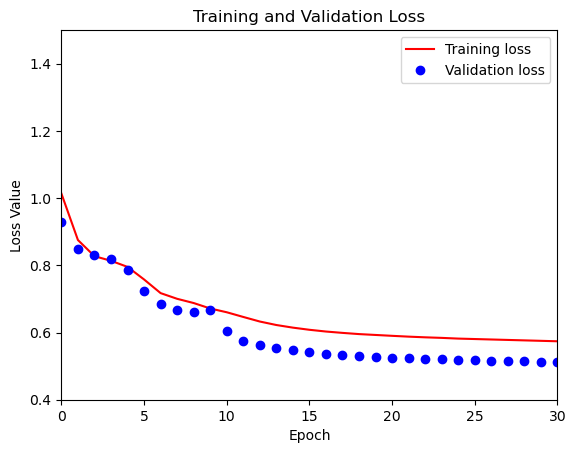

In [5]:
## Training and Validation Loss (L-curve)
import matplotlib.pyplot as plt
# produces L-curve 
loss = unet_model.history.history['loss']
val_loss = unet_model.history.history['val_loss']

plt.figure()
plt.plot( loss, 'r', label='Training loss')
plt.plot( val_loss, 'bo', label='Validation loss')
plt.title('Training and Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss Value')
plt.xlim([0, 30])
plt.ylim([0.4, 1.5])
plt.legend()
plt.show()
#plt.savefig(".png")

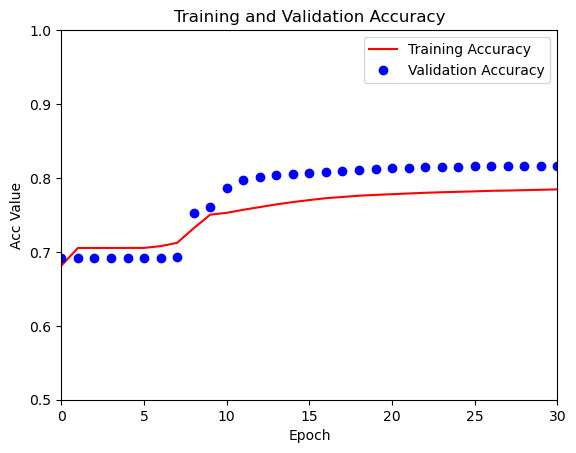

In [6]:
## Training and Validation Accuracy L-curve
acc = unet_model.history.history['sparse_categorical_accuracy']
val_acc = unet_model.history.history['val_sparse_categorical_accuracy']
# produces L-curve (monitor elbow of the L)
plt.figure()
plt.plot( acc, 'r', label='Training Accuracy')
plt.plot( val_acc, 'bo', label='Validation Accuracy')
plt.title('Training and Validation Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Acc Value')
plt.xlim([0, 30])
plt.ylim([0.5, 1])
plt.legend()
plt.show()
#plt.savefig(".png")

In [2]:
### Launch Tensorboard with the appropriate log directory (if subdirectories are not mentioned, then all runs will be displayed)
### Also mention port could be 6007, 6008 onwards. The default is 6006. In case if a tensorboard is already running, use a different port to launch a new instance ig
# %tensorboard --logdir crevasse_data --port=6006

### Plot HH-Median Training and Validation Data using Model.Predict

In [ ]:
training_prediction = unet_model.predict(train_ds.batch(batch_size=1))

In [24]:
from unet import utils
import numpy as np
fig, ax = plt.subplots(20, 3, sharex=True, sharey=True, figsize=(50,200))
dataset = train_ds.map(utils.crop_image_and_label_to_shape(training_prediction.shape[1:]))

for i, (image, label) in enumerate(dataset.take(20)):
    ax[i][0].imshow(image[..., -1],cmap=plt.cm.gray); ax[i][0].set_title('Image', fontsize='30'); ax[i][0].axis('off')
    ax[i][1].imshow(label[...],cmap=plt.cm.gray); ax[i][1].set_title('Input Label',fontsize='30'); ax[i][1].axis('off')
    ax[i][2].imshow(np.argmax(training_prediction[i,...],axis=-1),cmap=plt.cm.gray); ax[i][2].set_title('Prediction',fontsize='30'); ax[i][2].axis('off')
plt.tight_layout()

4/4 [==============================] - 0s 41ms/step


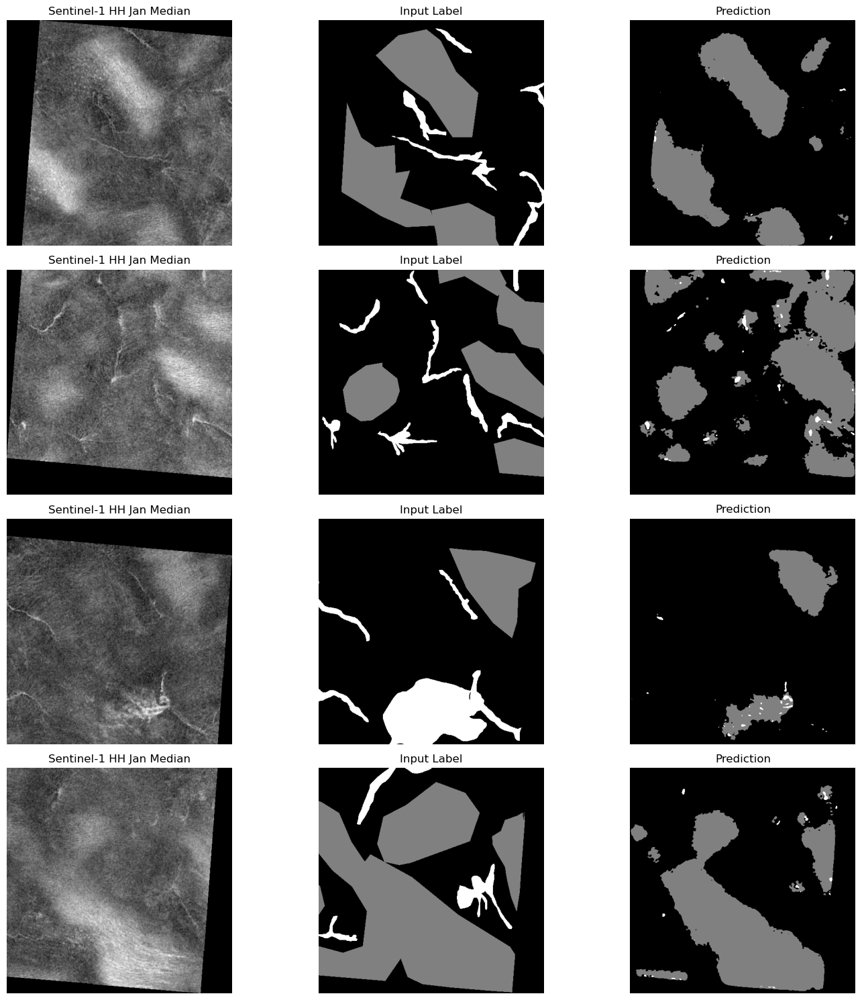

In [9]:
validation_prediction = unet_model.predict(valid_ds.batch(batch_size=1))
from unet import utils
import numpy as np
fig, ax = plt.subplots(4, 3, sharex=True, sharey=True, figsize=(15,15))
dataset = valid_ds.map(utils.crop_image_and_label_to_shape(validation_prediction.shape[1:]))

for i, (image, label) in enumerate(dataset.take(4)):
    ax[i][0].imshow(image[..., -1],cmap=plt.cm.gray); ax[i][0].set_title('Sentinel-1 HH Jan Median'); ax[i][0].axis('off')
    ax[i][1].imshow(label[...],cmap=plt.cm.gray); ax[i][1].set_title('Input Label'); ax[i][1].axis('off')
    ax[i][2].imshow(np.argmax(validation_prediction[i,...],axis=-1),cmap=plt.cm.gray); ax[i][2].set_title('Prediction'); ax[i][2].axis('off')
plt.tight_layout()

## Test Model Prediction on HH-single, HV-single, HV-median Sentinel-1 Images

In [25]:
# Load HH single images as TF dataset
HH_single_image_dataset = tf.data.Dataset.list_files("./gris/Images_HH_single/Valid/*.png", shuffle=False)
HH_single_image_dataset = HH_single_image_dataset.map(read_image, num_parallel_calls=tf.data.AUTOTUNE)

# Load HV single images as TF dataset
HV_single_image_dataset = tf.data.Dataset.list_files("./gris/Images_HV_single/Valid/*.png", shuffle=False)
HV_single_image_dataset = HV_single_image_dataset.map(read_image, num_parallel_calls=tf.data.AUTOTUNE)

# Load HV Median images as TF dataset
HV_med_image_dataset = tf.data.Dataset.list_files("./gris/Images_HV_median/Valid/*.png", shuffle=False)
HV_med_image_dataset = HV_med_image_dataset.map(read_image, num_parallel_calls=tf.data.AUTOTUNE)

# Load validation Labels (same labels for all modes)
test_label_dataset = tf.data.Dataset.list_files("./gris/Labels_512/Valid/*.png", shuffle=False)
test_label_dataset = test_label_dataset.map(read_mask, num_parallel_calls=tf.data.AUTOTUNE)

# Zip labels with individual mode image datasets
HH_single_ds = tf.data.Dataset.zip((HH_single_image_dataset,test_label_dataset))
HV_single_ds = tf.data.Dataset.zip((HV_single_image_dataset,test_label_dataset))
HV_med_ds = tf.data.Dataset.zip((HV_med_image_dataset,test_label_dataset))

### HH-single Prediction and Evaluation Metrics

In [26]:
HH_single_prediction = unet_model.predict(HH_single_ds.batch(batch_size=1))
HH_single_evaluation = unet_model.evaluate(HH_single_ds.batch(batch_size=1))

4/4 [==============================] - 0s 70ms/step - loss: 1.0239 - sparse_categorical_accuracy: 0.4148 - sparse_categorical_crossentropy: 1.0239 - io_u_1: 0.7364 - mean_iou: 0.3017 - dice_coefficient: 0.6095


### HV-single Prediction and Evaluation Metrics

In [27]:
HV_single_prediction = unet_model.predict(HV_single_ds.batch(batch_size=1))
HV_single_evaluation = unet_model.evaluate(HV_single_ds.batch(batch_size=1))

4/4 [==============================] - 0s 66ms/step - loss: 1.2011 - sparse_categorical_accuracy: 0.4042 - sparse_categorical_crossentropy: 1.2011 - io_u_1: 0.7364 - mean_iou: 0.3000 - dice_coefficient: 0.6088


### HV-median Prediction and Evaluation Metrics

In [28]:
HV_med_prediction = unet_model.predict(HV_med_ds.batch(batch_size=1))
HV_med_evaluation = unet_model.evaluate(HV_med_ds.batch(batch_size=1))

4/4 [==============================] - 0s 68ms/step - loss: 0.6656 - sparse_categorical_accuracy: 0.6919 - sparse_categorical_crossentropy: 0.6656 - io_u_1: 0.7364 - mean_iou: 0.3043 - dice_coefficient: 0.6093


### Prediction Plot for HH-single images

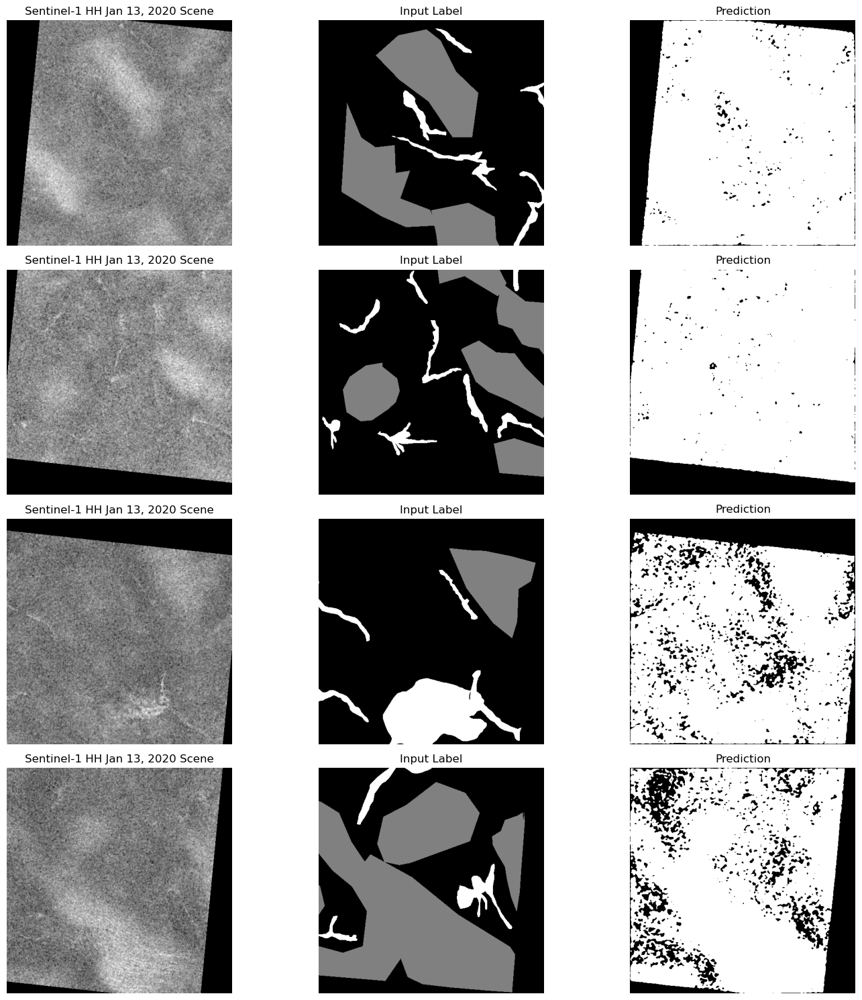

In [43]:
from unet import utils
import numpy as np
fig, ax = plt.subplots(4, 3, sharex=True, sharey=True, figsize=(15,15))
dataset = HH_single_ds.map(utils.crop_image_and_label_to_shape(HH_single_prediction.shape[1:]))

for i, (image, label) in enumerate(dataset.take(4)):
    ax[i][0].imshow(image[..., -1],cmap=plt.cm.gray); ax[i][0].set_title('Sentinel-1 HH Jan 13, 2020 Scene'); ax[i][0].axis('off')
    ax[i][1].imshow(label[...],cmap=plt.cm.gray); ax[i][1].set_title('Input Label'); ax[i][1].axis('off')
    ax[i][2].imshow(np.argmax(HH_single_prediction[i,...],axis=-1),cmap=plt.cm.gray); ax[i][2].set_title('Prediction'); ax[i][2].axis('off')
plt.tight_layout()

### Prediction Plot for HV-single images

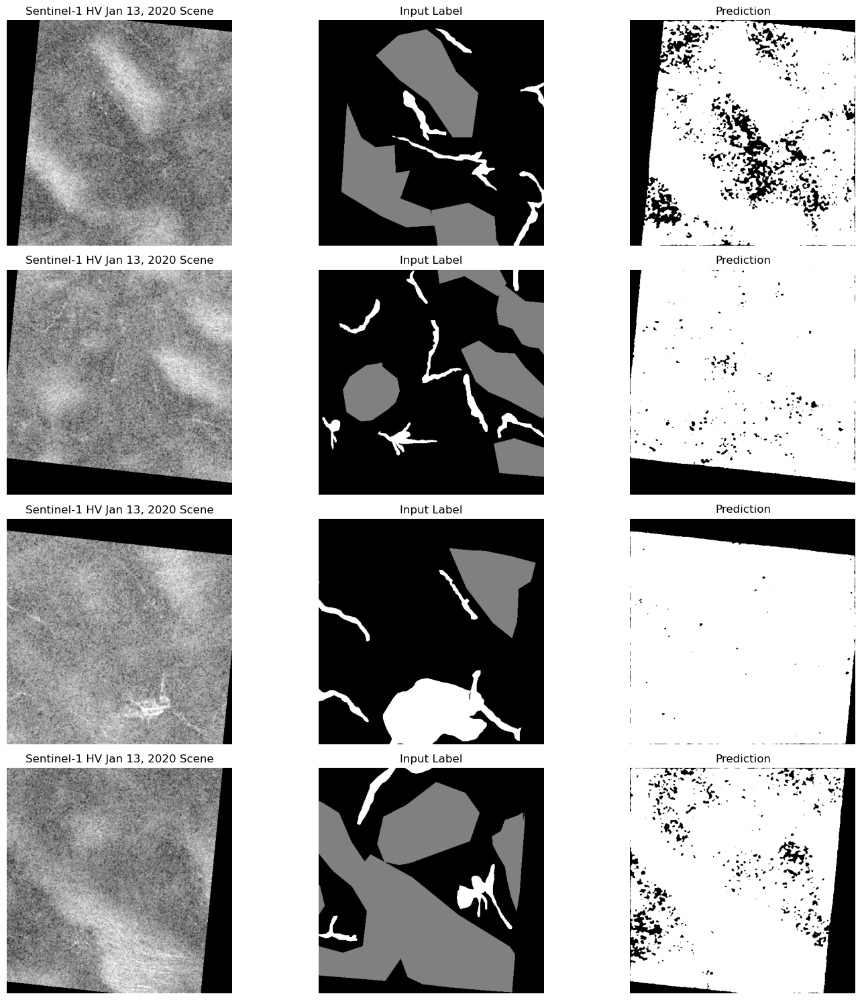

In [44]:
from unet import utils
import numpy as np
fig, ax = plt.subplots(4, 3, sharex=True, sharey=True, figsize=(15,15))
dataset = HV_single_ds.map(utils.crop_image_and_label_to_shape(HV_single_prediction.shape[1:]))

for i, (image, label) in enumerate(dataset.take(4)):
    ax[i][0].imshow(image[..., -1],cmap=plt.cm.gray); ax[i][0].set_title('Sentinel-1 HV Jan 13, 2020 Scene'); ax[i][0].axis('off')
    ax[i][1].imshow(label[...],cmap=plt.cm.gray); ax[i][1].set_title('Input Label'); ax[i][1].axis('off')
    ax[i][2].imshow(np.argmax(HV_single_prediction[i,...],axis=-1),cmap=plt.cm.gray); ax[i][2].set_title('Prediction'); ax[i][2].axis('off')
plt.tight_layout()

### Prediction Plot for HV-median images

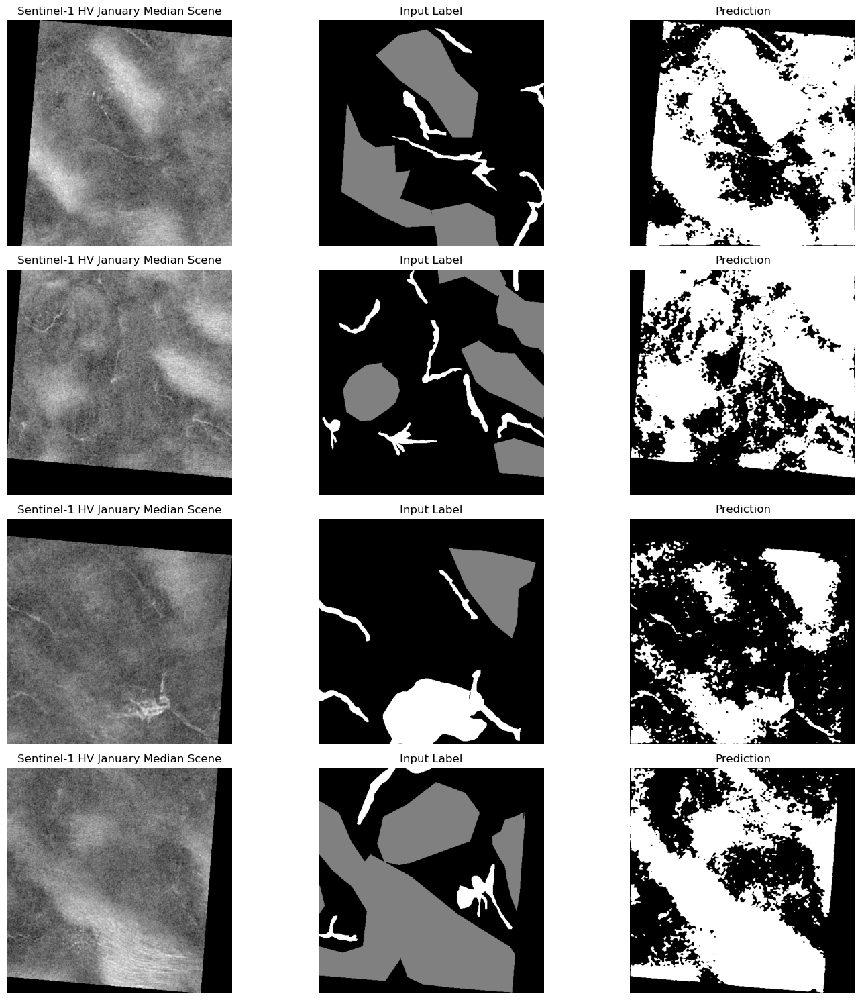

In [45]:
from unet import utils
import numpy as np
fig, ax = plt.subplots(4, 3, sharex=True, sharey=True, figsize=(15,15))
dataset = HV_med_ds.map(utils.crop_image_and_label_to_shape(HV_med_prediction.shape[1:]))

for i, (image, label) in enumerate(dataset.take(4)):
    ax[i][0].imshow(image[..., -1],cmap=plt.cm.gray); ax[i][0].set_title('Sentinel-1 HV January Median Scene'); ax[i][0].axis('off')
    ax[i][1].imshow(label[...],cmap=plt.cm.gray); ax[i][1].set_title('Input Label'); ax[i][1].axis('off')
    ax[i][2].imshow(np.argmax(HV_med_prediction[i,...],axis=-1),cmap=plt.cm.gray); ax[i][2].set_title('Prediction'); ax[i][2].axis('off')
plt.tight_layout()